In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import copy

import math
import torch
from torch.nn.modules.transformer import TransformerEncoder, TransformerEncoderLayer
from torch.nn.modules import LayerNorm, Linear, ReLU
import torch.nn as nn
import torch.nn.functional as F
import sklearn.metrics
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import pickle
from torch.utils.data import DataLoader

from torch.utils.data import DataLoader
import torch.nn.functional as F
import numpy as np
import torch
from sklearn.metrics import pairwise_distances
from sklearn.neighbors import NearestNeighbors


device = 'cuda' if torch.cuda.is_available() else 'cpu'


# Data Loader

In [2]:
X = np.load('/kaggle/input/active-learning-subset/tar_image_subset.npy') 
y = np.load('/kaggle/input/active-learning-subset/label_target_subset.npy')


test_size = 20/100
X_pool, X_val, y_pool, y_val = train_test_split(X, y, test_size=test_size, stratify=y, random_state=42)

print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")
print(f"X_val shape: {X_val.shape}")
print(f"y_val  shape: {y_val .shape}")


X shape: (20000, 6, 28)
y shape: (20000,)
X_val shape: (4000, 6, 28)
y_val  shape: (4000,)


In [3]:
y_sample = y
X_sample = X

# Label distribution
label_counts = Counter(y_sample)
df_labels = pd.DataFrame.from_dict(label_counts, orient='index').sort_index()
df_labels.columns = ['count']
df_labels['percent'] = 100 * df_labels['count'] / len(y_sample)
print("\nLabel distribution:")
print(df_labels)

channel_variance = np.var(X_sample, axis=2).mean(axis=0)
channel_mean = X_sample.mean(axis=(0, 2))
channel_std = X_sample.std(axis=(0, 2))
df_stats = pd.DataFrame({
    'channel': range(6),
    'mean': channel_mean,
    'std_dev': channel_std,
    'variance': channel_variance
})
print("\nMean, Std Dev and Variance per Channel:")
print(df_stats)


Label distribution:
   count  percent
0   9081   45.405
1   2603   13.015
2   8316   41.580

Mean, Std Dev and Variance per Channel:
   channel      mean   std_dev  variance
0        0  0.004546  0.999189  0.730689
1        1  0.004955  0.999538  0.721030
2        2  0.003958  1.000457  0.755685
3        3  0.001807  1.000751  0.783507
4        4  0.001153  1.000271  0.634434
5        5  0.001723  1.000909  0.731176


In [4]:
# Total number of samples
total_samples = sum(label_counts.values())

# Number of classes
num_classes = max(label_counts.keys()) + 1  # assuming labels start from 0

# Compute weight for each class as inverse frequency
class_weights = []
for i in range(num_classes):
    count = label_counts.get(i, 0)
    if count == 0:
        class_weights.append(0.0)  # or very small value like 1e-6
    else:
        class_weights.append(total_samples / (num_classes * count))

# Convert to torch tensor for CE loss
class_weights = torch.tensor(class_weights, dtype=torch.float32).to(device)


In [ ]:
i = np.random.randint(0, len(X))
sample = X[i]  # Shape: (6, T)

plt.figure(figsize=(12, 6))
for c in range(6):
    plt.plot(sample[c], label=f'Channel {c}')
plt.title(f"Sample {i} (Label: {y[i]}) - Time Series per Channel")
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend()
plt.grid(True)
plt.show()

# Dataloader

In [ ]:
class Dataset():
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __getitem__(self, index):
        return {
            "x": self.X[index],  # shape: [C, T]
            "y": self.y[index]
        }

    def __len__(self):
        return len(self.X)

# Model

In [ ]:
################ CNN Backbone 
def conv_block(in_channels: int, out_channels: int, dropout=0.3) -> nn.Module:
    return nn.Sequential(
        nn.Conv1d(in_channels, out_channels, 5, padding='same'),
        nn.BatchNorm1d(out_channels),
        nn.ReLU(),
        nn.Dropout(dropout),
    )

class cnn(nn.Module):
    def __init__(self):
        super(cnn, self).__init__()
        self.conv1 = conv_block(6, 64)
        self.conv2 = conv_block(64, 128)
        self.conv3 = conv_block(128, 256)
        self.conv4 = conv_block(256, 512)
        self.conv5 = conv_block(512, 1024)
        self.global_pool = nn.AdaptiveAvgPool1d(1)

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.global_pool(x)
        x = x.view(x.size(0), -1)
        return x

 
################ Fully connected network
class FC(nn.Module):
    def __init__(self, input_dim):
        super(FC, self).__init__()
        self.dropout = nn.Dropout(0.5)
        self.fco = nn.Linear(input_dim, 3)

    def forward(self, x):
        x = self.dropout(x)
        x = self.fco(x)
        return x



class FullModel(nn.Module):
    def __init__(self, backbone, fc):
        super().__init__()
        self.backbone = backbone
        self.fc = fc

    def forward(self, x):
        feat = self.backbone(x)
        out = self.fc(feat)
        return feat, out

# Loading weights

In [ ]:
#pretrained weights
map_location=torch.device(device)

backbone = cnn()
fc = FC(1024)

#loading backbone weights
state_dict = torch.load('/kaggle/input/active-learning-subset/backboneSiteA2019.pth', map_location=map_location)
# Remove "module." prefix
new_state_dict = {}
for k, v in state_dict.items():
    new_key = k.replace("module.", "")  # remove module. prefix
    new_state_dict[new_key] = v

backbone.load_state_dict(new_state_dict)

#loading fc weights
state_dict = torch.load('/kaggle/input/active-learning-subset/fcSiteA2019.pth', map_location=map_location)
# Remove "module." prefix
new_state_dict = {}
for k, v in state_dict.items():
    new_key = k.replace("module.", "")  # remove module. prefix
    new_state_dict[new_key] = v

fc.load_state_dict(new_state_dict)

model = FullModel(backbone, fc).to(device)
initial_state_dict = copy.deepcopy(model.state_dict())

# Train/eval loop

In [ ]:
def train_one_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    total_loss, all_preds, all_targets = 0, [], []

    for batch in dataloader:
        x, y = batch["x"].to(device), batch["y"].to(device)

        optimizer.zero_grad()
        _, out = model(x)
        loss = criterion(out, y)
        loss.backward()
        optimizer.step()

        total_loss += loss.item() * len(x)
        preds = torch.argmax(out, dim=1)
        all_preds.extend(preds.cpu().numpy())
        all_targets.extend(y.cpu().numpy())

    avg_loss = total_loss / len(dataloader.dataset)
    acc = np.mean(np.array(all_preds) == np.array(all_targets))
    f1s = sklearn.metrics.f1_score(all_targets, all_preds, average=None)
    return avg_loss, acc, f1s, np.mean(f1s)



def _eval_perf(model, dataloader, device, criterion=None):
    model.eval()
    pred, gt = [], []
    total_loss = 0

    with torch.no_grad():
        for batch in dataloader:
            x, y = batch["x"].to(device), batch["y"].to(device)
            _, outputs = model(x)
            preds = torch.argmax(outputs, dim=1)
            if criterion:
                total_loss += criterion(outputs, y).item() * len(x)

            pred.extend(preds.cpu().numpy())
            gt.extend(y.cpu().numpy())

    acc = np.mean(np.array(pred) == np.array(gt))
    f1s = sklearn.metrics.f1_score(gt, pred, average=None)
    avg_f1 = np.mean(f1s)

    if criterion:
        avg_loss = total_loss / len(dataloader.dataset)
        return avg_loss, f1s, acc, avg_f1
    else:
        return 0, f1s, acc, avg_f1



class LabelSmoothingCrossEntropy(nn.Module):
    def __init__(self, weight=None, smoothing=0.1):
        super().__init__()
        self.weight = weight
        self.smoothing = smoothing
        self.confidence = 1.0 - smoothing

    def forward(self, pred, target):
        log_probs = F.log_softmax(pred, dim=-1)
        nll_loss = -log_probs.gather(dim=-1, index=target.unsqueeze(1)).squeeze(1)
        smooth_loss = -log_probs.mean(dim=-1)
        loss = self.confidence * nll_loss + self.smoothing * smooth_loss
        if self.weight is not None:
            loss = loss * self.weight[target]
        return loss.mean()

# Active Learning methods

In [ ]:
def plot_round_metrics(history):
    round_id = len(history["epoch_metrics"]) - 1
    epoch_stats = history["epoch_metrics"][round_id]
    epochs = list(range(1, len(epoch_stats) + 1))

    train_loss = [e["train_loss"] for e in epoch_stats]
    val_loss = [e["val_loss"] for e in epoch_stats]
    train_acc = [e["train_acc"] for e in epoch_stats]
    train_f1 = [e["train_avg_f1"] for e in epoch_stats]
    val_acc = [e["val_acc"] for e in epoch_stats]
    val_f1 = [e["val_avg_f1"] for e in epoch_stats]

    plt.figure(figsize=(15, 4))

    # Loss plot
    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_loss, label="Train Loss")
    plt.plot(epochs, val_loss, label="Val Loss")
    plt.title(f"[Round {round_id+1}] Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    # Accuracy plot
    plt.subplot(1, 3, 2)
    plt.plot(epochs, train_acc, label="Train Acc")
    plt.plot(epochs, val_acc, label="Val Acc")
    plt.title(f"[Round {round_id+1}] Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()

    # Avg F1 plot
    plt.subplot(1, 3, 3)
    plt.plot(epochs, train_f1, label="Train F1")
    plt.plot(epochs, val_f1, label="Val F1")
    plt.title(f"[Round {round_id+1}] Avg F1")
    plt.xlabel("Epoch")
    plt.ylabel("Avg F1")
    plt.legend()

    plt.tight_layout()
    plt.show()



def plot_final_performance(history):
    samples = history["samples"]
    val_acc = history["round_val_acc"]
    val_f1 = history["round_val_avg_f1"]

    plt.figure(figsize=(10, 4))

    plt.subplot(1, 2, 1)
    plt.plot(samples, val_acc, marker='o')
    plt.title("Val Accuracy vs Labeled Samples")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Accuracy")

    plt.subplot(1, 2, 2)
    plt.plot(samples, val_f1, marker='o')
    plt.title("Val Avg F1 vs Labeled Samples")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Avg F1")

    plt.tight_layout()
    plt.show()


In [11]:
def query_samples(model, dataset, query_size, strategy, device, already_selected_idx=None):
    model.eval()
    dataloader = DataLoader(dataset, batch_size=128)
    all_scores = []
    all_features = []
    if already_selected_idx is None:
        already_selected_idx = []

    with torch.no_grad():
        for batch in dataloader:
            x = batch["x"].to(device)
            features, out = model(x)
            probs = F.softmax(out, dim=1)

            if strategy in ["entropy", "least_confident", "margin", "random", "entropy_diversity"]:
                score = None
                if strategy in ["entropy", "entropy_diversity"]:
                    score = -torch.sum(probs * torch.log(probs + 1e-10), dim=1)
                elif strategy == "least_confident":
                    score = 1 - probs.max(dim=1)[0]
                elif strategy == "margin":
                    sorted_probs, _ = probs.sort(dim=1, descending=True)
                    score = -(sorted_probs[:, 0] - sorted_probs[:, 1])
                elif strategy == "random":
                    score = torch.rand(len(x), device=device)

                all_scores.extend(score.cpu().numpy())

            if strategy in ["diversity", "density", "entropy_diversity"]:
                all_features.append(features.cpu().numpy())

    if strategy in ["entropy", "least_confident", "margin", "random"]:
        indices = np.argsort(all_scores)[-query_size:]
        return indices

    all_features = np.concatenate(all_features, axis=0)

    if strategy == "diversity":
        # Core-set (k-Center Greedy)
        if already_selected_idx is None or len(already_selected_idx) == 0:
            selected = [np.random.randint(len(all_features))]
        else:
            selected = already_selected_idx.copy()

        selected_features = all_features[selected]
        remaining = list(set(range(len(all_features))) - set(selected))

        for _ in range(query_size):
            dists = pairwise_distances(all_features[remaining], selected_features, metric="euclidean")
            min_dists = np.min(dists, axis=1)
            next_idx = remaining[np.argmax(min_dists)]
            selected.append(next_idx)
            selected_features = np.vstack([selected_features, all_features[next_idx].reshape(1, -1)])
            remaining.remove(next_idx)

        new_indices = list(set(selected) - set(already_selected_idx))[-query_size:]
        return np.array(new_indices)

    elif strategy == "density":
        if all_features.shape[1] > 64:
            from sklearn.decomposition import PCA
            pca = PCA(n_components=64)
            all_features = pca.fit_transform(all_features)

        all_features = all_features.astype(np.float32)
        nbrs = NearestNeighbors(n_neighbors=6, algorithm='auto', metric='euclidean').fit(all_features)
        distances, _ = nbrs.kneighbors(all_features)
        avg_neighbor_dist = distances[:, 1:].mean(axis=1)
        density_scores = -avg_neighbor_dist
        indices = np.argsort(density_scores)[-query_size:]
        return indices

    elif strategy == "entropy_diversity":
        # Hybrid: Select top-2×query_size most uncertain samples, then apply core-set
        all_scores = np.array(all_scores)
        all_features = np.array(all_features)

        top_uncertain_idx = np.argsort(all_scores)[-2 * query_size:]
        uncertain_features = all_features[top_uncertain_idx]

        # Core-set on uncertain samples
        selected = [np.random.randint(len(uncertain_features))]
        selected_features = uncertain_features[selected]
        remaining = list(set(range(len(uncertain_features))) - set(selected))

        for _ in range(query_size - 1):
            dists = pairwise_distances(uncertain_features[remaining], selected_features, metric="euclidean")
            min_dists = np.min(dists, axis=1)
            next_idx = remaining[np.argmax(min_dists)]
            selected.append(next_idx)
            selected_features = np.vstack([selected_features, uncertain_features[next_idx].reshape(1, -1)])
            remaining.remove(next_idx)

        final_indices = top_uncertain_idx[selected]
        return np.array(final_indices)


# Active Learning Loop

In [12]:
def active_learning_loop(model, labeled_dataset, unlabeled_dataset, val_dataset, strategy, device, iters=10, query_size=100, final_epochs=5):
    
    criterion = LabelSmoothingCrossEntropy(weight=class_weights, smoothing=0.1)
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)

    
    history = {
        "strategy": strategy,
        "samples": [],
        "epoch_metrics": [],
        "round_val_acc": [],
        "round_val_avg_f1": []
    }

    for it in range(iters):
        print(f"\n[AL Round {it+1}/{iters}] — Labeled samples: {len(labeled_dataset)}")

        train_loader = DataLoader(labeled_dataset, batch_size=64, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=64)

        epoch_stats = []

        if it <= 3:
            epochs = 5
        elif 4 <= it <= 10:
            epochs = 10
        elif 11 <= it:
            epochs = final_epochs
        else:
            epochs = final_epochs
        
        for ep in tqdm(range(epochs), desc="Epoch", leave=False):
            tr_loss, tr_acc, tr_f1s, tr_avgf1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_f1s, val_acc, val_avgf1 = _eval_perf(model, val_loader, device, criterion)

            epoch_stats.append({
                "train_loss": tr_loss,
                "train_acc": tr_acc,
                "train_avg_f1": tr_avgf1,
                "val_loss": val_loss,
                "val_acc": val_acc,
                "val_avg_f1": val_avgf1
            })

        history["samples"].append(len(labeled_dataset))
        history["epoch_metrics"].append(epoch_stats)
        history["round_val_acc"].append(val_acc)
        history["round_val_avg_f1"].append(val_avgf1)

        # Query next samples
        if len(unlabeled_dataset) < query_size:
            print("Unlabeled pool exhausted.")
            break

        selected_idxs = query_samples(model, unlabeled_dataset, query_size, strategy, device)

        new_x = [unlabeled_dataset.X[i] for i in selected_idxs]
        new_y = [unlabeled_dataset.y[i] for i in selected_idxs]

        labeled_dataset.X = torch.cat([labeled_dataset.X, torch.stack(new_x)], dim=0)
        labeled_dataset.y = torch.cat([labeled_dataset.y, torch.tensor(new_y)], dim=0)

        keep_idxs = list(set(range(len(unlabeled_dataset))) - set(selected_idxs))
        unlabeled_dataset.X = torch.stack([unlabeled_dataset.X[i] for i in keep_idxs])
        unlabeled_dataset.y = torch.tensor([unlabeled_dataset.y[i] for i in keep_idxs])

        print(f"\nEpoch {epochs}/{epochs}")
        print(f"Train — Loss: {tr_loss:.4f} | Acc: {tr_acc:.4f} | Avg F1: {tr_avgf1:.4f}")
        print(f"Val   — Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | Avg F1: {val_avgf1:.4f}")

        
        plot_round_metrics(history)

    plot_final_performance(history)
    return history


X_labeled shape: (100, 6, 28)
y_labeled shape: (100,)
X_unlabeled shape: (15900, 6, 28)
y_unlabeled shape: (15900,)

=== Running strategy: DIVERSITY ===

[AL Round 1/40] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.4825 | Acc: 0.3800 | Avg F1: 0.3617
Val   — Loss: 1.0787 | Acc: 0.6845 | Avg F1: 0.6688


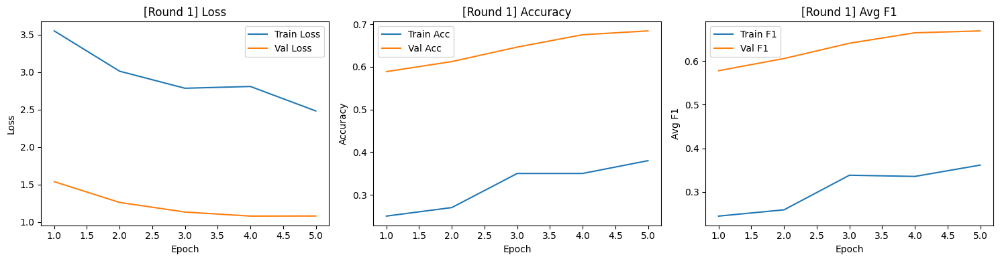


[AL Round 2/40] — Labeled samples: 105



Epoch 5/5
Train — Loss: 1.8641 | Acc: 0.5333 | Avg F1: 0.5291
Val   — Loss: 1.7192 | Acc: 0.6032 | Avg F1: 0.5799


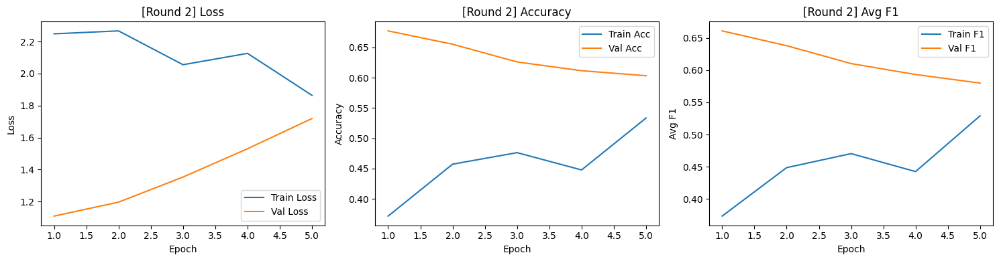


[AL Round 3/40] — Labeled samples: 110



Epoch 5/5
Train — Loss: 1.3546 | Acc: 0.6455 | Avg F1: 0.6261
Val   — Loss: 2.4699 | Acc: 0.6050 | Avg F1: 0.5683


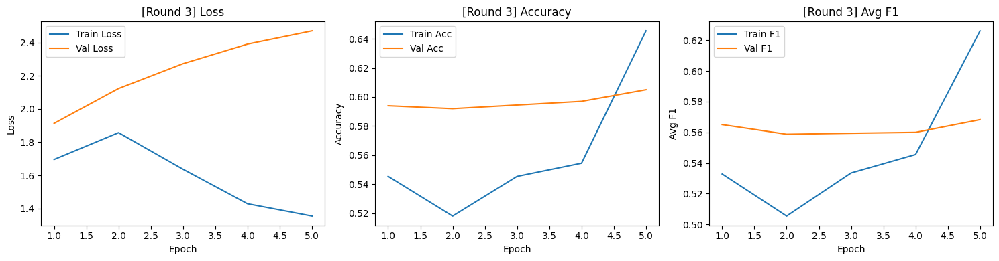


[AL Round 4/40] — Labeled samples: 115



Epoch 5/5
Train — Loss: 1.3301 | Acc: 0.6609 | Avg F1: 0.6388
Val   — Loss: 2.2641 | Acc: 0.6747 | Avg F1: 0.6529


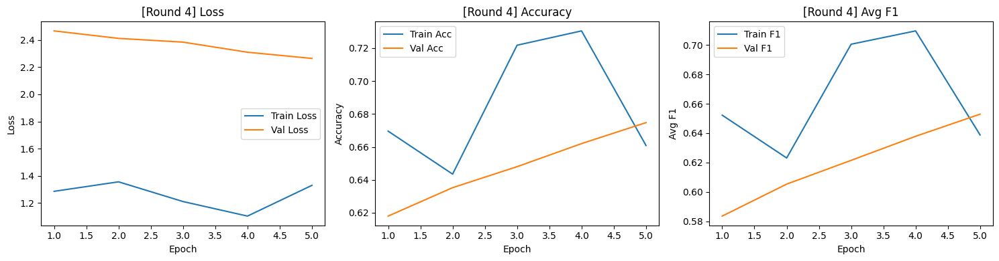


[AL Round 5/40] — Labeled samples: 120



Epoch 10/10
Train — Loss: 1.0734 | Acc: 0.6667 | Avg F1: 0.6460
Val   — Loss: 1.8039 | Acc: 0.7370 | Avg F1: 0.7202


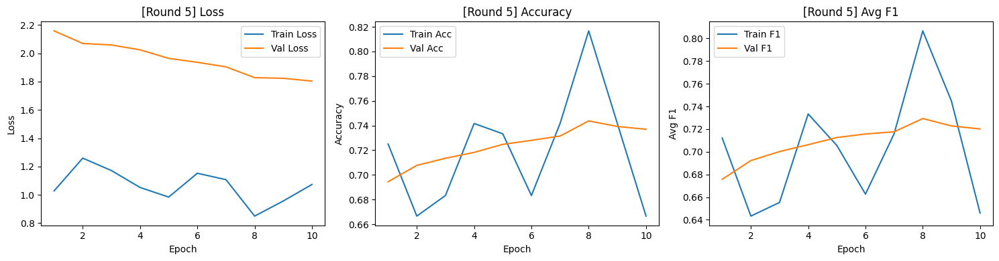


[AL Round 6/40] — Labeled samples: 125



Epoch 10/10
Train — Loss: 0.7208 | Acc: 0.8720 | Avg F1: 0.8872
Val   — Loss: 1.6766 | Acc: 0.7258 | Avg F1: 0.7117


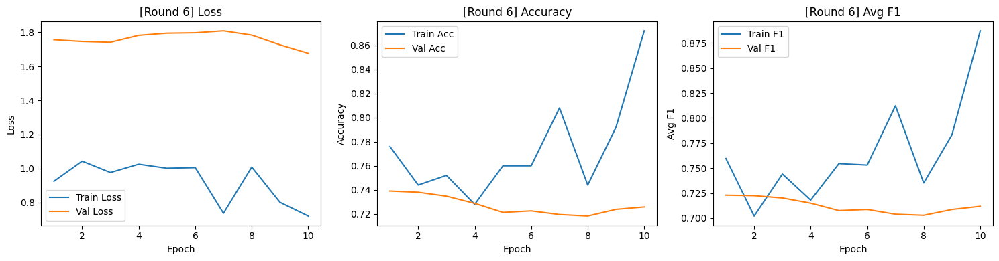


[AL Round 7/40] — Labeled samples: 130



Epoch 10/10
Train — Loss: 0.7453 | Acc: 0.8077 | Avg F1: 0.7960
Val   — Loss: 1.2799 | Acc: 0.7578 | Avg F1: 0.7457


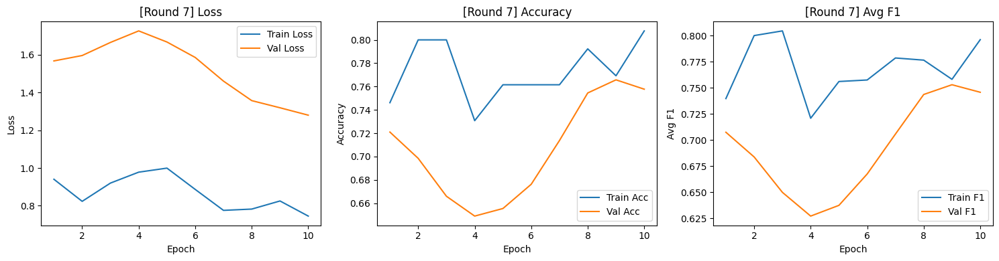


[AL Round 8/40] — Labeled samples: 135



Epoch 10/10
Train — Loss: 0.7997 | Acc: 0.8074 | Avg F1: 0.8022
Val   — Loss: 1.2128 | Acc: 0.7245 | Avg F1: 0.7212


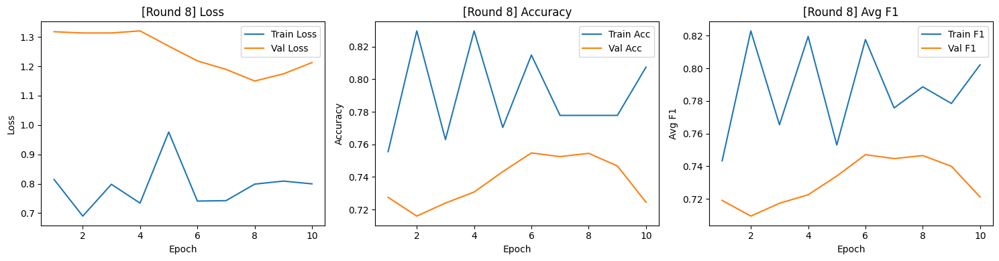


[AL Round 9/40] — Labeled samples: 140



Epoch 10/10
Train — Loss: 0.7216 | Acc: 0.8071 | Avg F1: 0.7965
Val   — Loss: 0.9998 | Acc: 0.7412 | Avg F1: 0.7406


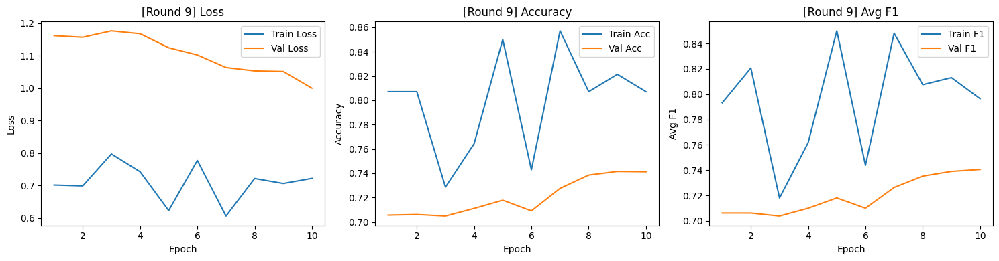


[AL Round 10/40] — Labeled samples: 145



Epoch 10/10
Train — Loss: 0.6166 | Acc: 0.8276 | Avg F1: 0.8178
Val   — Loss: 1.0637 | Acc: 0.6997 | Avg F1: 0.6995


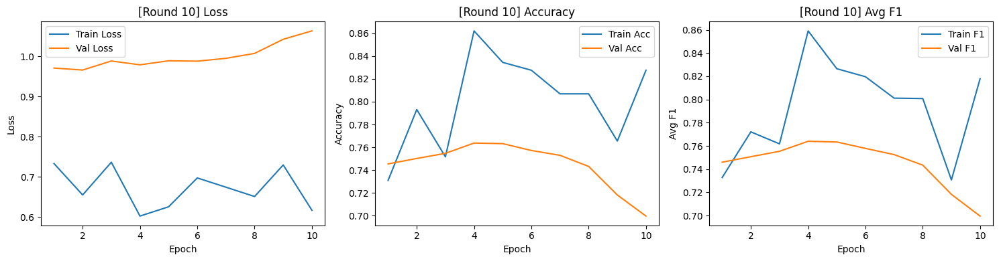


[AL Round 11/40] — Labeled samples: 150



Epoch 10/10
Train — Loss: 0.6013 | Acc: 0.8667 | Avg F1: 0.8681
Val   — Loss: 0.9358 | Acc: 0.7285 | Avg F1: 0.7352


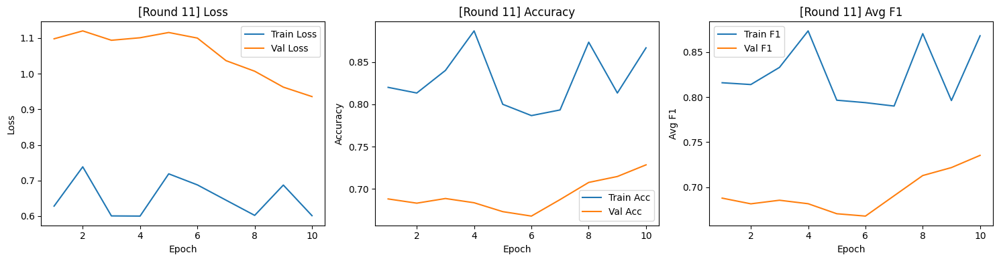


[AL Round 12/40] — Labeled samples: 155



Epoch 15/15
Train — Loss: 0.5821 | Acc: 0.8452 | Avg F1: 0.8326
Val   — Loss: 0.9671 | Acc: 0.6877 | Avg F1: 0.6985


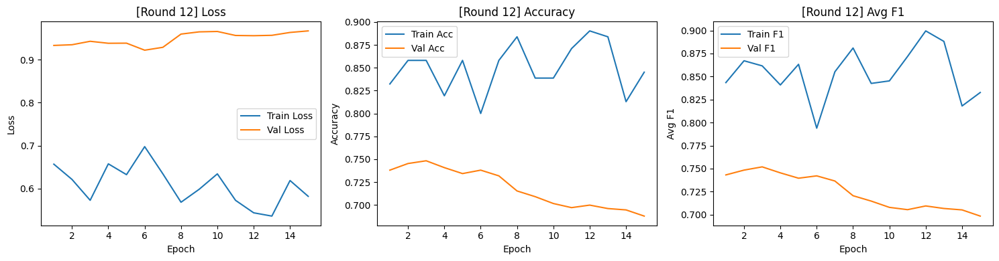


[AL Round 13/40] — Labeled samples: 160



Epoch 15/15
Train — Loss: 0.5803 | Acc: 0.7937 | Avg F1: 0.8032
Val   — Loss: 1.0137 | Acc: 0.6695 | Avg F1: 0.6777


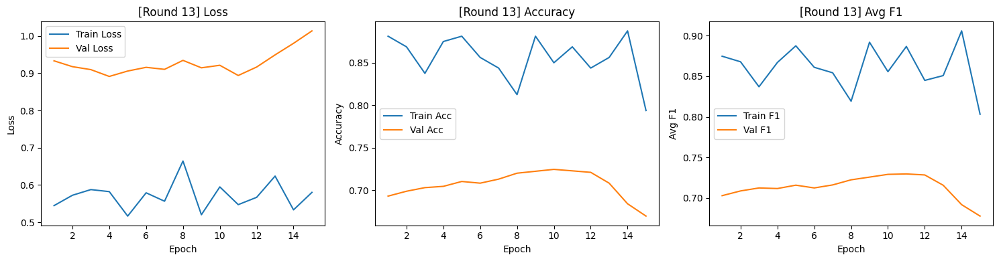


[AL Round 14/40] — Labeled samples: 165



Epoch 15/15
Train — Loss: 0.6255 | Acc: 0.8121 | Avg F1: 0.8083
Val   — Loss: 0.9491 | Acc: 0.6747 | Avg F1: 0.6813


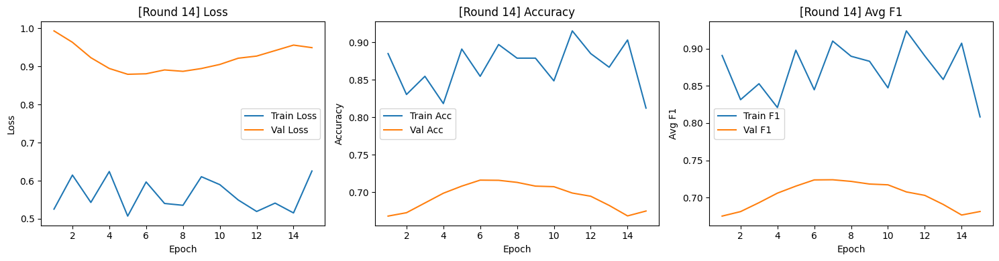


[AL Round 15/40] — Labeled samples: 170



Epoch 15/15
Train — Loss: 0.5225 | Acc: 0.9294 | Avg F1: 0.9207
Val   — Loss: 0.9124 | Acc: 0.7000 | Avg F1: 0.7064


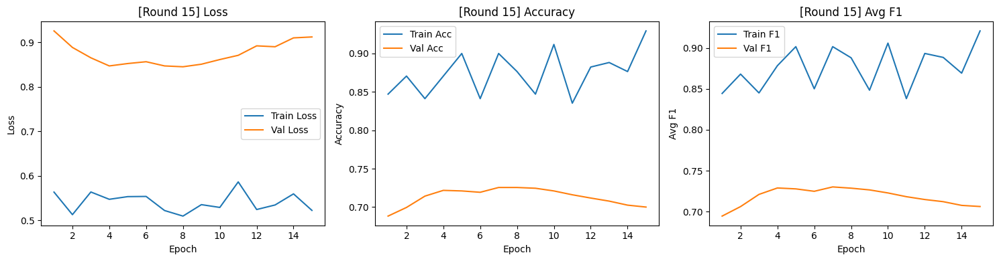


[AL Round 16/40] — Labeled samples: 175



Epoch 15/15
Train — Loss: 0.6059 | Acc: 0.8286 | Avg F1: 0.8249
Val   — Loss: 0.8676 | Acc: 0.6973 | Avg F1: 0.7016


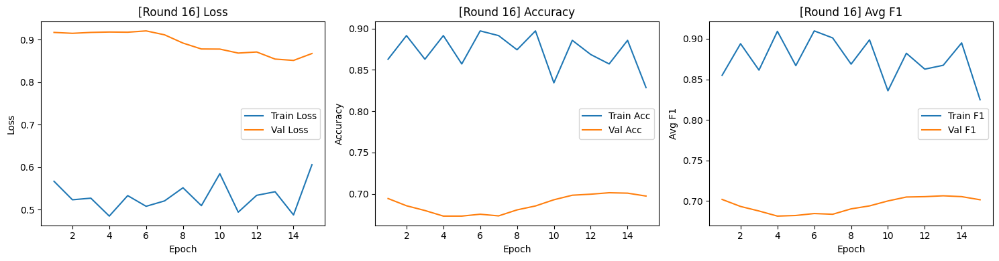


[AL Round 17/40] — Labeled samples: 180



Epoch 15/15
Train — Loss: 0.5496 | Acc: 0.9167 | Avg F1: 0.9160
Val   — Loss: 0.8745 | Acc: 0.6880 | Avg F1: 0.6976


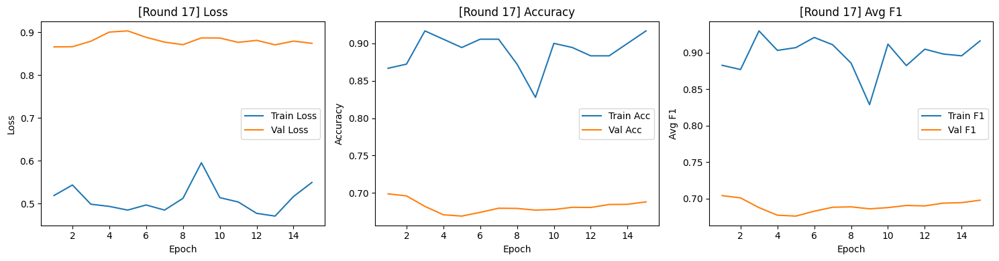


[AL Round 18/40] — Labeled samples: 185



Epoch 15/15
Train — Loss: 0.5056 | Acc: 0.8919 | Avg F1: 0.9024
Val   — Loss: 0.9085 | Acc: 0.6660 | Avg F1: 0.6743


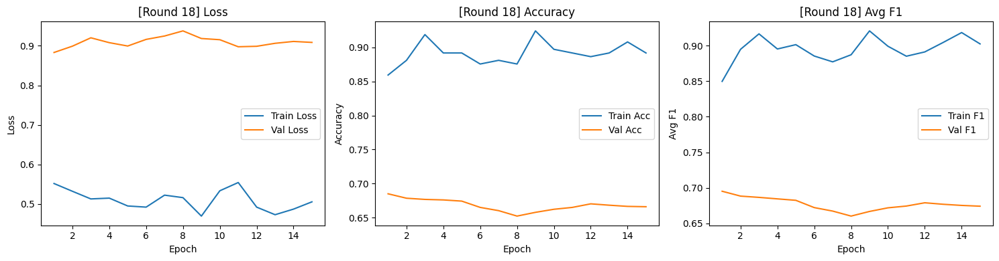


[AL Round 19/40] — Labeled samples: 190



Epoch 15/15
Train — Loss: 0.5087 | Acc: 0.8842 | Avg F1: 0.8957
Val   — Loss: 0.8398 | Acc: 0.6990 | Avg F1: 0.7058


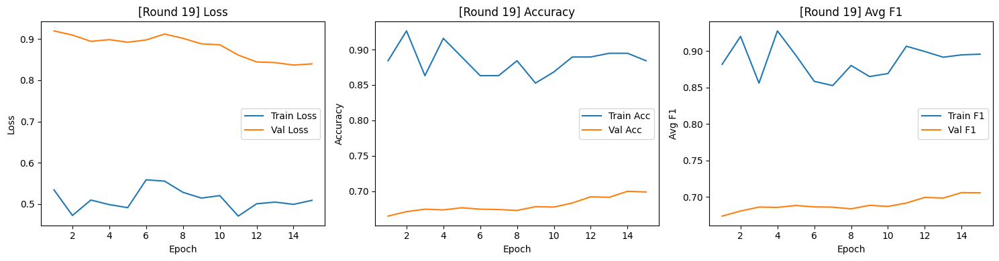


[AL Round 20/40] — Labeled samples: 195



Epoch 15/15
Train — Loss: 0.5553 | Acc: 0.8769 | Avg F1: 0.8794
Val   — Loss: 0.8906 | Acc: 0.7107 | Avg F1: 0.7068


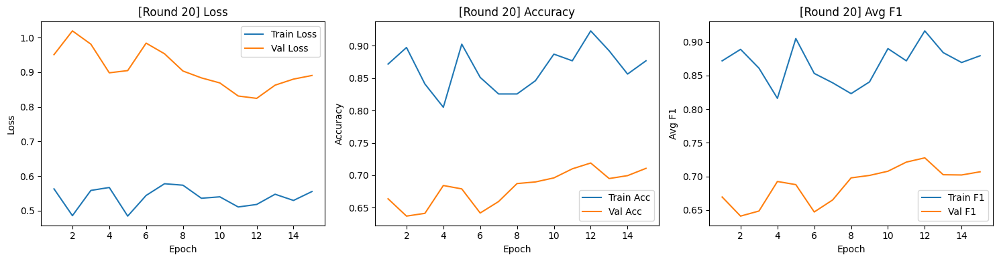


[AL Round 21/40] — Labeled samples: 200



Epoch 15/15
Train — Loss: 0.5904 | Acc: 0.8500 | Avg F1: 0.8380
Val   — Loss: 0.8610 | Acc: 0.7057 | Avg F1: 0.7202


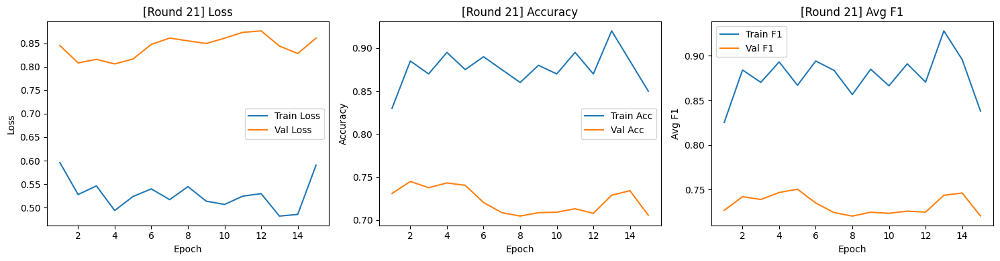


[AL Round 22/40] — Labeled samples: 205



Epoch 15/15
Train — Loss: 0.5019 | Acc: 0.8976 | Avg F1: 0.9053
Val   — Loss: 0.8545 | Acc: 0.6897 | Avg F1: 0.7104


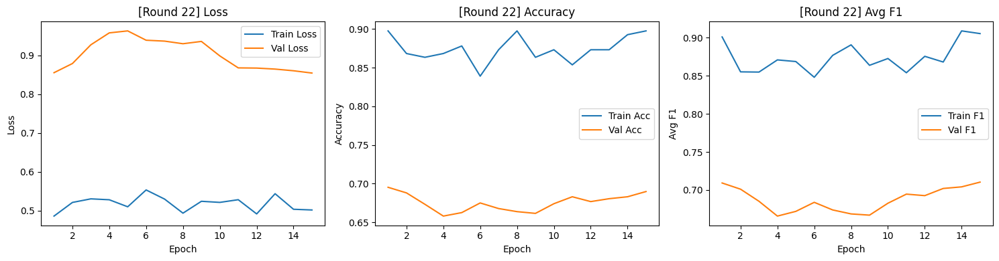


[AL Round 23/40] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.5058 | Acc: 0.8476 | Avg F1: 0.8423
Val   — Loss: 0.9008 | Acc: 0.6607 | Avg F1: 0.6719


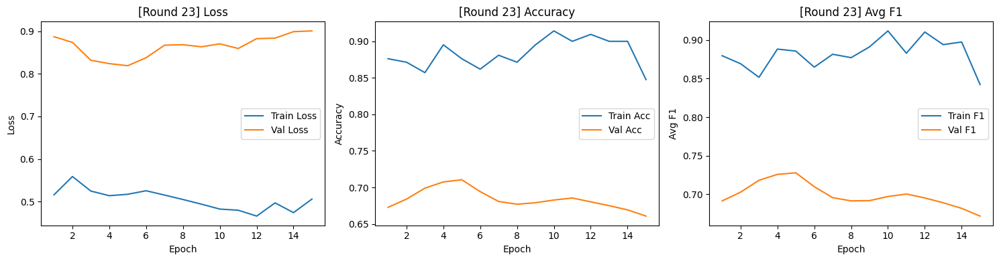


[AL Round 24/40] — Labeled samples: 215



Epoch 15/15
Train — Loss: 0.5093 | Acc: 0.8698 | Avg F1: 0.8812
Val   — Loss: 0.8602 | Acc: 0.6877 | Avg F1: 0.6997


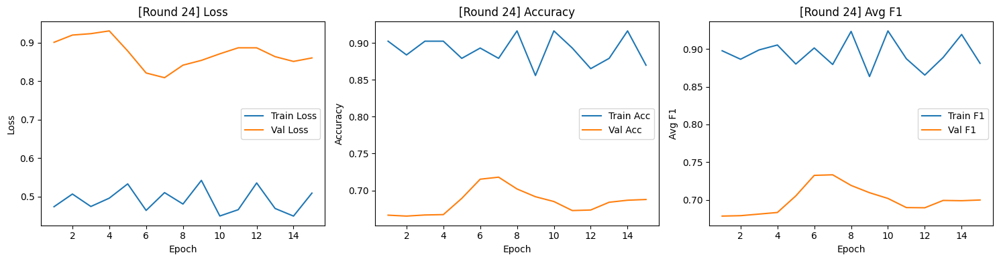


[AL Round 25/40] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.4983 | Acc: 0.8909 | Avg F1: 0.8938
Val   — Loss: 0.8738 | Acc: 0.6810 | Avg F1: 0.6923


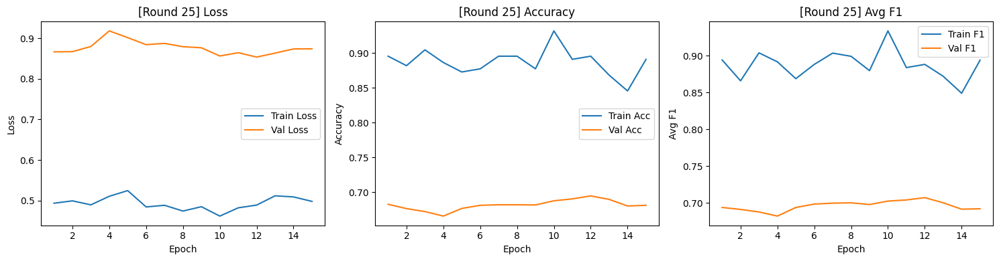


[AL Round 26/40] — Labeled samples: 225



Epoch 15/15
Train — Loss: 0.4620 | Acc: 0.9156 | Avg F1: 0.9146
Val   — Loss: 0.8943 | Acc: 0.6843 | Avg F1: 0.6988


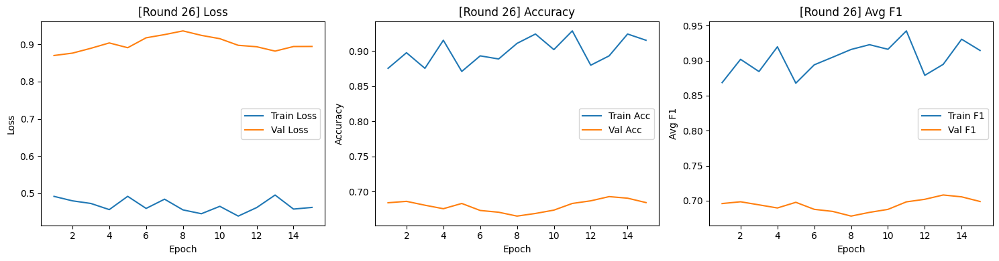


[AL Round 27/40] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.4726 | Acc: 0.9130 | Avg F1: 0.9061
Val   — Loss: 0.9826 | Acc: 0.6667 | Avg F1: 0.6826


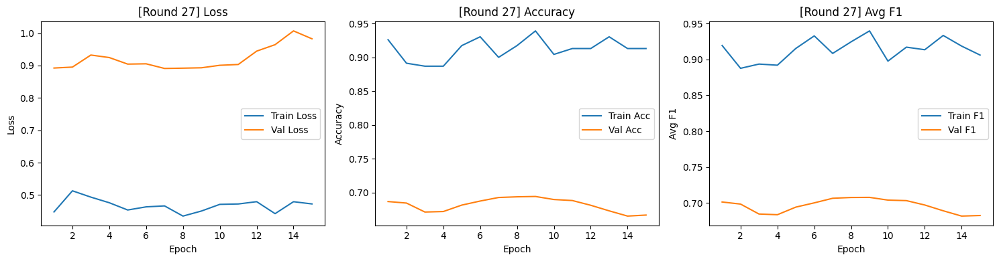


[AL Round 28/40] — Labeled samples: 235



Epoch 15/15
Train — Loss: 0.4772 | Acc: 0.8809 | Avg F1: 0.8834
Val   — Loss: 0.8593 | Acc: 0.6977 | Avg F1: 0.7123


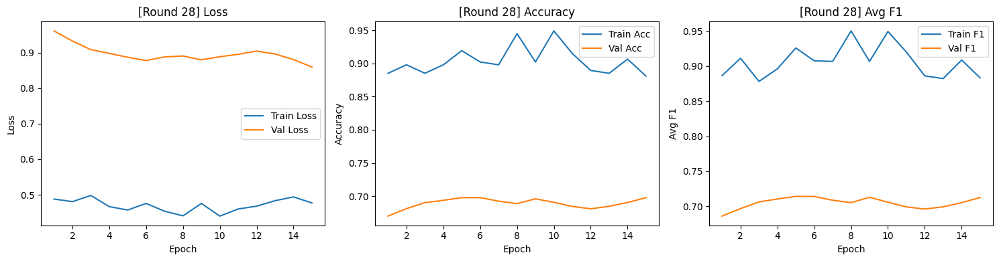


[AL Round 29/40] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.4756 | Acc: 0.9042 | Avg F1: 0.9085
Val   — Loss: 0.8592 | Acc: 0.6973 | Avg F1: 0.7133


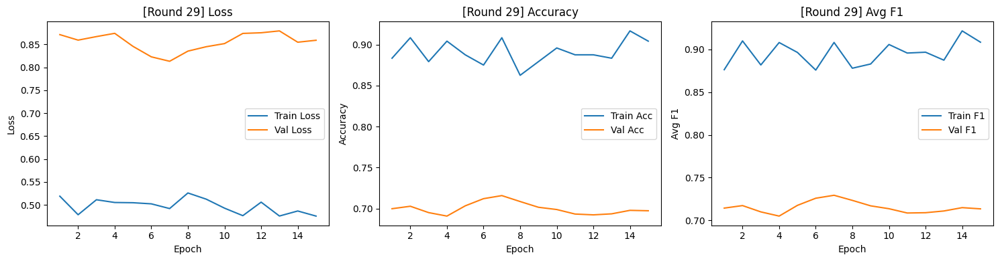


[AL Round 30/40] — Labeled samples: 245



Epoch 15/15
Train — Loss: 0.4894 | Acc: 0.8816 | Avg F1: 0.8791
Val   — Loss: 0.8490 | Acc: 0.6890 | Avg F1: 0.7000


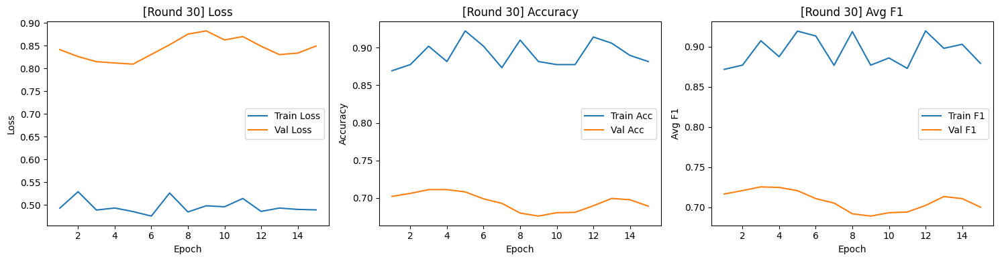


[AL Round 31/40] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.4748 | Acc: 0.9000 | Avg F1: 0.8967
Val   — Loss: 0.8016 | Acc: 0.7170 | Avg F1: 0.7243


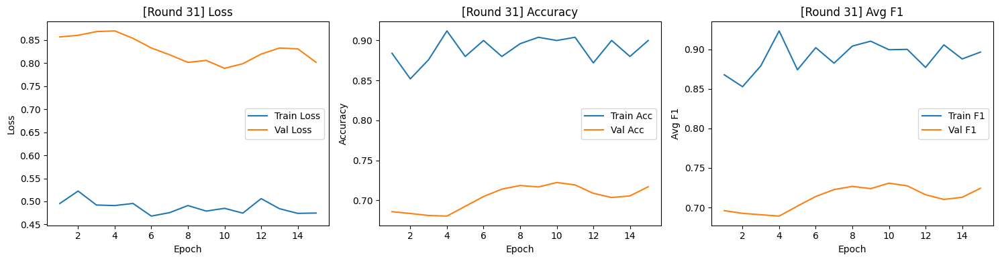


[AL Round 32/40] — Labeled samples: 255



Epoch 15/15
Train — Loss: 0.4950 | Acc: 0.8627 | Avg F1: 0.8590
Val   — Loss: 0.7841 | Acc: 0.7258 | Avg F1: 0.7314


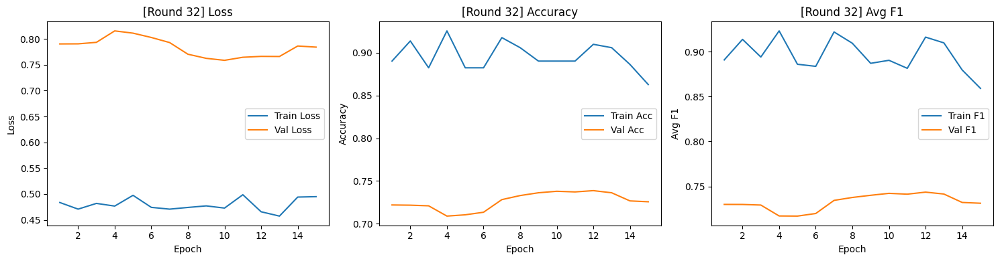


[AL Round 33/40] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.6282 | Acc: 0.8269 | Avg F1: 0.7982
Val   — Loss: 0.9303 | Acc: 0.6583 | Avg F1: 0.6460


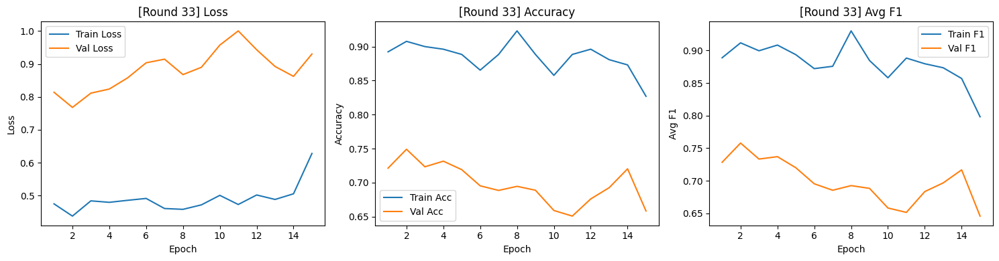


[AL Round 34/40] — Labeled samples: 265



Epoch 15/15
Train — Loss: 0.4869 | Acc: 0.9019 | Avg F1: 0.9020
Val   — Loss: 0.7652 | Acc: 0.7485 | Avg F1: 0.7566


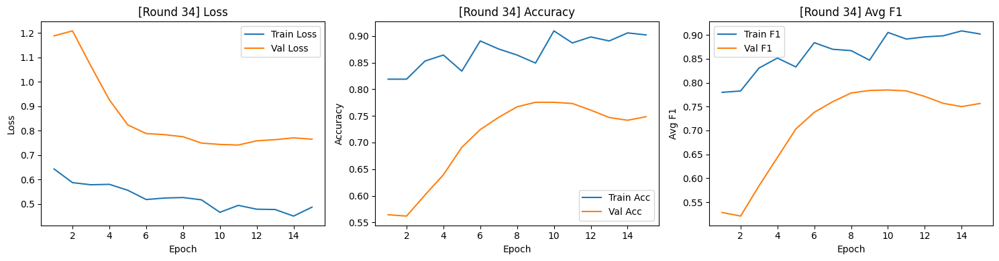


[AL Round 35/40] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.4798 | Acc: 0.8741 | Avg F1: 0.8719
Val   — Loss: 0.8140 | Acc: 0.7025 | Avg F1: 0.7123


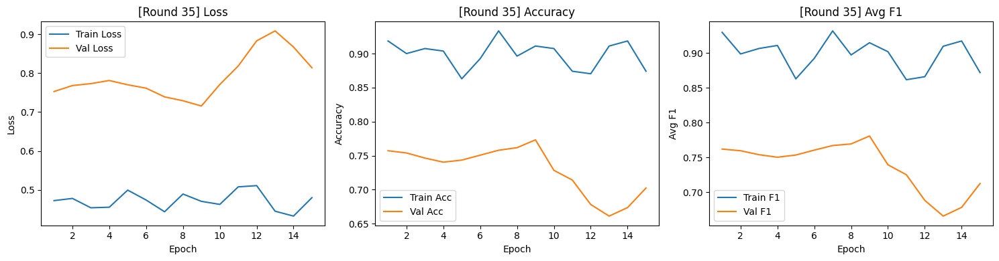


[AL Round 36/40] — Labeled samples: 275



Epoch 15/15
Train — Loss: 0.4537 | Acc: 0.9164 | Avg F1: 0.9113
Val   — Loss: 0.7172 | Acc: 0.7860 | Avg F1: 0.7870


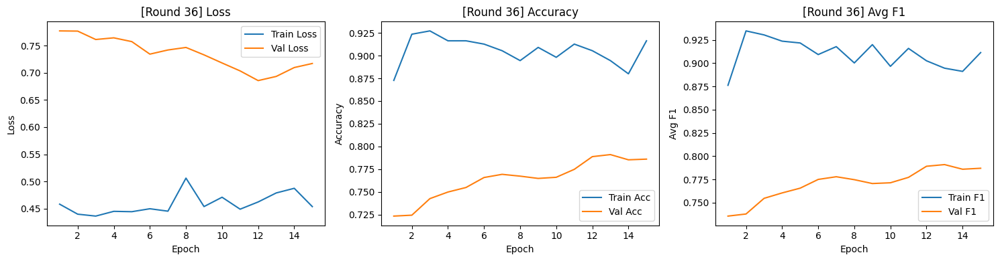


[AL Round 37/40] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.4376 | Acc: 0.9036 | Avg F1: 0.9102
Val   — Loss: 0.7095 | Acc: 0.7810 | Avg F1: 0.7864


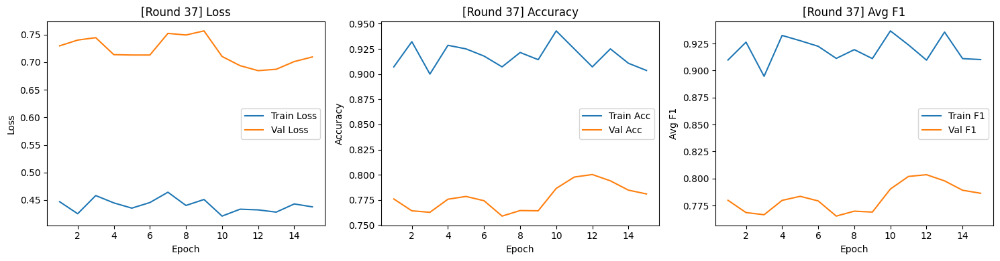


[AL Round 38/40] — Labeled samples: 285



Epoch 15/15
Train — Loss: 0.4321 | Acc: 0.9368 | Avg F1: 0.9435
Val   — Loss: 0.7147 | Acc: 0.7772 | Avg F1: 0.7860


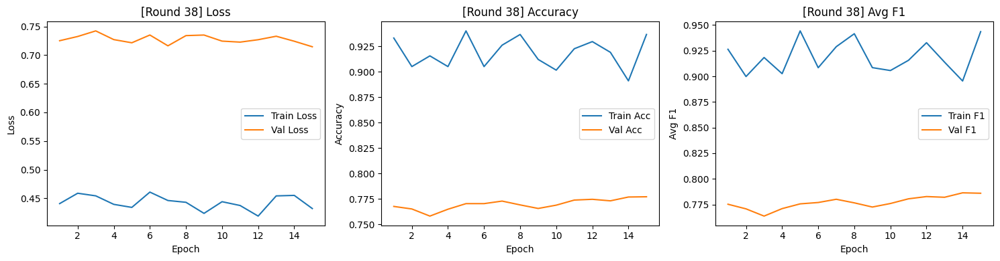


[AL Round 39/40] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.4234 | Acc: 0.9138 | Avg F1: 0.9146
Val   — Loss: 0.7291 | Acc: 0.7635 | Avg F1: 0.7720


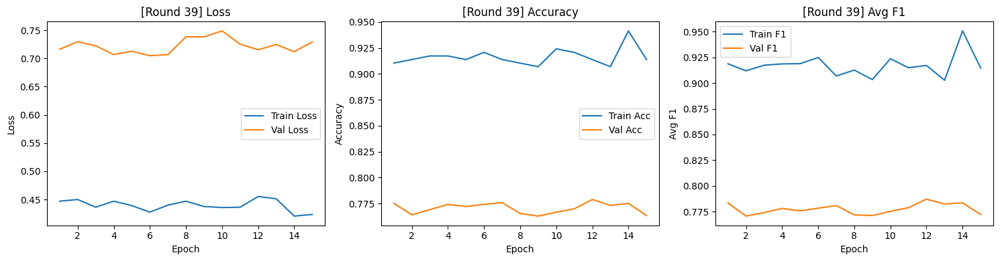


[AL Round 40/40] — Labeled samples: 295



Epoch 15/15
Train — Loss: 0.4224 | Acc: 0.9153 | Avg F1: 0.9212
Val   — Loss: 0.7255 | Acc: 0.7710 | Avg F1: 0.7761


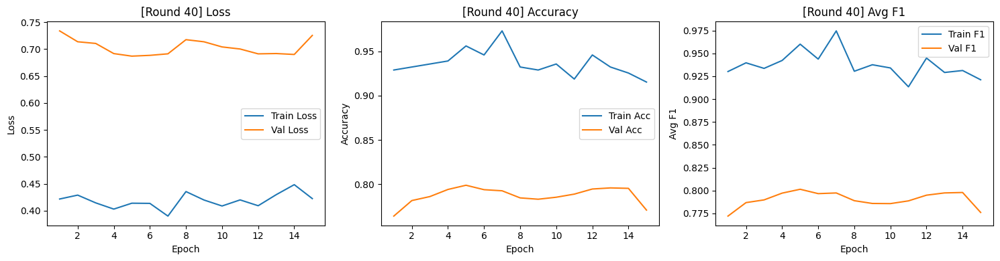

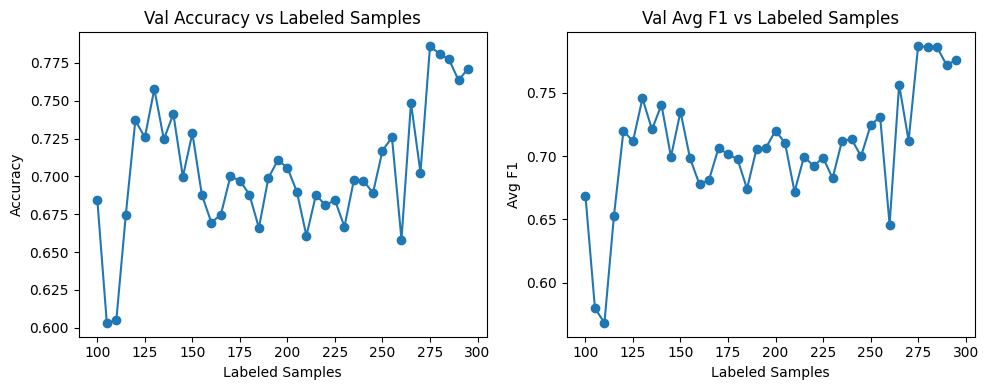


=== Running strategy: ENTROPY ===

[AL Round 1/40] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.9347 | Acc: 0.2800 | Avg F1: 0.2654
Val   — Loss: 1.1674 | Acc: 0.6438 | Avg F1: 0.6262


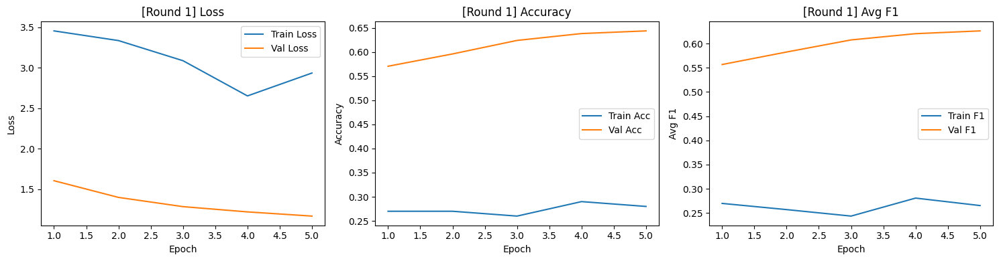


[AL Round 2/40] — Labeled samples: 105



Epoch 5/5
Train — Loss: 2.2260 | Acc: 0.4571 | Avg F1: 0.4504
Val   — Loss: 1.6737 | Acc: 0.6080 | Avg F1: 0.5895


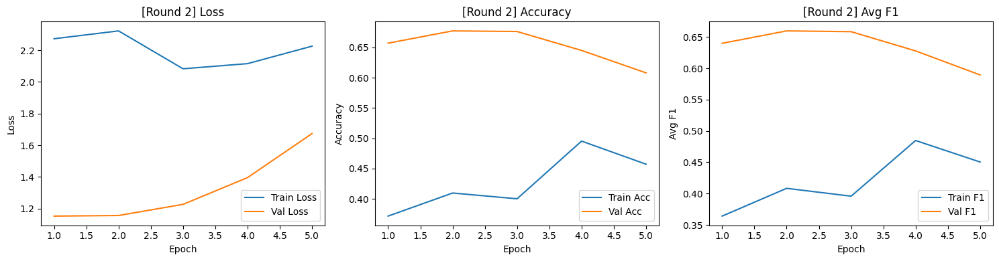


[AL Round 3/40] — Labeled samples: 110



Epoch 5/5
Train — Loss: 1.3949 | Acc: 0.5818 | Avg F1: 0.5693
Val   — Loss: 3.4617 | Acc: 0.5055 | Avg F1: 0.4424


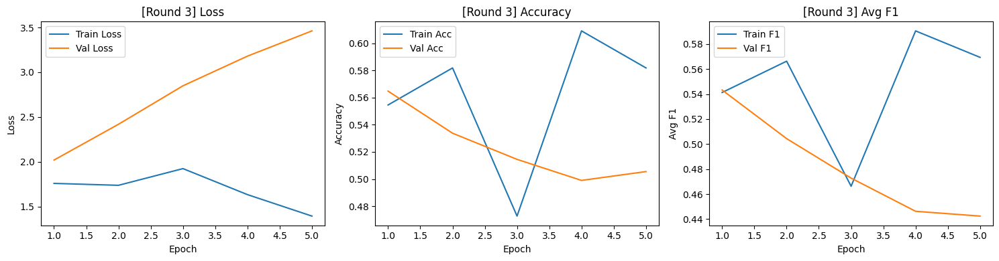


[AL Round 4/40] — Labeled samples: 115



Epoch 5/5
Train — Loss: 1.4756 | Acc: 0.6609 | Avg F1: 0.6337
Val   — Loss: 3.4577 | Acc: 0.5637 | Avg F1: 0.5066


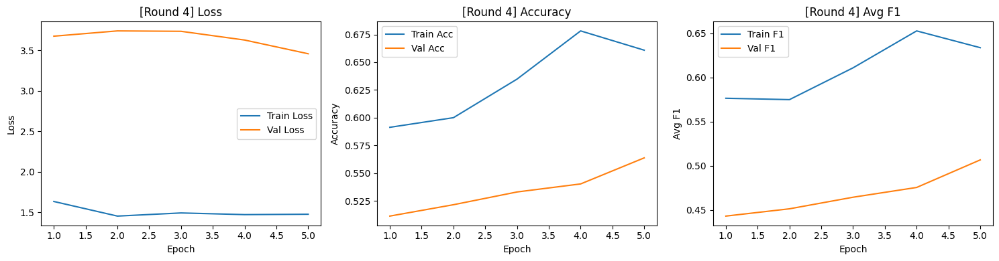


[AL Round 5/40] — Labeled samples: 120



Epoch 10/10
Train — Loss: 1.1817 | Acc: 0.7583 | Avg F1: 0.7248
Val   — Loss: 1.9720 | Acc: 0.7795 | Avg F1: 0.7658


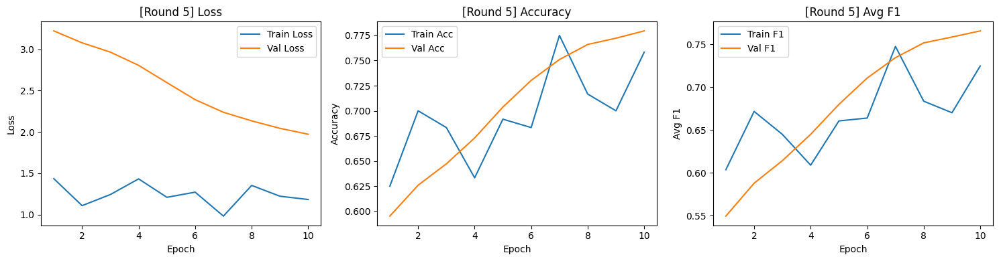


[AL Round 6/40] — Labeled samples: 125



Epoch 10/10
Train — Loss: 0.9009 | Acc: 0.7280 | Avg F1: 0.7245
Val   — Loss: 2.1606 | Acc: 0.7398 | Avg F1: 0.7226


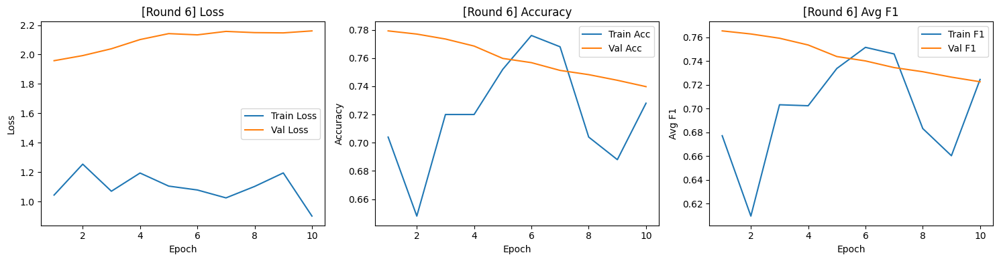


[AL Round 7/40] — Labeled samples: 130



Epoch 10/10
Train — Loss: 1.0763 | Acc: 0.6923 | Avg F1: 0.6654
Val   — Loss: 1.7217 | Acc: 0.7742 | Avg F1: 0.7697


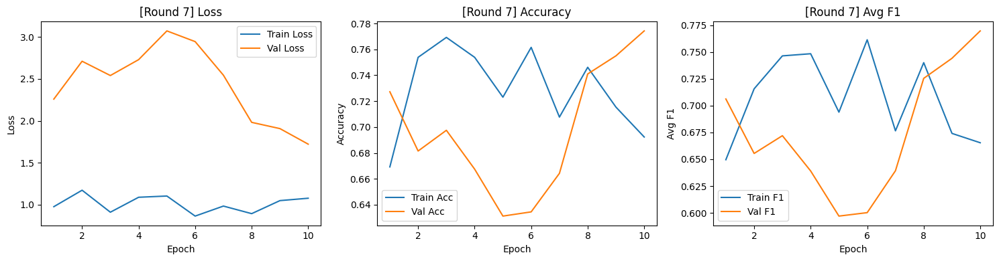


[AL Round 8/40] — Labeled samples: 135



Epoch 10/10
Train — Loss: 0.8875 | Acc: 0.7556 | Avg F1: 0.7097
Val   — Loss: 1.7148 | Acc: 0.7622 | Avg F1: 0.7503


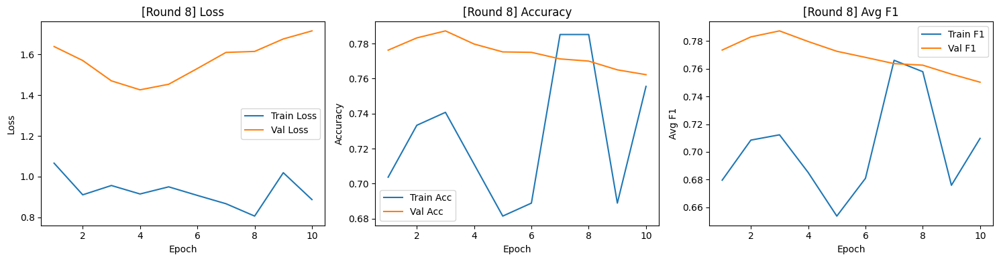


[AL Round 9/40] — Labeled samples: 140



Epoch 10/10
Train — Loss: 0.7819 | Acc: 0.8143 | Avg F1: 0.7884
Val   — Loss: 1.6761 | Acc: 0.7420 | Avg F1: 0.7305


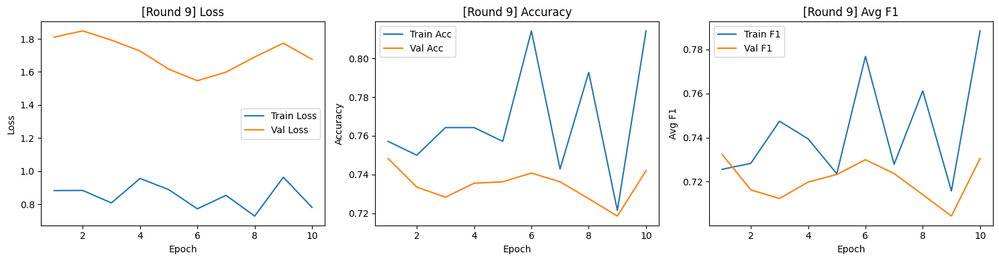


[AL Round 10/40] — Labeled samples: 145



Epoch 10/10
Train — Loss: 0.7418 | Acc: 0.8000 | Avg F1: 0.8109
Val   — Loss: 1.5319 | Acc: 0.7618 | Avg F1: 0.7472


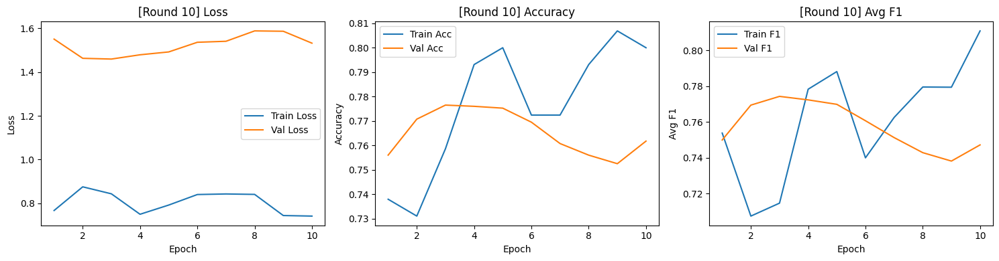


[AL Round 11/40] — Labeled samples: 150



Epoch 10/10
Train — Loss: 0.7832 | Acc: 0.7800 | Avg F1: 0.7909
Val   — Loss: 1.4223 | Acc: 0.7302 | Avg F1: 0.7198


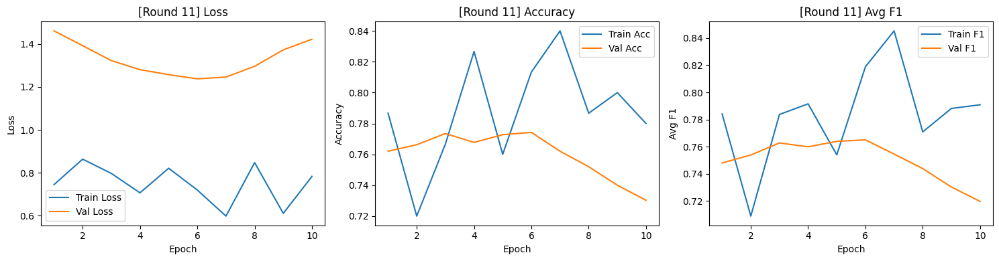


[AL Round 12/40] — Labeled samples: 155



Epoch 15/15
Train — Loss: 0.7410 | Acc: 0.8129 | Avg F1: 0.7714
Val   — Loss: 1.2583 | Acc: 0.7315 | Avg F1: 0.7287


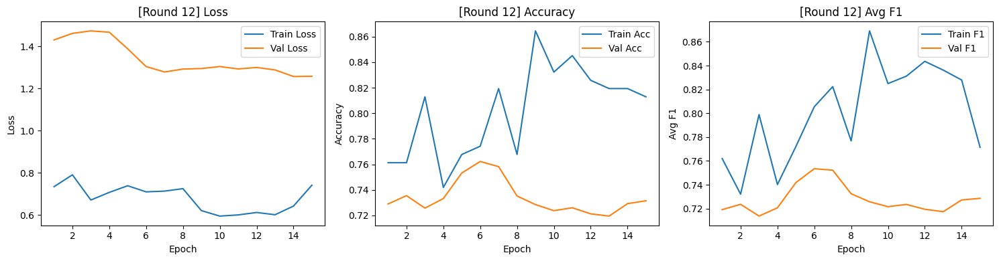


[AL Round 13/40] — Labeled samples: 160



Epoch 15/15
Train — Loss: 0.5941 | Acc: 0.8750 | Avg F1: 0.8726
Val   — Loss: 1.1583 | Acc: 0.7560 | Avg F1: 0.7534


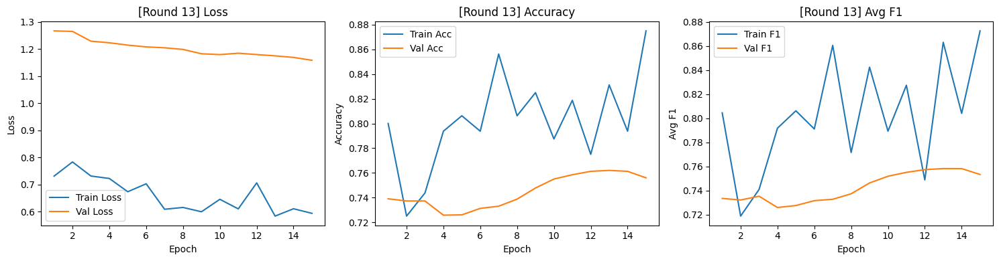


[AL Round 14/40] — Labeled samples: 165



Epoch 15/15
Train — Loss: 0.6995 | Acc: 0.8182 | Avg F1: 0.7989
Val   — Loss: 1.1232 | Acc: 0.7515 | Avg F1: 0.7546


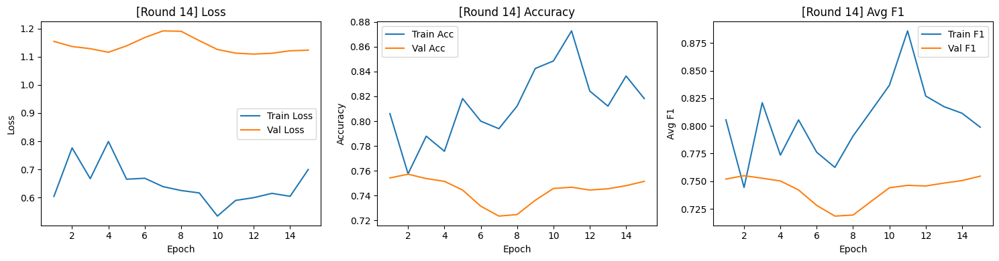


[AL Round 15/40] — Labeled samples: 170



Epoch 15/15
Train — Loss: 0.6472 | Acc: 0.7882 | Avg F1: 0.7893
Val   — Loss: 1.0516 | Acc: 0.7618 | Avg F1: 0.7623


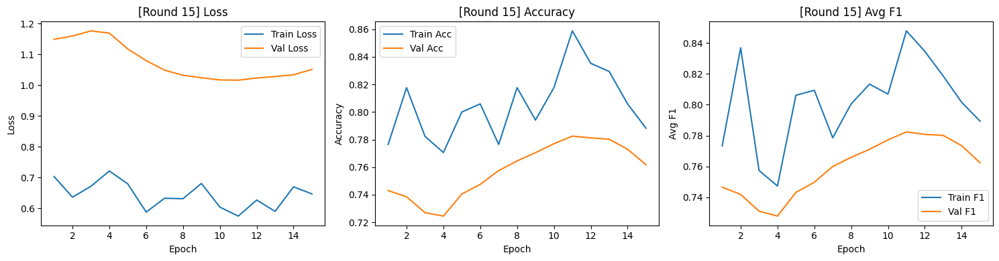


[AL Round 16/40] — Labeled samples: 175



Epoch 15/15
Train — Loss: 0.7142 | Acc: 0.8000 | Avg F1: 0.7741
Val   — Loss: 1.0253 | Acc: 0.7622 | Avg F1: 0.7642


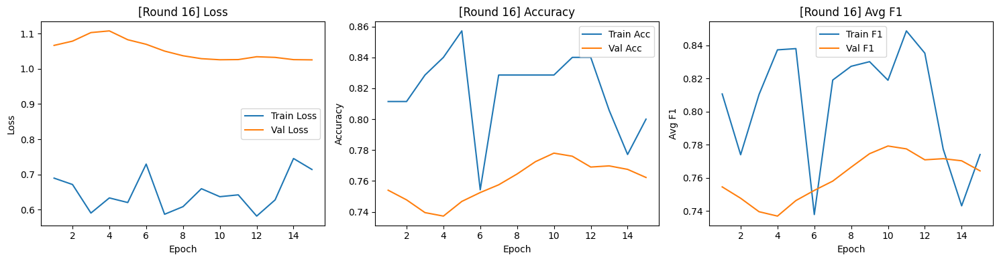


[AL Round 17/40] — Labeled samples: 180



Epoch 15/15
Train — Loss: 0.5648 | Acc: 0.8278 | Avg F1: 0.8056
Val   — Loss: 1.0174 | Acc: 0.7700 | Avg F1: 0.7696


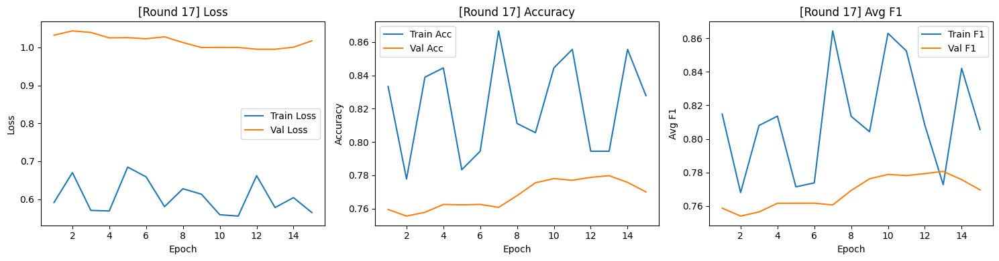


[AL Round 18/40] — Labeled samples: 185



Epoch 15/15
Train — Loss: 0.5487 | Acc: 0.8649 | Avg F1: 0.8563
Val   — Loss: 1.0048 | Acc: 0.7570 | Avg F1: 0.7603


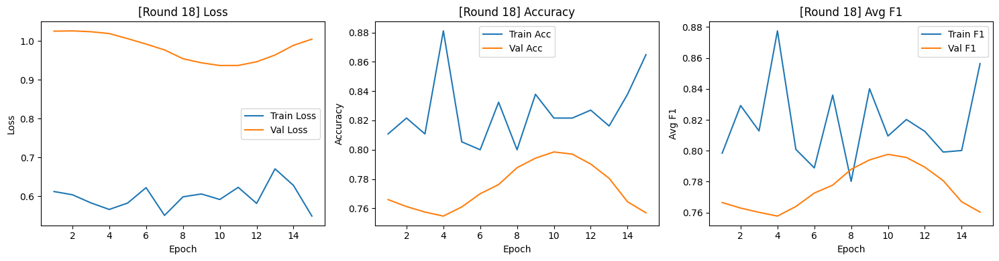


[AL Round 19/40] — Labeled samples: 190



Epoch 15/15
Train — Loss: 0.5761 | Acc: 0.8368 | Avg F1: 0.8269
Val   — Loss: 0.9658 | Acc: 0.7760 | Avg F1: 0.7821


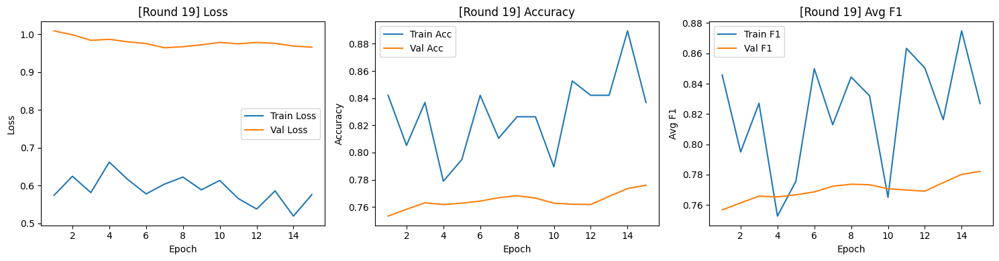


[AL Round 20/40] — Labeled samples: 195



Epoch 15/15
Train — Loss: 0.6267 | Acc: 0.8513 | Avg F1: 0.8470
Val   — Loss: 0.9631 | Acc: 0.8110 | Avg F1: 0.8167


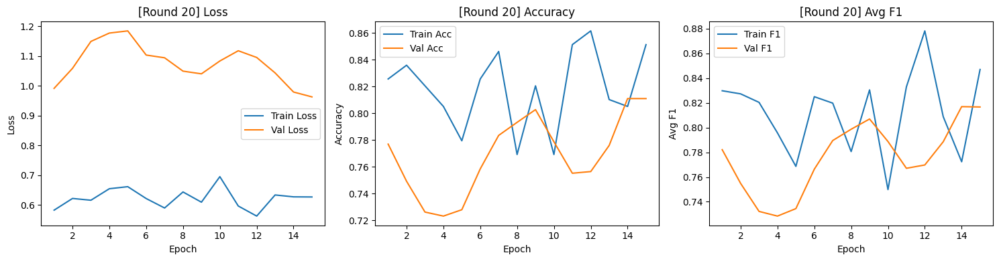


[AL Round 21/40] — Labeled samples: 200



Epoch 15/15
Train — Loss: 0.5330 | Acc: 0.8400 | Avg F1: 0.8191
Val   — Loss: 1.0286 | Acc: 0.7340 | Avg F1: 0.7466


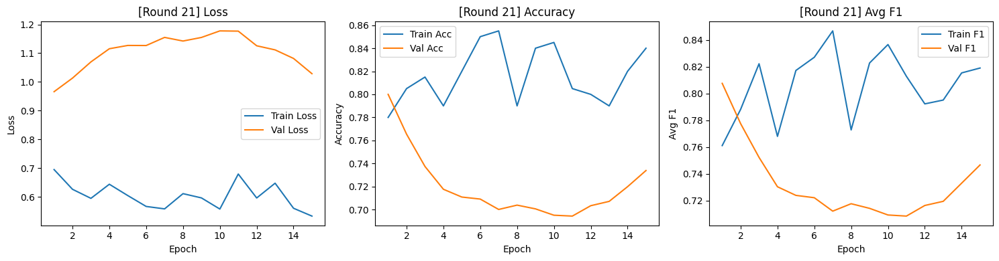


[AL Round 22/40] — Labeled samples: 205



Epoch 15/15
Train — Loss: 0.5847 | Acc: 0.8293 | Avg F1: 0.8183
Val   — Loss: 0.9757 | Acc: 0.7690 | Avg F1: 0.7799


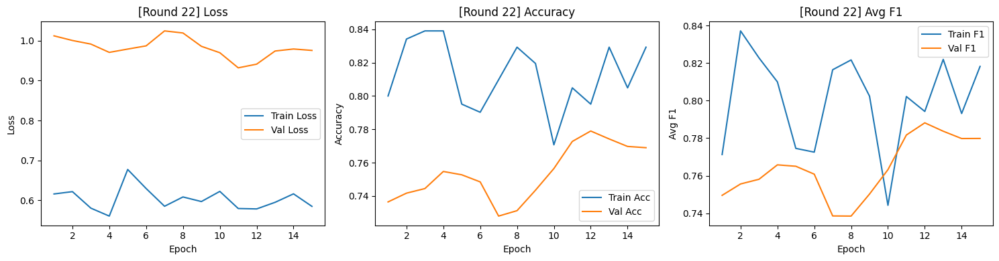


[AL Round 23/40] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.6135 | Acc: 0.8286 | Avg F1: 0.8214
Val   — Loss: 0.9004 | Acc: 0.7845 | Avg F1: 0.7941


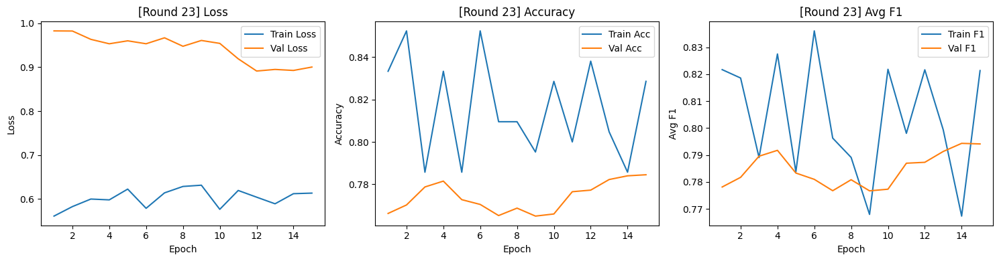


[AL Round 24/40] — Labeled samples: 215



Epoch 15/15
Train — Loss: 0.5540 | Acc: 0.8279 | Avg F1: 0.8087
Val   — Loss: 1.0738 | Acc: 0.7535 | Avg F1: 0.7641


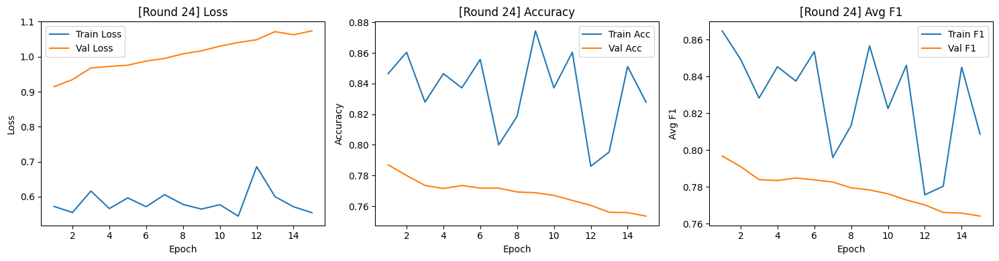


[AL Round 25/40] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.5842 | Acc: 0.8500 | Avg F1: 0.8471
Val   — Loss: 1.0334 | Acc: 0.7568 | Avg F1: 0.7658


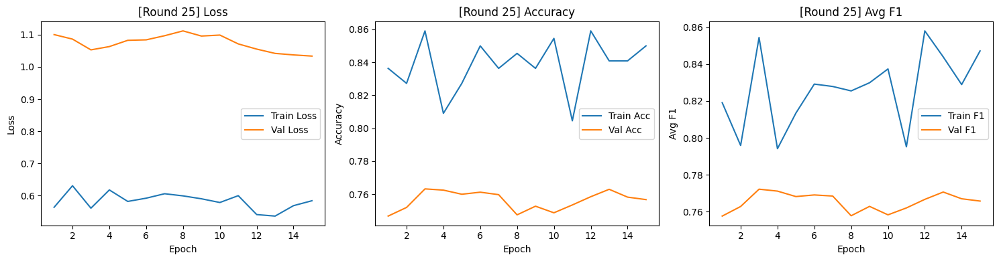


[AL Round 26/40] — Labeled samples: 225



Epoch 15/15
Train — Loss: 0.5988 | Acc: 0.8267 | Avg F1: 0.8154
Val   — Loss: 1.0601 | Acc: 0.7562 | Avg F1: 0.7658


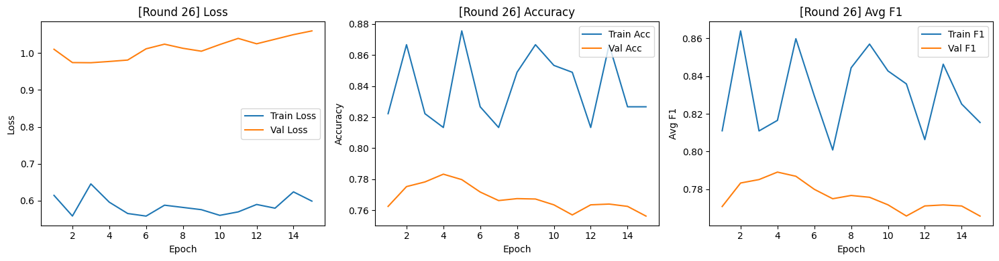


[AL Round 27/40] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.5657 | Acc: 0.8565 | Avg F1: 0.8594
Val   — Loss: 0.9795 | Acc: 0.7853 | Avg F1: 0.7901


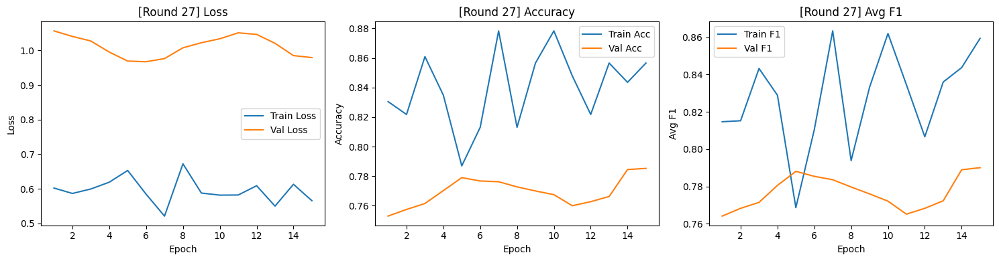


[AL Round 28/40] — Labeled samples: 235



Epoch 15/15
Train — Loss: 0.5935 | Acc: 0.8340 | Avg F1: 0.8264
Val   — Loss: 1.0589 | Acc: 0.7500 | Avg F1: 0.7533


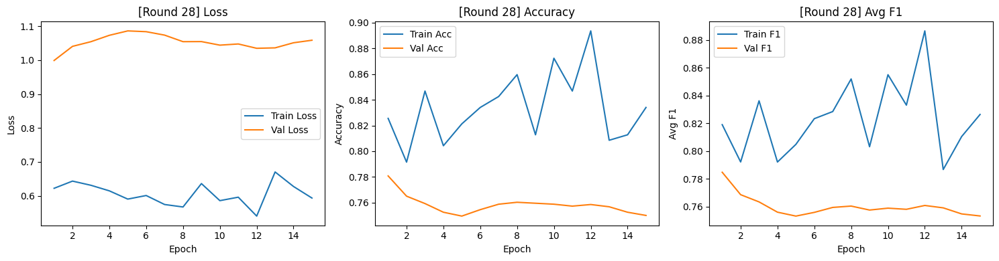


[AL Round 29/40] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.5884 | Acc: 0.8333 | Avg F1: 0.8300
Val   — Loss: 1.0684 | Acc: 0.7642 | Avg F1: 0.7665


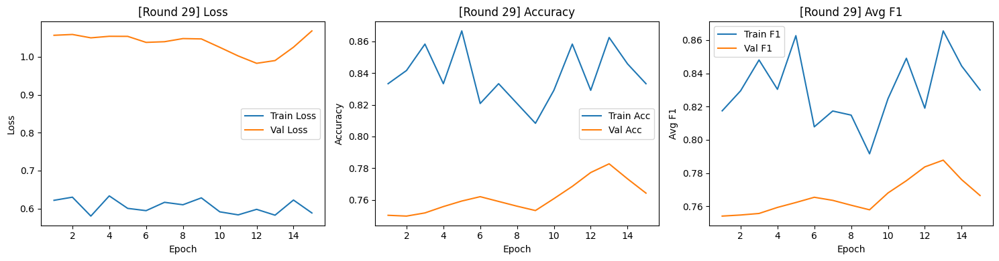


[AL Round 30/40] — Labeled samples: 245



Epoch 15/15
Train — Loss: 0.5862 | Acc: 0.8571 | Avg F1: 0.8487
Val   — Loss: 1.0543 | Acc: 0.7642 | Avg F1: 0.7711


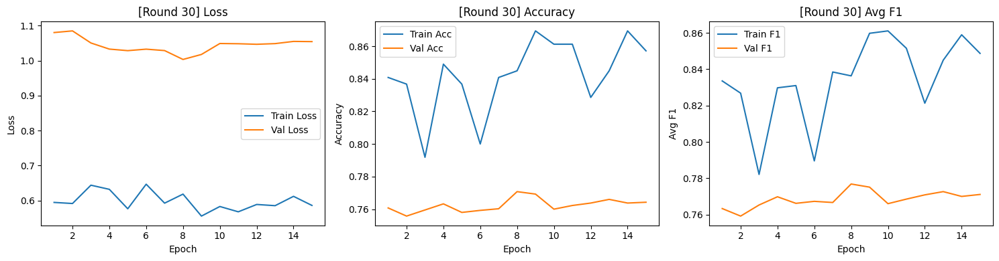


[AL Round 31/40] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.5981 | Acc: 0.8680 | Avg F1: 0.8573
Val   — Loss: 0.9799 | Acc: 0.7795 | Avg F1: 0.7901


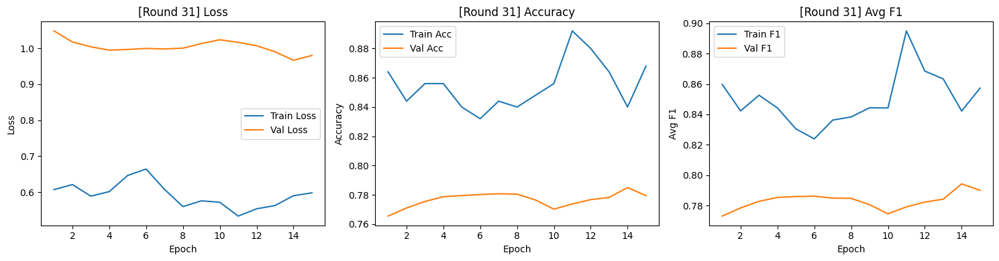


[AL Round 32/40] — Labeled samples: 255



Epoch 15/15
Train — Loss: 0.5847 | Acc: 0.8549 | Avg F1: 0.8515
Val   — Loss: 1.0353 | Acc: 0.7740 | Avg F1: 0.7787


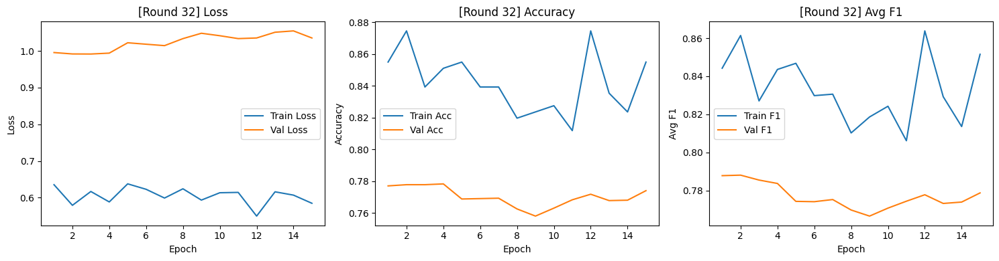


[AL Round 33/40] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.6571 | Acc: 0.8154 | Avg F1: 0.8046
Val   — Loss: 1.1701 | Acc: 0.7177 | Avg F1: 0.7199


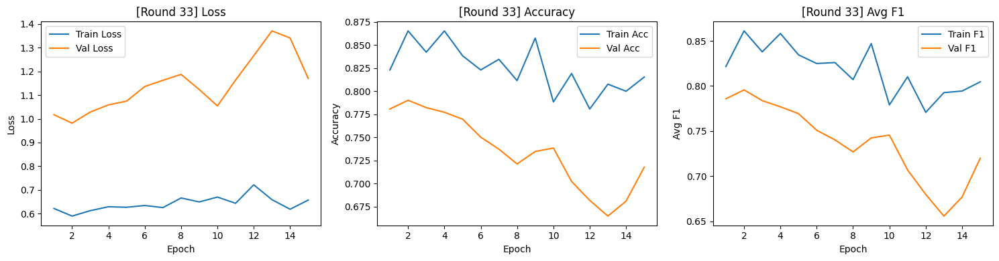


[AL Round 34/40] — Labeled samples: 265



Epoch 15/15
Train — Loss: 0.5785 | Acc: 0.8679 | Avg F1: 0.8689
Val   — Loss: 1.1371 | Acc: 0.7415 | Avg F1: 0.7486


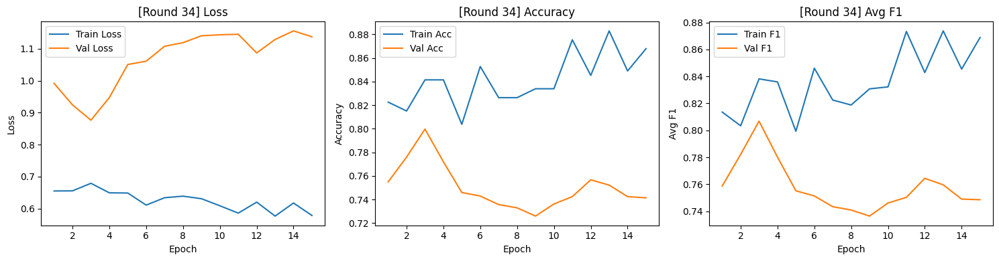


[AL Round 35/40] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.6162 | Acc: 0.8296 | Avg F1: 0.8301
Val   — Loss: 0.9590 | Acc: 0.7845 | Avg F1: 0.7888


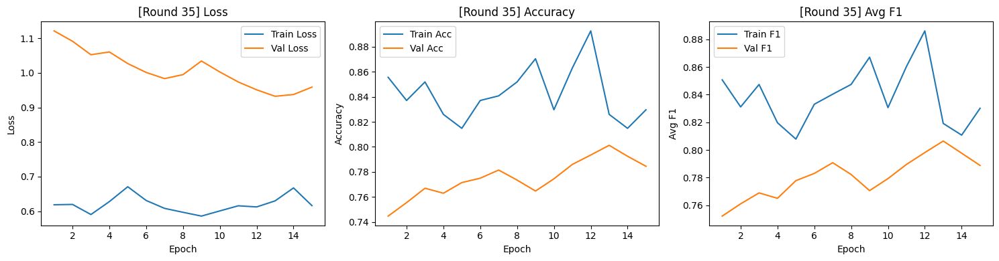


[AL Round 36/40] — Labeled samples: 275



Epoch 15/15
Train — Loss: 0.6026 | Acc: 0.8509 | Avg F1: 0.8497
Val   — Loss: 0.9885 | Acc: 0.7853 | Avg F1: 0.7919


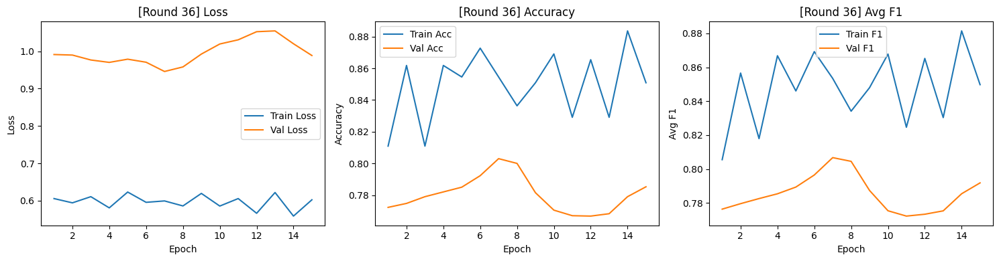


[AL Round 37/40] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.5698 | Acc: 0.8643 | Avg F1: 0.8578
Val   — Loss: 0.9951 | Acc: 0.7817 | Avg F1: 0.7878


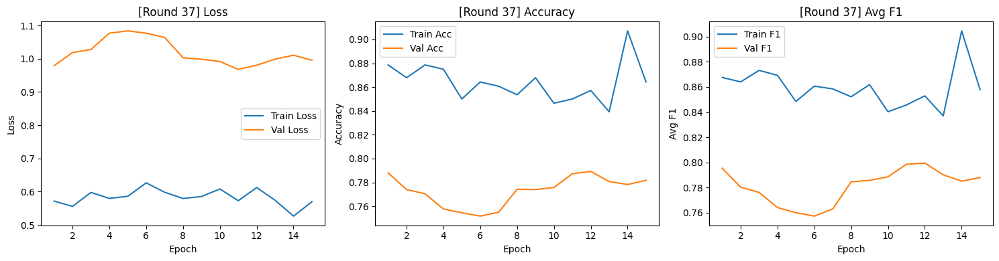


[AL Round 38/40] — Labeled samples: 285



Epoch 15/15
Train — Loss: 0.5678 | Acc: 0.8561 | Avg F1: 0.8517
Val   — Loss: 1.0073 | Acc: 0.7857 | Avg F1: 0.7910


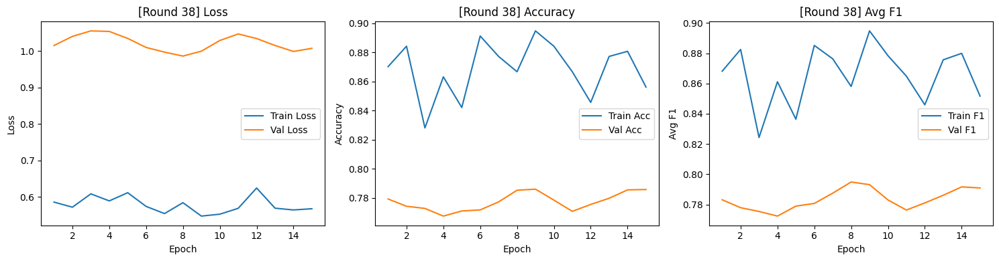


[AL Round 39/40] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.5846 | Acc: 0.8828 | Avg F1: 0.8779
Val   — Loss: 1.0256 | Acc: 0.7843 | Avg F1: 0.7931


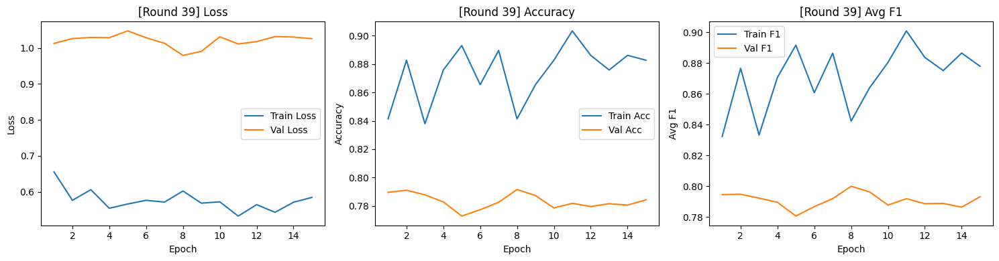


[AL Round 40/40] — Labeled samples: 295



Epoch 15/15
Train — Loss: 0.5895 | Acc: 0.8610 | Avg F1: 0.8594
Val   — Loss: 1.0163 | Acc: 0.7850 | Avg F1: 0.7914


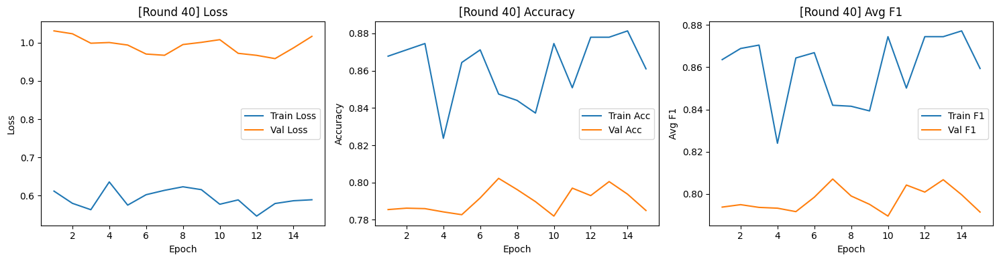

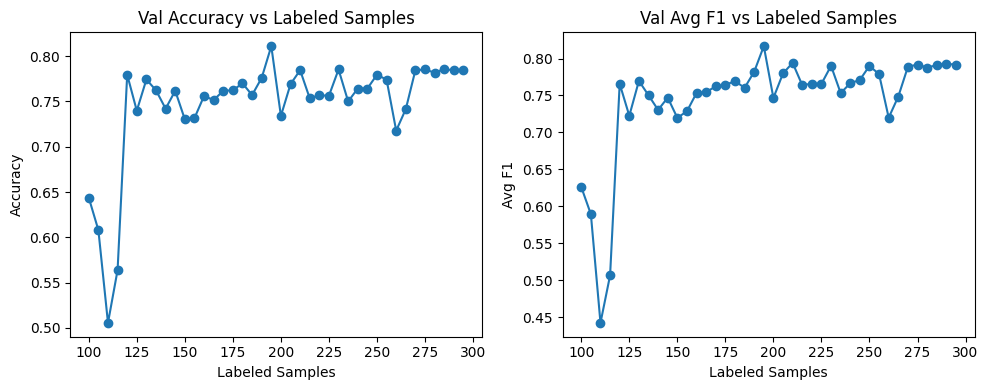


=== Running strategy: ENTROPY_DIVERSITY ===

[AL Round 1/40] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.6933 | Acc: 0.3100 | Avg F1: 0.3000
Val   — Loss: 1.1472 | Acc: 0.6793 | Avg F1: 0.6552


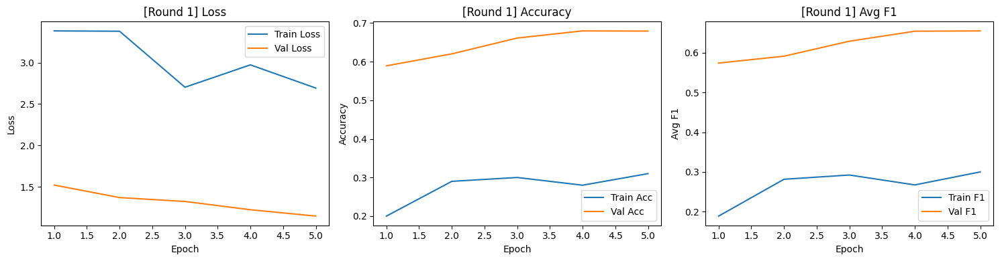


[AL Round 2/40] — Labeled samples: 105



Epoch 5/5
Train — Loss: 2.1116 | Acc: 0.5143 | Avg F1: 0.5084
Val   — Loss: 1.8163 | Acc: 0.5110 | Avg F1: 0.5117


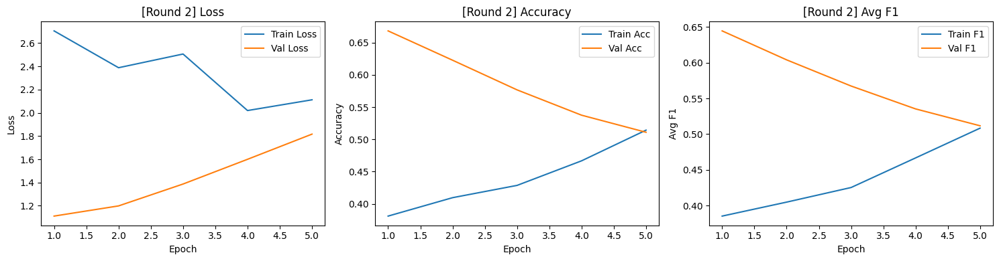


[AL Round 3/40] — Labeled samples: 110



Epoch 5/5
Train — Loss: 1.7549 | Acc: 0.5818 | Avg F1: 0.5672
Val   — Loss: 2.6492 | Acc: 0.5447 | Avg F1: 0.5185


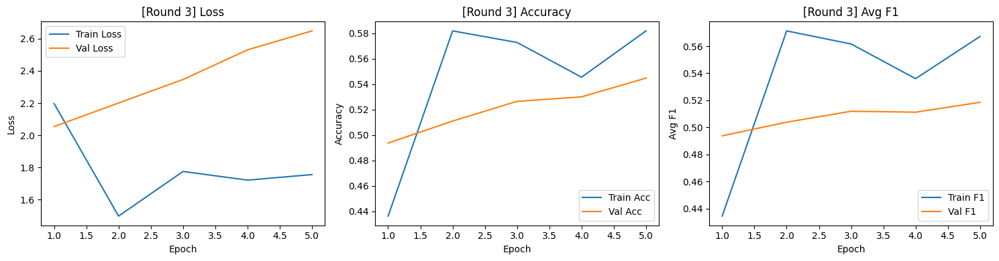


[AL Round 4/40] — Labeled samples: 115



Epoch 5/5
Train — Loss: 1.5013 | Acc: 0.5826 | Avg F1: 0.5685
Val   — Loss: 3.0097 | Acc: 0.5893 | Avg F1: 0.5510


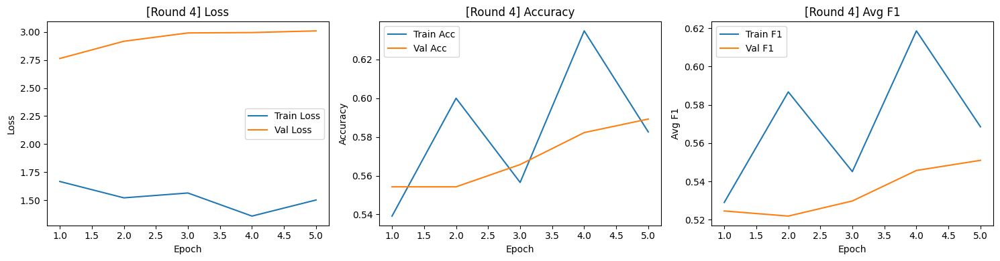


[AL Round 5/40] — Labeled samples: 120



Epoch 10/10
Train — Loss: 1.1073 | Acc: 0.6833 | Avg F1: 0.6533
Val   — Loss: 2.1873 | Acc: 0.7205 | Avg F1: 0.7050


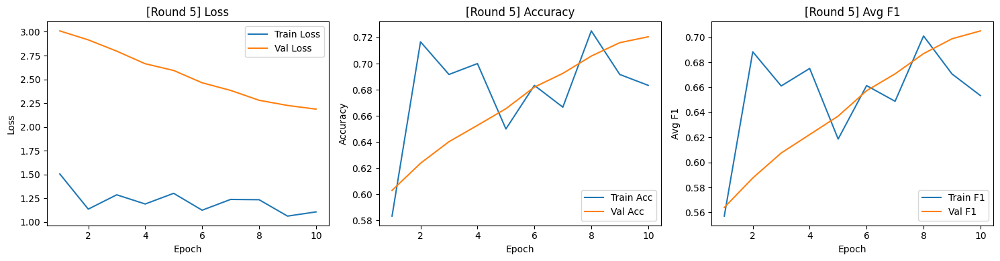


[AL Round 6/40] — Labeled samples: 125



Epoch 10/10
Train — Loss: 0.8983 | Acc: 0.7680 | Avg F1: 0.7542
Val   — Loss: 2.1761 | Acc: 0.7272 | Avg F1: 0.7089


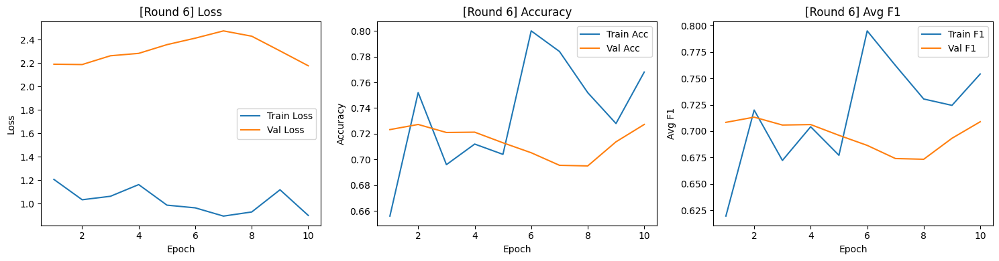


[AL Round 7/40] — Labeled samples: 130



Epoch 10/10
Train — Loss: 0.9320 | Acc: 0.7538 | Avg F1: 0.7393
Val   — Loss: 2.0620 | Acc: 0.7290 | Avg F1: 0.7284


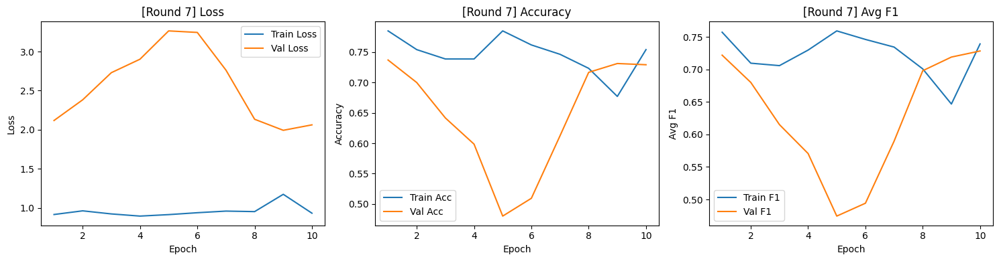


[AL Round 8/40] — Labeled samples: 135



Epoch 10/10
Train — Loss: 0.8463 | Acc: 0.7704 | Avg F1: 0.7579
Val   — Loss: 2.2012 | Acc: 0.7238 | Avg F1: 0.7370


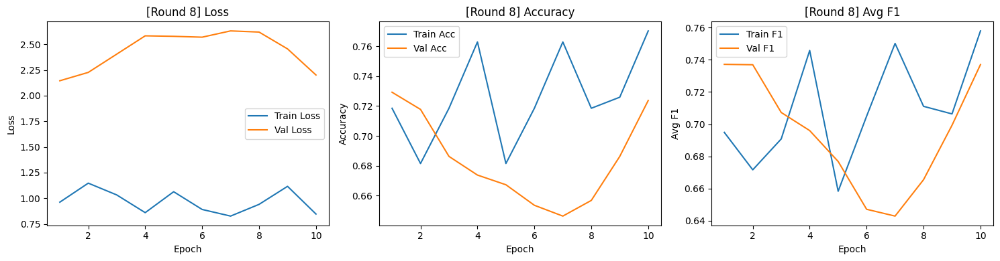


[AL Round 9/40] — Labeled samples: 140



Epoch 10/10
Train — Loss: 0.8703 | Acc: 0.7214 | Avg F1: 0.7141
Val   — Loss: 2.0251 | Acc: 0.7308 | Avg F1: 0.7238


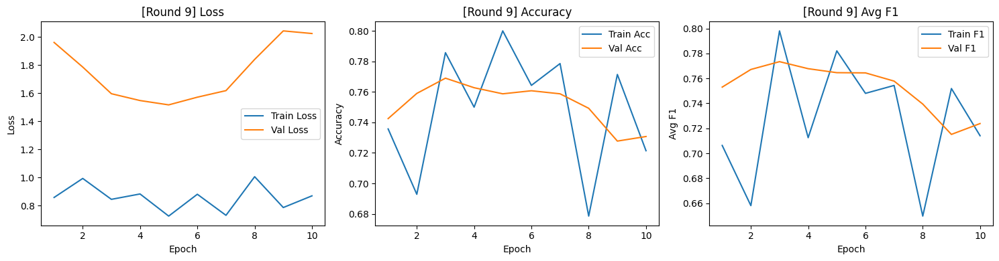


[AL Round 10/40] — Labeled samples: 145



Epoch 10/10
Train — Loss: 0.7425 | Acc: 0.7793 | Avg F1: 0.7499
Val   — Loss: 1.3514 | Acc: 0.7410 | Avg F1: 0.7534


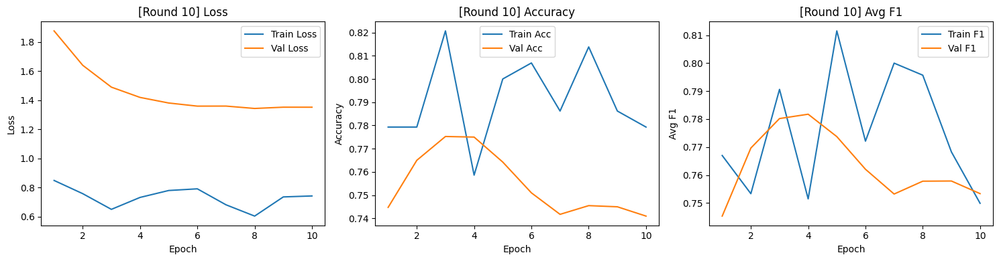


[AL Round 11/40] — Labeled samples: 150



Epoch 10/10
Train — Loss: 0.8087 | Acc: 0.7467 | Avg F1: 0.7108
Val   — Loss: 1.2337 | Acc: 0.7535 | Avg F1: 0.7609


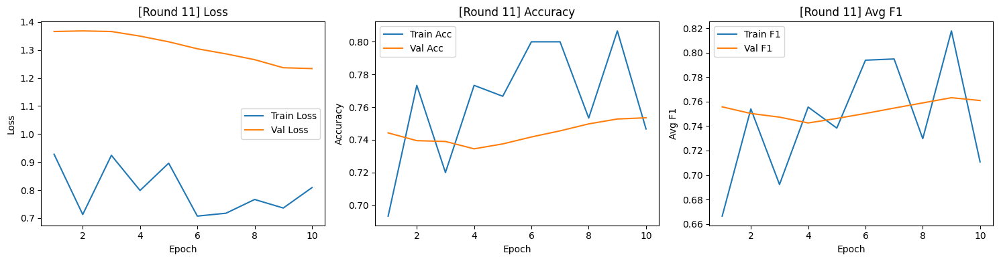


[AL Round 12/40] — Labeled samples: 155



Epoch 15/15
Train — Loss: 0.6149 | Acc: 0.7742 | Avg F1: 0.7728
Val   — Loss: 1.1166 | Acc: 0.7358 | Avg F1: 0.7445


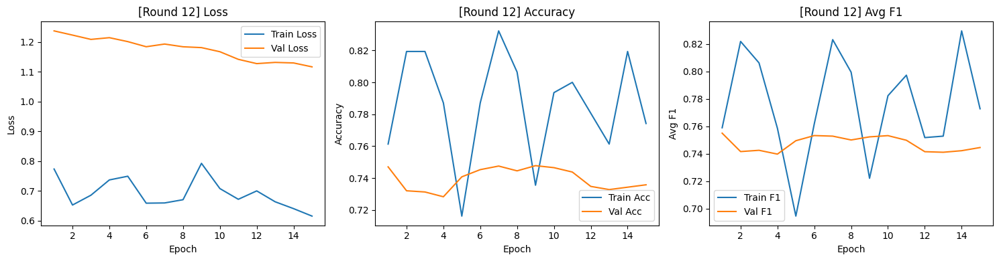


[AL Round 13/40] — Labeled samples: 160



Epoch 15/15
Train — Loss: 0.6498 | Acc: 0.7937 | Avg F1: 0.7850
Val   — Loss: 1.0667 | Acc: 0.7438 | Avg F1: 0.7454


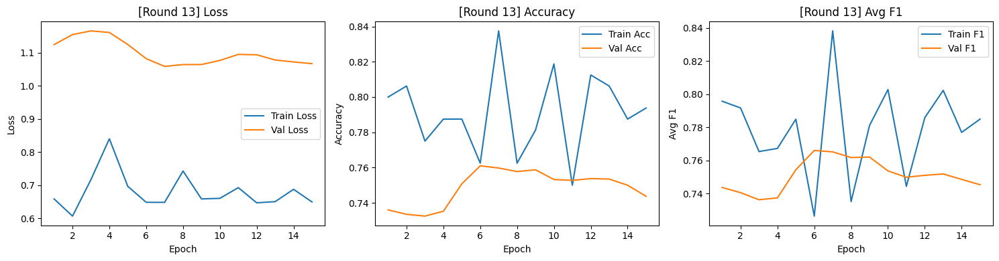


[AL Round 14/40] — Labeled samples: 165



Epoch 15/15
Train — Loss: 0.6489 | Acc: 0.7818 | Avg F1: 0.7458
Val   — Loss: 1.0355 | Acc: 0.7410 | Avg F1: 0.7399


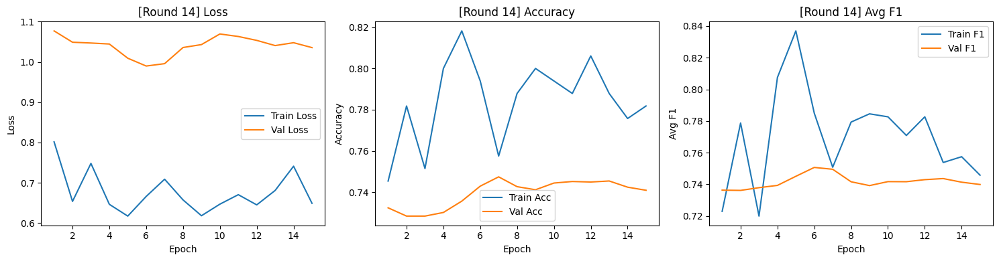


[AL Round 15/40] — Labeled samples: 170



Epoch 15/15
Train — Loss: 0.5942 | Acc: 0.8235 | Avg F1: 0.8159
Val   — Loss: 0.9399 | Acc: 0.7565 | Avg F1: 0.7606


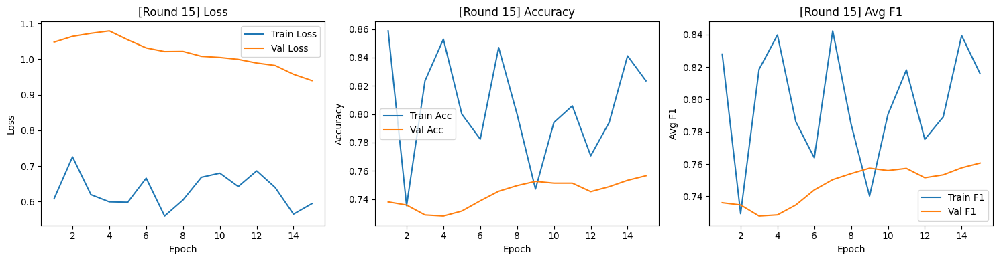


[AL Round 16/40] — Labeled samples: 175



Epoch 15/15
Train — Loss: 0.5736 | Acc: 0.8514 | Avg F1: 0.8444
Val   — Loss: 1.0087 | Acc: 0.7220 | Avg F1: 0.7243


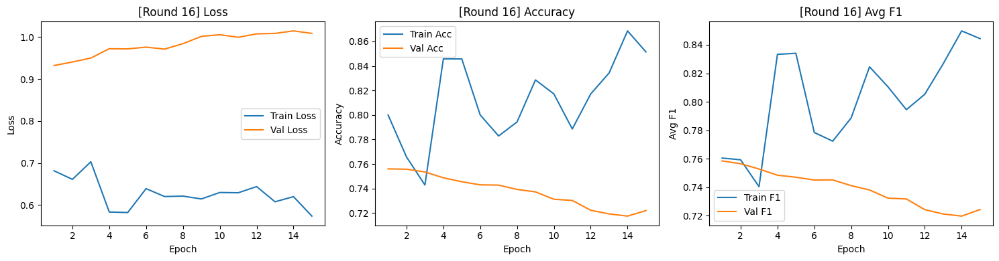


[AL Round 17/40] — Labeled samples: 180



Epoch 15/15
Train — Loss: 0.6208 | Acc: 0.8167 | Avg F1: 0.8162
Val   — Loss: 0.9471 | Acc: 0.7345 | Avg F1: 0.7346


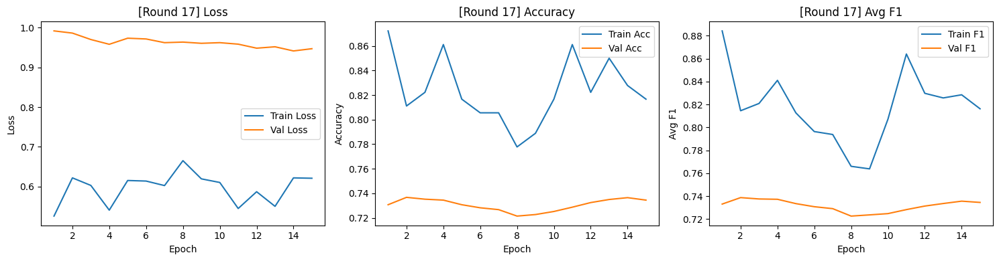


[AL Round 18/40] — Labeled samples: 185



Epoch 15/15
Train — Loss: 0.6550 | Acc: 0.8054 | Avg F1: 0.7929
Val   — Loss: 0.9523 | Acc: 0.7412 | Avg F1: 0.7375


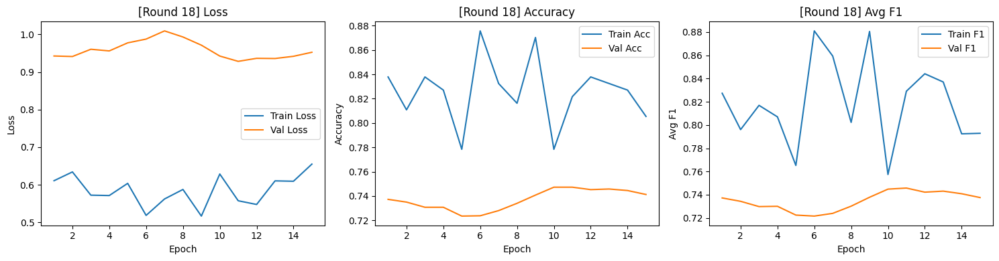


[AL Round 19/40] — Labeled samples: 190



Epoch 15/15
Train — Loss: 0.6123 | Acc: 0.7737 | Avg F1: 0.7496
Val   — Loss: 0.9334 | Acc: 0.7458 | Avg F1: 0.7443


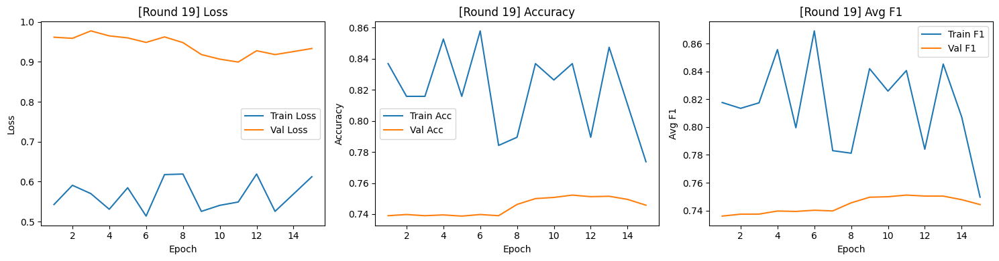


[AL Round 20/40] — Labeled samples: 195



Epoch 15/15
Train — Loss: 0.5743 | Acc: 0.8205 | Avg F1: 0.8214
Val   — Loss: 0.9536 | Acc: 0.7017 | Avg F1: 0.6968


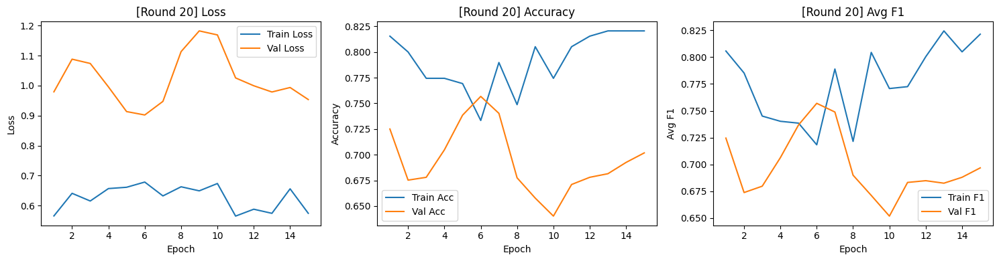


[AL Round 21/40] — Labeled samples: 200



Epoch 15/15
Train — Loss: 0.6276 | Acc: 0.7500 | Avg F1: 0.7416
Val   — Loss: 1.0579 | Acc: 0.6705 | Avg F1: 0.6684


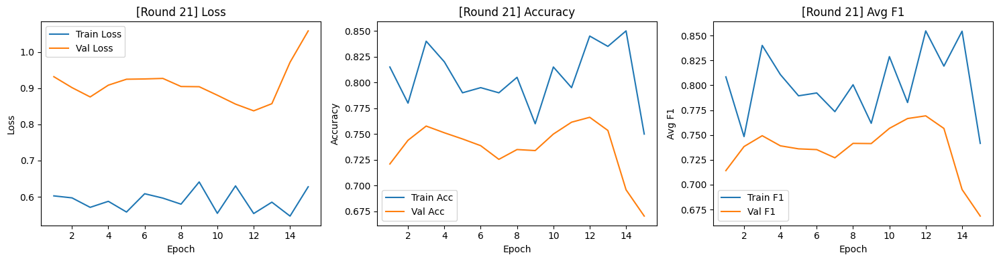


[AL Round 22/40] — Labeled samples: 205



Epoch 15/15
Train — Loss: 0.5533 | Acc: 0.8049 | Avg F1: 0.8076
Val   — Loss: 0.9447 | Acc: 0.7123 | Avg F1: 0.7218


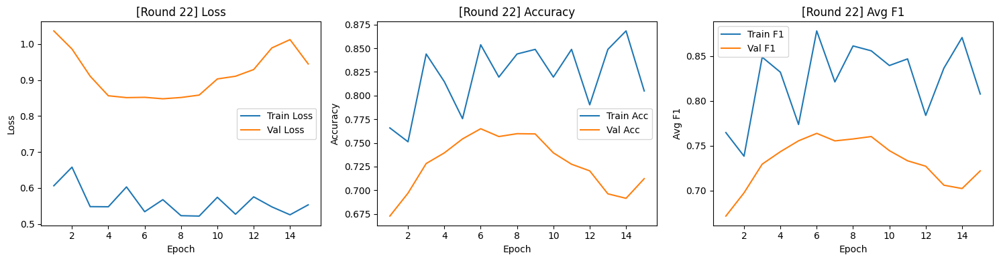


[AL Round 23/40] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.4913 | Acc: 0.8571 | Avg F1: 0.8635
Val   — Loss: 0.8712 | Acc: 0.7390 | Avg F1: 0.7454


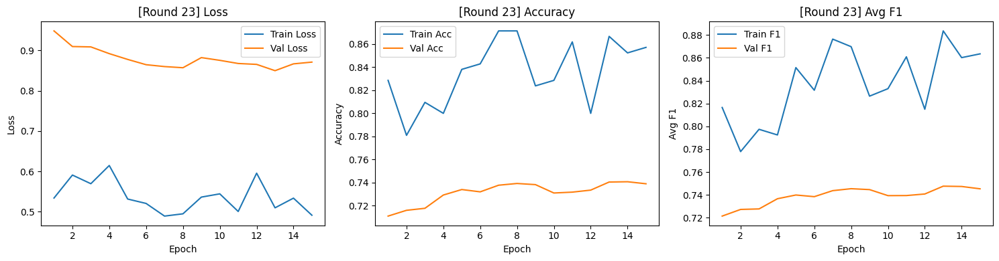


[AL Round 24/40] — Labeled samples: 215



Epoch 15/15
Train — Loss: 0.5618 | Acc: 0.8186 | Avg F1: 0.8291
Val   — Loss: 0.9343 | Acc: 0.7295 | Avg F1: 0.7361


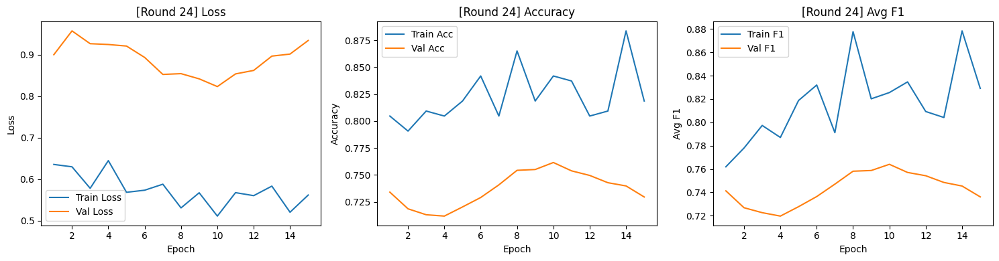


[AL Round 25/40] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.5734 | Acc: 0.8455 | Avg F1: 0.8495
Val   — Loss: 0.9044 | Acc: 0.7240 | Avg F1: 0.7344


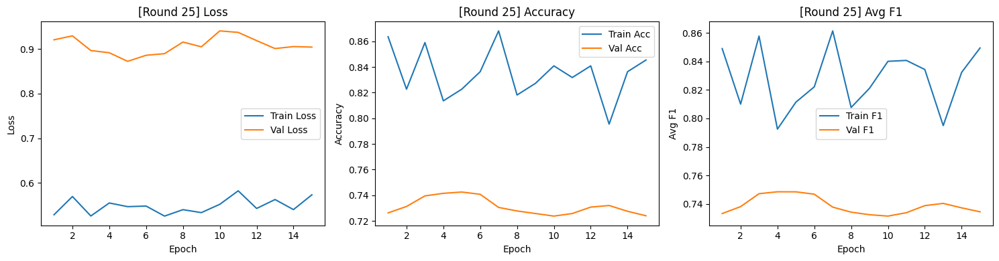


[AL Round 26/40] — Labeled samples: 225



Epoch 15/15
Train — Loss: 0.5211 | Acc: 0.8489 | Avg F1: 0.8486
Val   — Loss: 0.8617 | Acc: 0.7602 | Avg F1: 0.7652


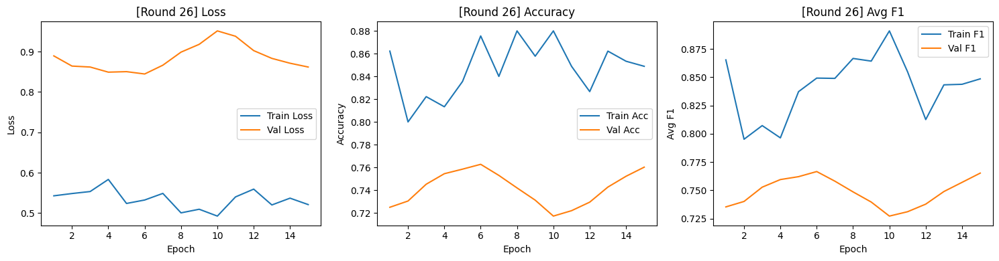


[AL Round 27/40] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.5571 | Acc: 0.8130 | Avg F1: 0.8174
Val   — Loss: 0.8414 | Acc: 0.7648 | Avg F1: 0.7719


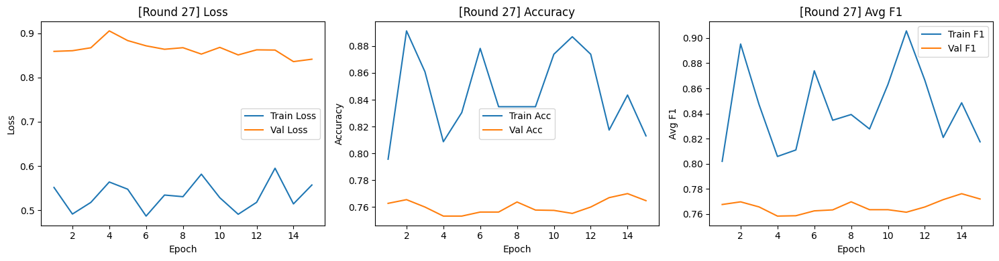


[AL Round 28/40] — Labeled samples: 235



Epoch 15/15
Train — Loss: 0.5091 | Acc: 0.8511 | Avg F1: 0.8461
Val   — Loss: 0.8866 | Acc: 0.7462 | Avg F1: 0.7558


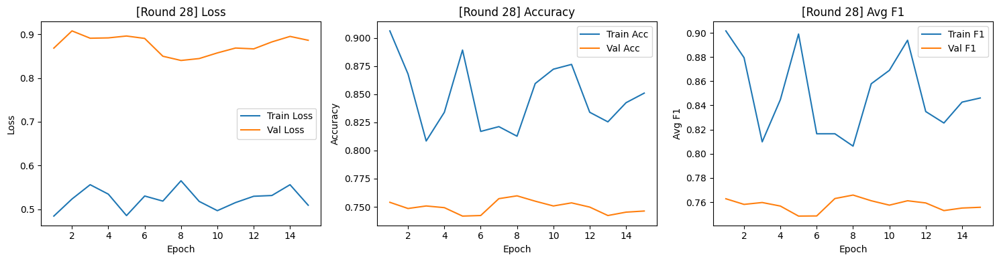


[AL Round 29/40] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.5243 | Acc: 0.8250 | Avg F1: 0.8334
Val   — Loss: 0.9142 | Acc: 0.7362 | Avg F1: 0.7465


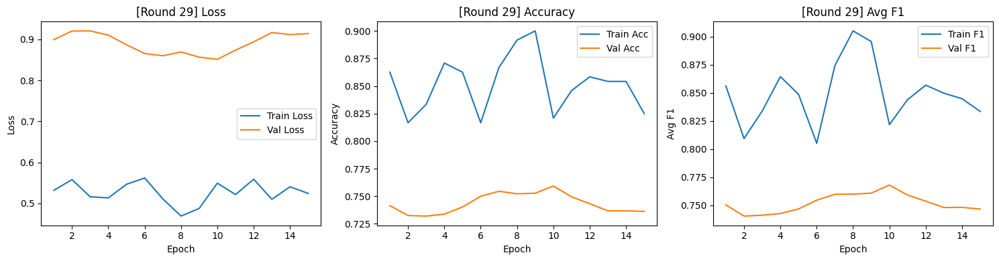


[AL Round 30/40] — Labeled samples: 245



Epoch 15/15
Train — Loss: 0.5015 | Acc: 0.8449 | Avg F1: 0.8524
Val   — Loss: 0.8703 | Acc: 0.7515 | Avg F1: 0.7631


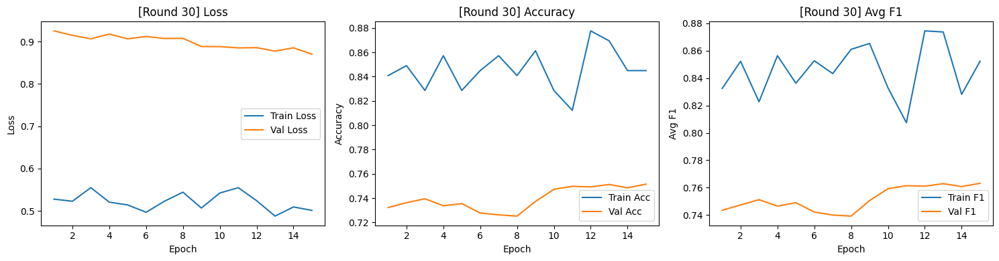


[AL Round 31/40] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.5324 | Acc: 0.8360 | Avg F1: 0.8285
Val   — Loss: 0.8983 | Acc: 0.7400 | Avg F1: 0.7511


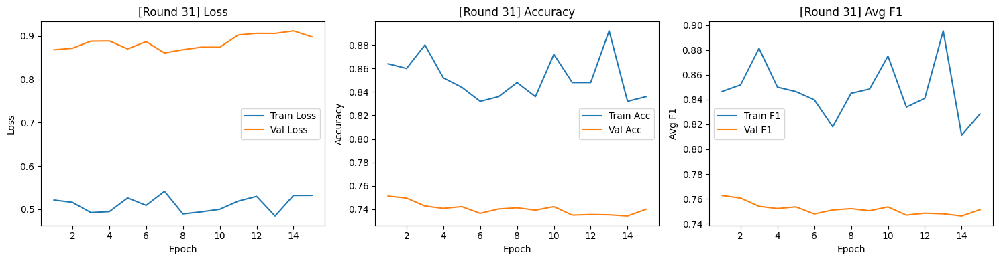


[AL Round 32/40] — Labeled samples: 255



Epoch 15/15
Train — Loss: 0.4978 | Acc: 0.8588 | Avg F1: 0.8594
Val   — Loss: 0.9138 | Acc: 0.7268 | Avg F1: 0.7402


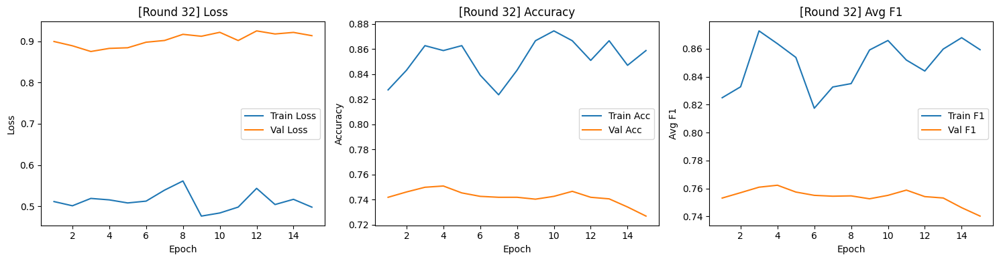


[AL Round 33/40] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.5395 | Acc: 0.8462 | Avg F1: 0.8170
Val   — Loss: 0.7547 | Acc: 0.7708 | Avg F1: 0.7737


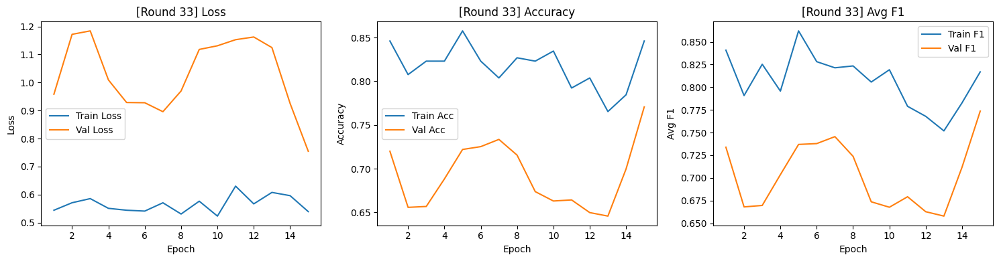


[AL Round 34/40] — Labeled samples: 265



Epoch 15/15
Train — Loss: 0.5391 | Acc: 0.8189 | Avg F1: 0.8080
Val   — Loss: 0.8145 | Acc: 0.7745 | Avg F1: 0.7838


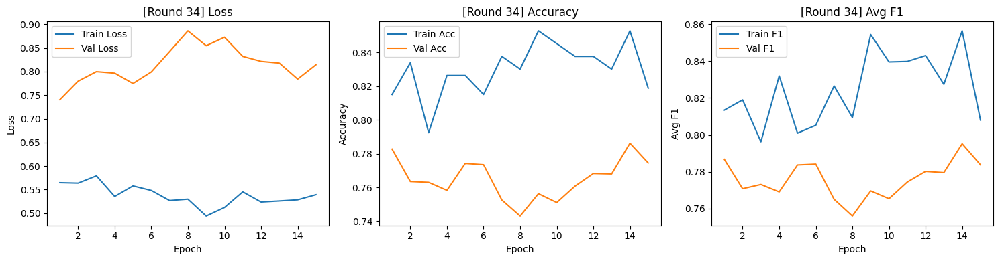


[AL Round 35/40] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.4838 | Acc: 0.8630 | Avg F1: 0.8595
Val   — Loss: 0.8790 | Acc: 0.7565 | Avg F1: 0.7661


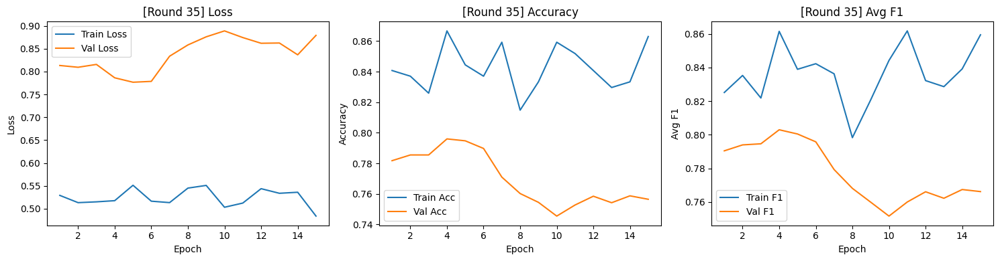


[AL Round 36/40] — Labeled samples: 275



Epoch 15/15
Train — Loss: 0.5444 | Acc: 0.8327 | Avg F1: 0.8313
Val   — Loss: 0.9858 | Acc: 0.7103 | Avg F1: 0.7196


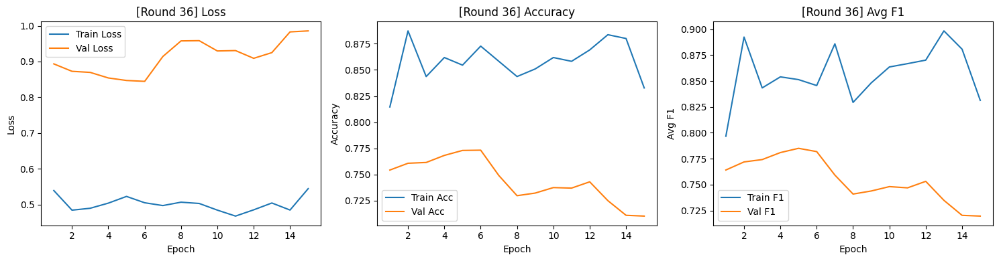


[AL Round 37/40] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.4776 | Acc: 0.8821 | Avg F1: 0.8810
Val   — Loss: 0.8828 | Acc: 0.7540 | Avg F1: 0.7649


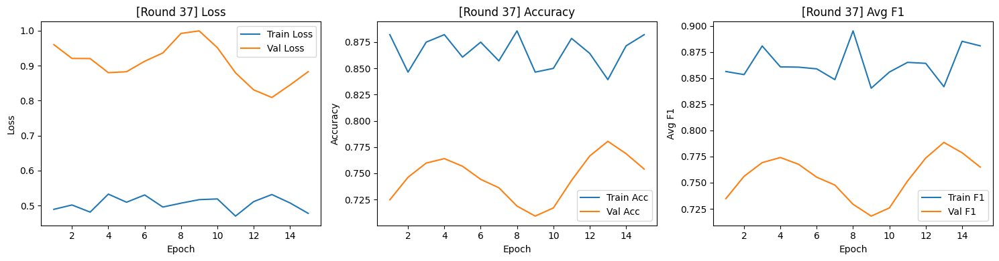


[AL Round 38/40] — Labeled samples: 285



Epoch 15/15
Train — Loss: 0.4728 | Acc: 0.8632 | Avg F1: 0.8715
Val   — Loss: 0.9720 | Acc: 0.7348 | Avg F1: 0.7447


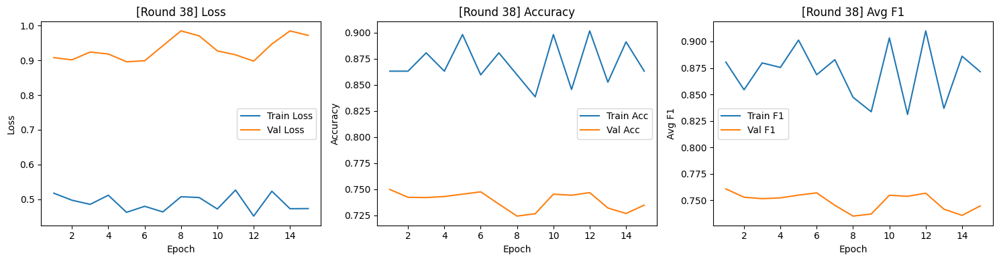


[AL Round 39/40] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.4700 | Acc: 0.8655 | Avg F1: 0.8617
Val   — Loss: 0.9251 | Acc: 0.7428 | Avg F1: 0.7523


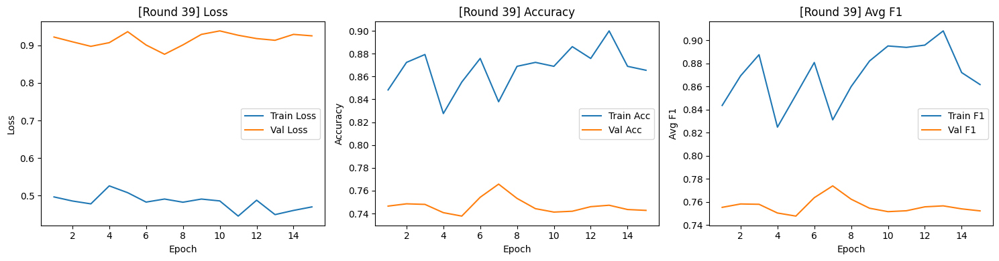


[AL Round 40/40] — Labeled samples: 295



Epoch 15/15
Train — Loss: 0.4690 | Acc: 0.8678 | Avg F1: 0.8497
Val   — Loss: 0.8827 | Acc: 0.7630 | Avg F1: 0.7723


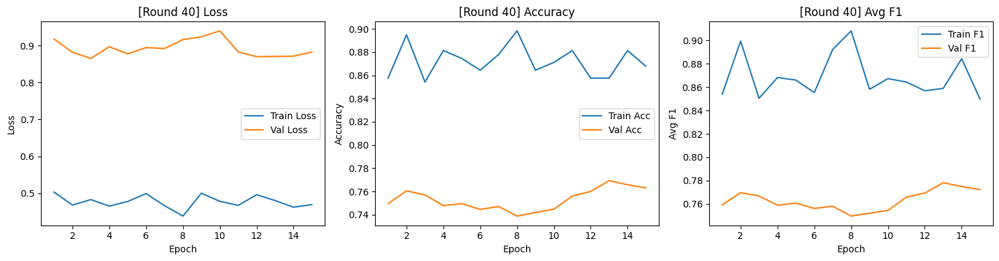

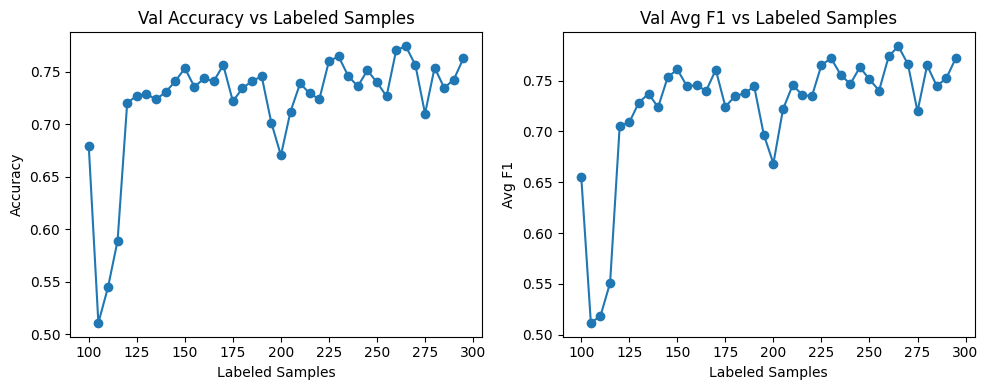

X_labeled shape: (300, 6, 28)
y_labeled shape: (300,)
X_unlabeled shape: (15700, 6, 28)
y_unlabeled shape: (15700,)

=== Running strategy: DIVERSITY ===

[AL Round 1/40] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.9028 | Acc: 0.5500 | Avg F1: 0.5397
Val   — Loss: 1.8078 | Acc: 0.6140 | Avg F1: 0.6018


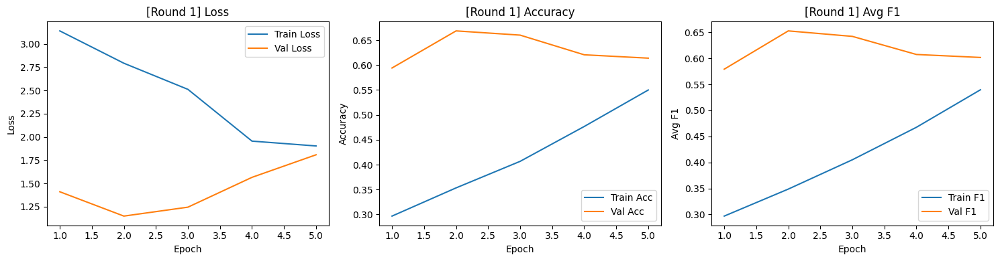


[AL Round 2/40] — Labeled samples: 305



Epoch 5/5
Train — Loss: 1.3173 | Acc: 0.6787 | Avg F1: 0.6583
Val   — Loss: 1.2753 | Acc: 0.7895 | Avg F1: 0.7747


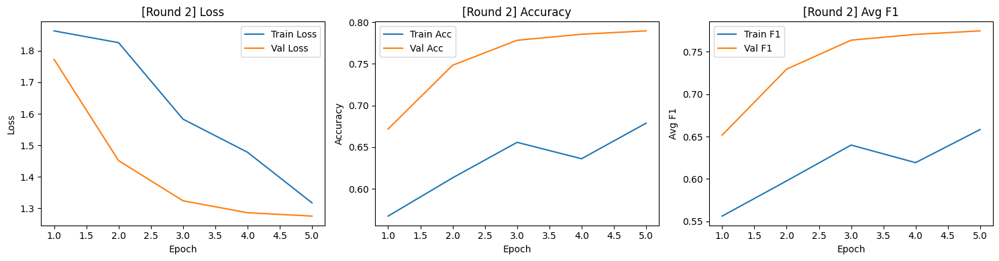


[AL Round 3/40] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.2244 | Acc: 0.6903 | Avg F1: 0.6732
Val   — Loss: 1.2251 | Acc: 0.7750 | Avg F1: 0.7590


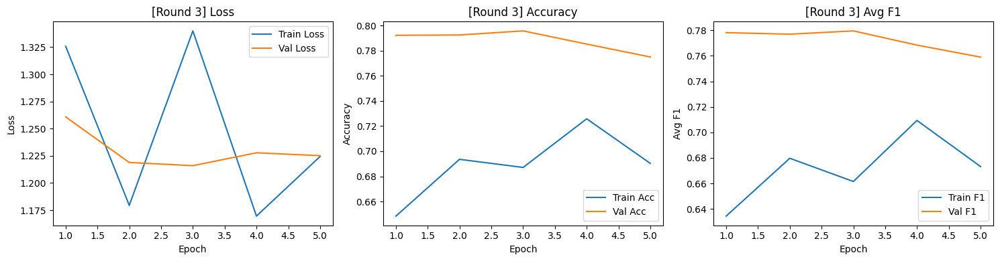


[AL Round 4/40] — Labeled samples: 315



Epoch 5/5
Train — Loss: 1.0666 | Acc: 0.7492 | Avg F1: 0.7522
Val   — Loss: 1.0410 | Acc: 0.8200 | Avg F1: 0.8124


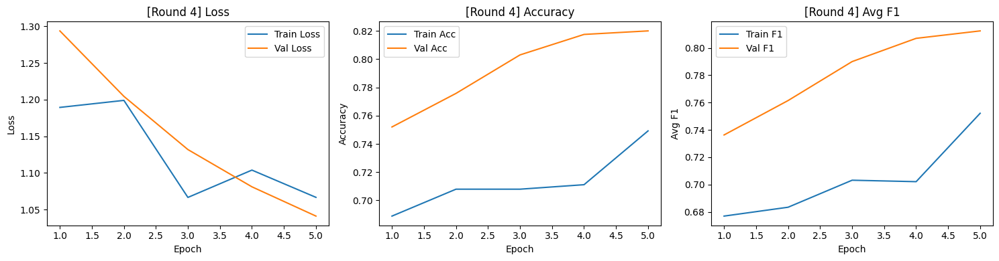


[AL Round 5/40] — Labeled samples: 320



Epoch 10/10
Train — Loss: 0.8536 | Acc: 0.7937 | Avg F1: 0.7934
Val   — Loss: 0.9572 | Acc: 0.8193 | Avg F1: 0.8185


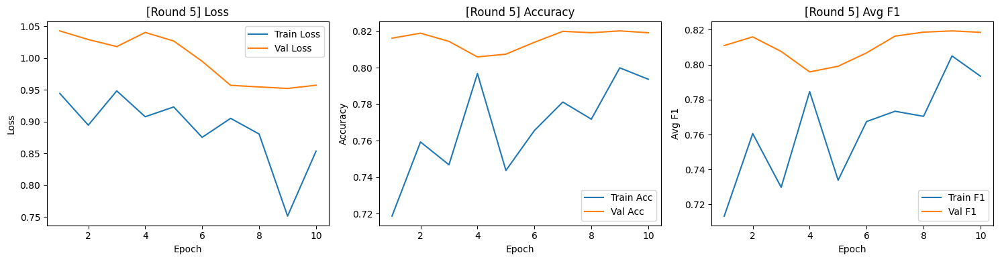


[AL Round 6/40] — Labeled samples: 325



Epoch 10/10
Train — Loss: 0.7902 | Acc: 0.7569 | Avg F1: 0.7650
Val   — Loss: 1.0232 | Acc: 0.7738 | Avg F1: 0.7783


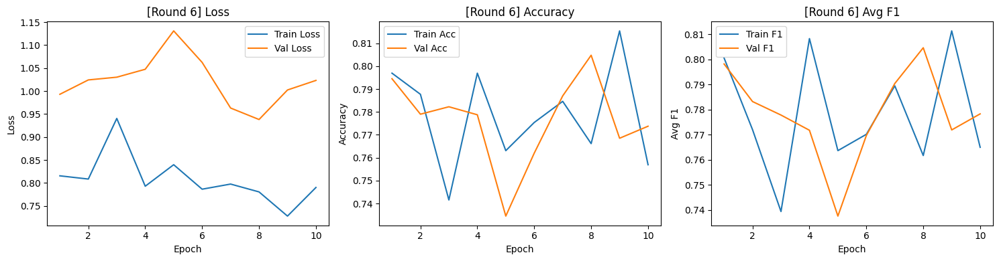


[AL Round 7/40] — Labeled samples: 330



Epoch 10/10
Train — Loss: 0.6908 | Acc: 0.8364 | Avg F1: 0.8399
Val   — Loss: 1.0536 | Acc: 0.7698 | Avg F1: 0.7788


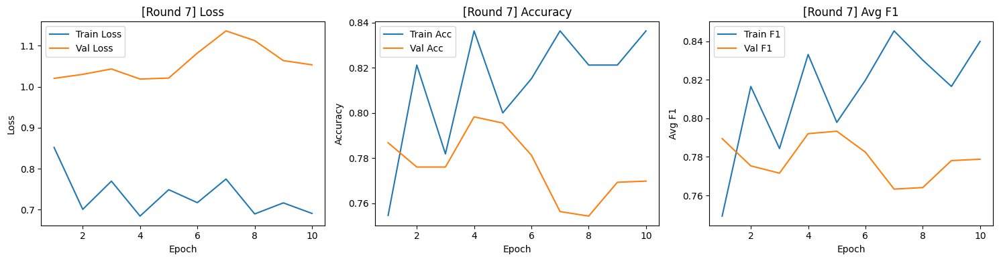


[AL Round 8/40] — Labeled samples: 335



Epoch 10/10
Train — Loss: 0.6315 | Acc: 0.8418 | Avg F1: 0.8417
Val   — Loss: 0.8496 | Acc: 0.8130 | Avg F1: 0.8167


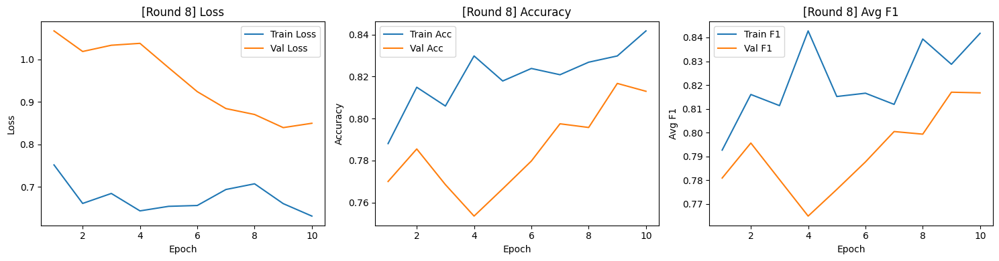


[AL Round 9/40] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.6109 | Acc: 0.8412 | Avg F1: 0.8394
Val   — Loss: 0.8231 | Acc: 0.8105 | Avg F1: 0.8135


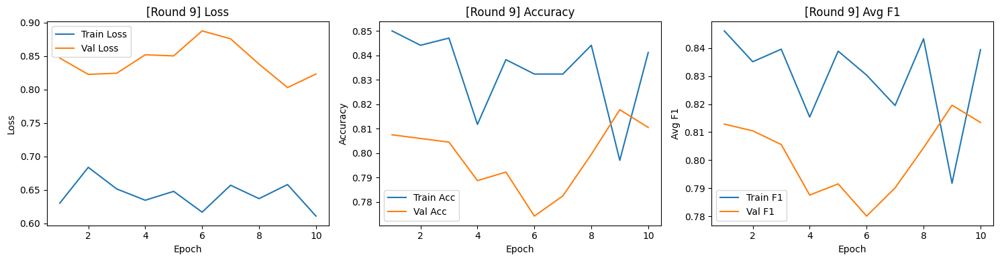


[AL Round 10/40] — Labeled samples: 345



Epoch 10/10
Train — Loss: 0.5920 | Acc: 0.8464 | Avg F1: 0.8378
Val   — Loss: 0.8109 | Acc: 0.8005 | Avg F1: 0.8058


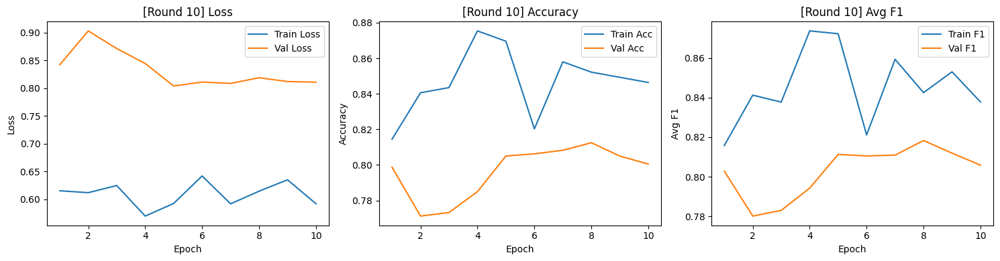


[AL Round 11/40] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.5961 | Acc: 0.8286 | Avg F1: 0.8333
Val   — Loss: 0.7867 | Acc: 0.8063 | Avg F1: 0.8071


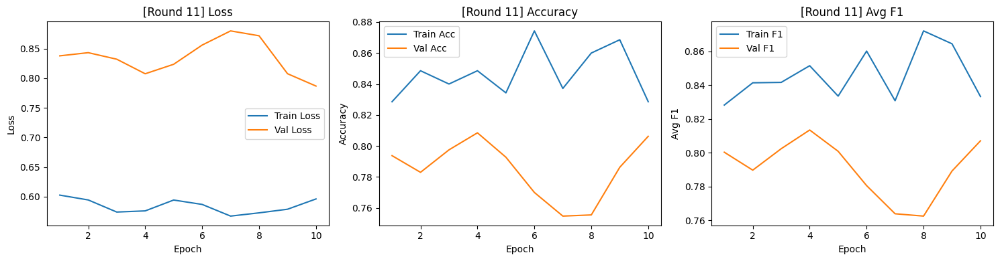


[AL Round 12/40] — Labeled samples: 355



Epoch 15/15
Train — Loss: 0.5291 | Acc: 0.8732 | Avg F1: 0.8747
Val   — Loss: 0.7540 | Acc: 0.8077 | Avg F1: 0.8099


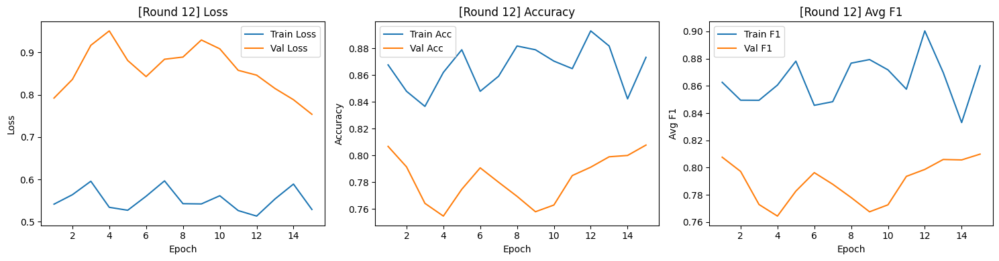


[AL Round 13/40] — Labeled samples: 360



Epoch 15/15
Train — Loss: 0.5232 | Acc: 0.8833 | Avg F1: 0.8932
Val   — Loss: 0.7930 | Acc: 0.7850 | Avg F1: 0.7901


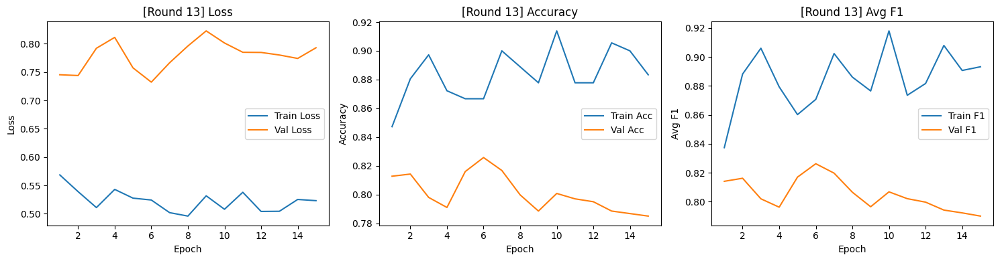


[AL Round 14/40] — Labeled samples: 365



Epoch 15/15
Train — Loss: 0.5562 | Acc: 0.8712 | Avg F1: 0.8720
Val   — Loss: 0.8067 | Acc: 0.7907 | Avg F1: 0.7988


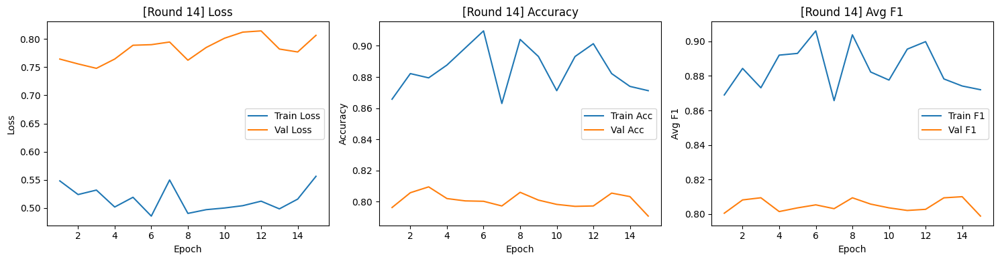


[AL Round 15/40] — Labeled samples: 370



Epoch 15/15
Train — Loss: 0.5241 | Acc: 0.8649 | Avg F1: 0.8689
Val   — Loss: 0.8022 | Acc: 0.7792 | Avg F1: 0.7874


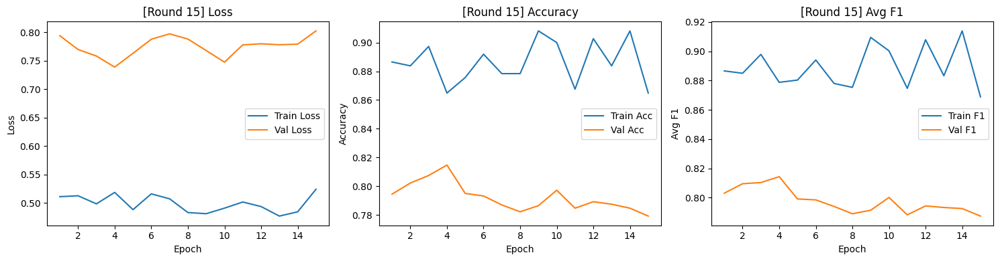


[AL Round 16/40] — Labeled samples: 375



Epoch 15/15
Train — Loss: 0.5087 | Acc: 0.8720 | Avg F1: 0.8747
Val   — Loss: 0.8242 | Acc: 0.7740 | Avg F1: 0.7839


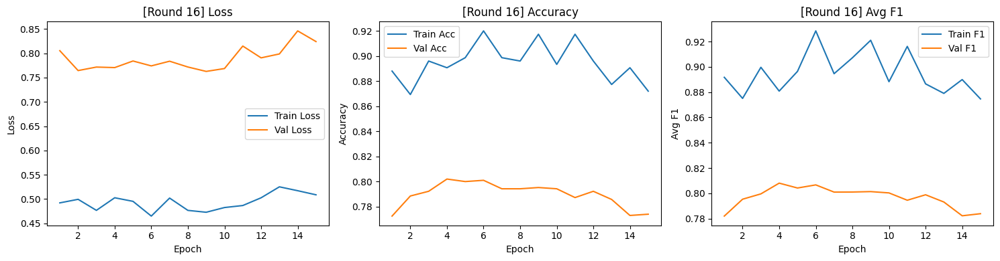


[AL Round 17/40] — Labeled samples: 380



Epoch 15/15
Train — Loss: 0.4854 | Acc: 0.9079 | Avg F1: 0.9049
Val   — Loss: 0.7920 | Acc: 0.7865 | Avg F1: 0.7925


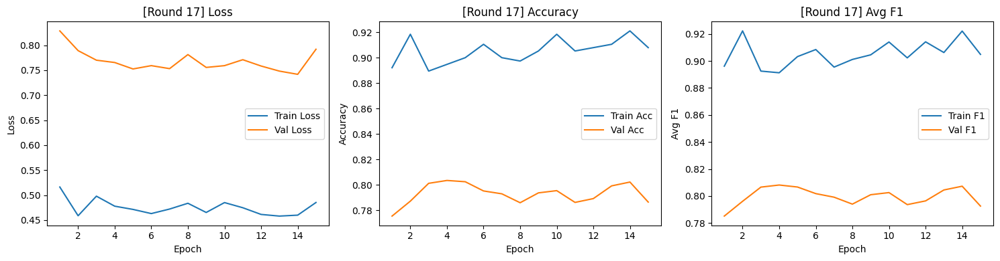


[AL Round 18/40] — Labeled samples: 385



Epoch 15/15
Train — Loss: 0.5054 | Acc: 0.8857 | Avg F1: 0.8792
Val   — Loss: 1.0413 | Acc: 0.7515 | Avg F1: 0.7628


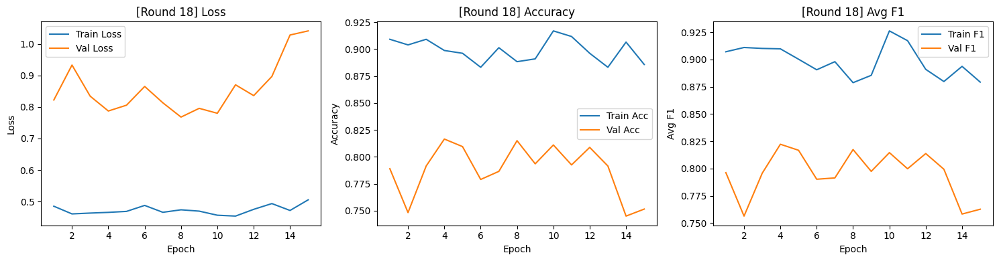


[AL Round 19/40] — Labeled samples: 390



Epoch 15/15
Train — Loss: 0.4572 | Acc: 0.9128 | Avg F1: 0.9208
Val   — Loss: 0.9195 | Acc: 0.7578 | Avg F1: 0.7707


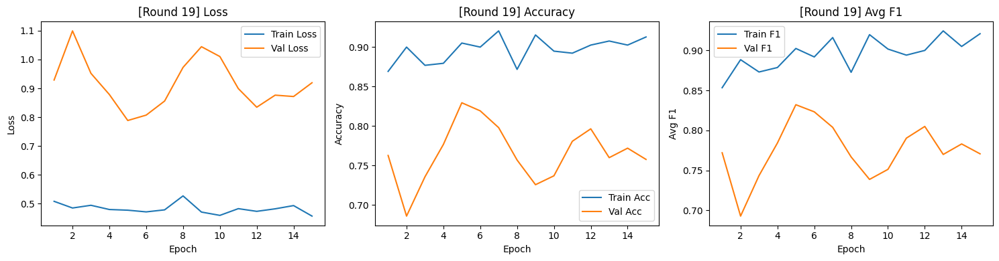


[AL Round 20/40] — Labeled samples: 395



Epoch 15/15
Train — Loss: 0.4698 | Acc: 0.8911 | Avg F1: 0.8943
Val   — Loss: 0.7729 | Acc: 0.8017 | Avg F1: 0.8111


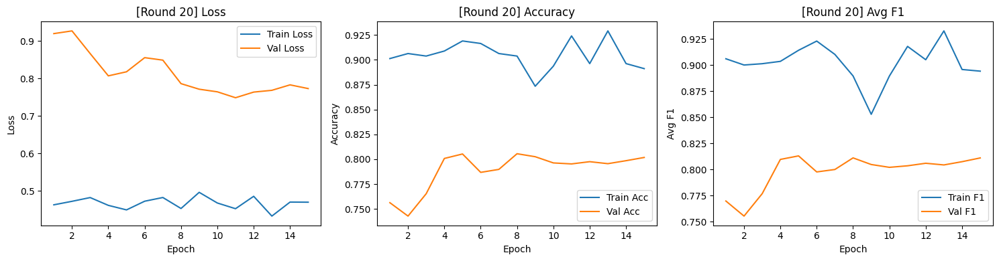


[AL Round 21/40] — Labeled samples: 400



Epoch 15/15
Train — Loss: 0.4504 | Acc: 0.9125 | Avg F1: 0.9231
Val   — Loss: 0.7924 | Acc: 0.7917 | Avg F1: 0.8016


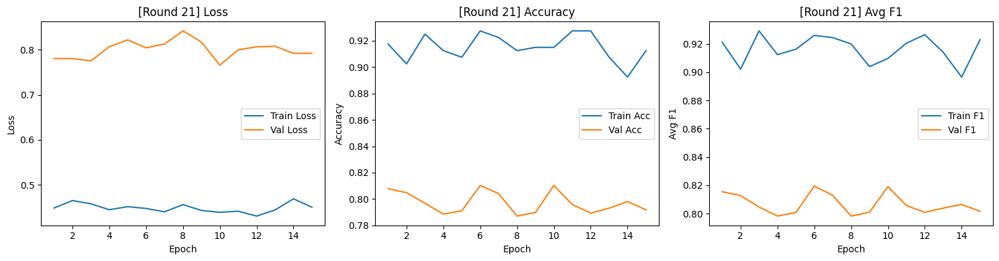


[AL Round 22/40] — Labeled samples: 405



Epoch 15/15
Train — Loss: 0.4336 | Acc: 0.9259 | Avg F1: 0.9305
Val   — Loss: 0.7933 | Acc: 0.8050 | Avg F1: 0.8132


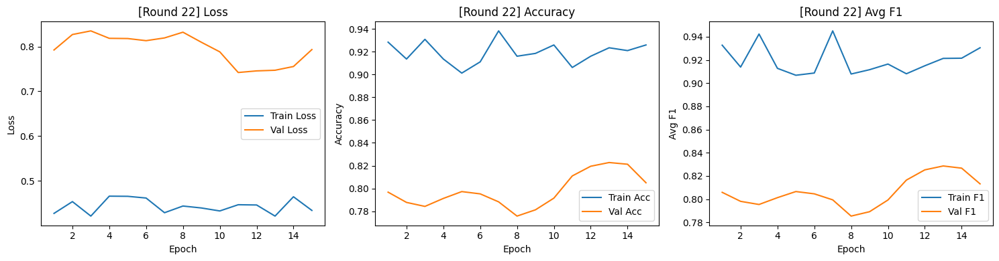


[AL Round 23/40] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.4346 | Acc: 0.9195 | Avg F1: 0.9230
Val   — Loss: 0.7662 | Acc: 0.8103 | Avg F1: 0.8167


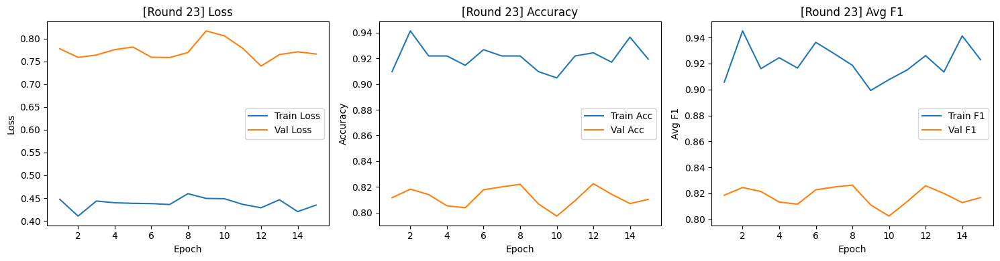


[AL Round 24/40] — Labeled samples: 415



Epoch 15/15
Train — Loss: 0.4385 | Acc: 0.9012 | Avg F1: 0.9034
Val   — Loss: 0.7776 | Acc: 0.8153 | Avg F1: 0.8222


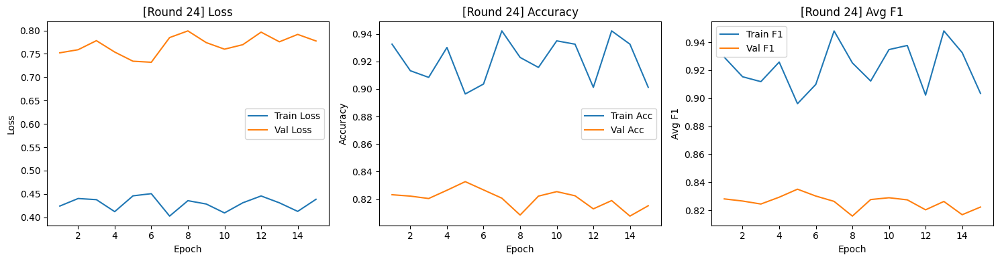


[AL Round 25/40] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.4348 | Acc: 0.9238 | Avg F1: 0.9268
Val   — Loss: 0.7593 | Acc: 0.8323 | Avg F1: 0.8363


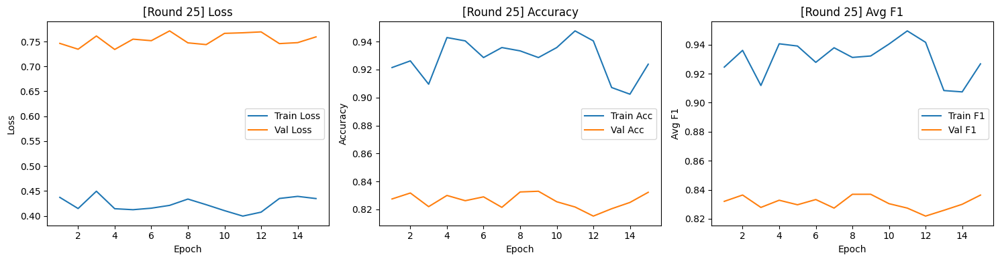


[AL Round 26/40] — Labeled samples: 425



Epoch 15/15
Train — Loss: 0.4321 | Acc: 0.9200 | Avg F1: 0.9166
Val   — Loss: 0.7417 | Acc: 0.8297 | Avg F1: 0.8324


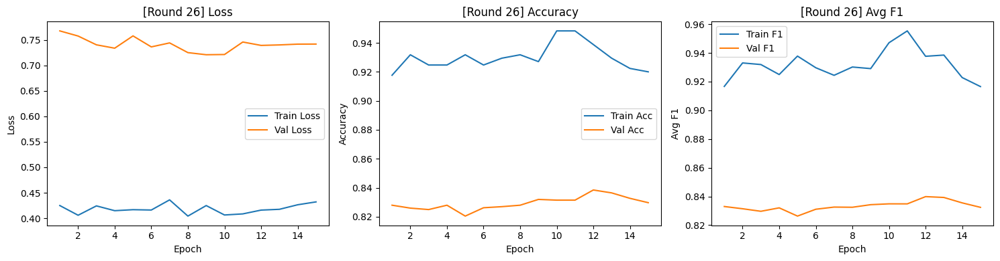


[AL Round 27/40] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.4025 | Acc: 0.9465 | Avg F1: 0.9438
Val   — Loss: 0.7699 | Acc: 0.8163 | Avg F1: 0.8225


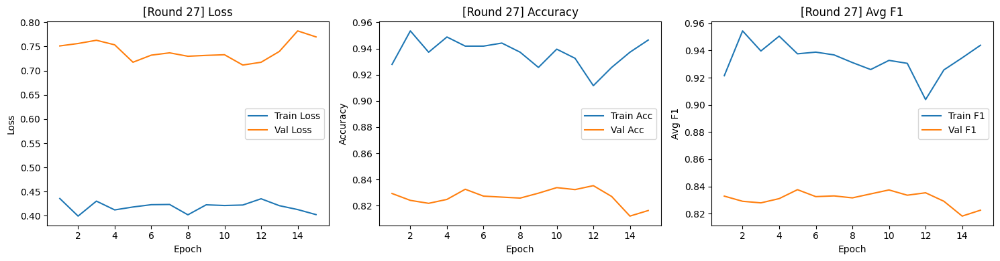


[AL Round 28/40] — Labeled samples: 435



Epoch 15/15
Train — Loss: 0.4126 | Acc: 0.9241 | Avg F1: 0.9217
Val   — Loss: 0.7740 | Acc: 0.8080 | Avg F1: 0.8155


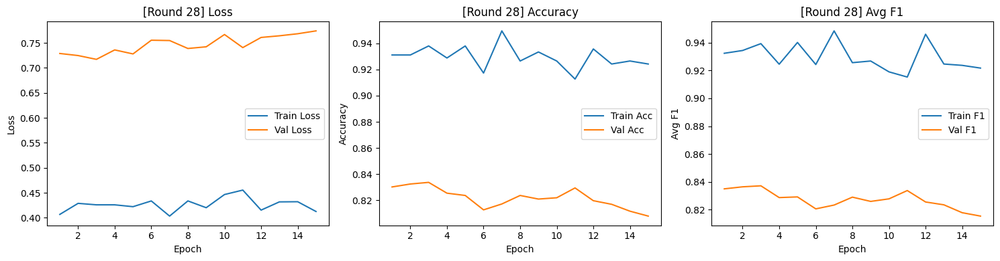


[AL Round 29/40] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.4130 | Acc: 0.9318 | Avg F1: 0.9357
Val   — Loss: 0.6959 | Acc: 0.8370 | Avg F1: 0.8407


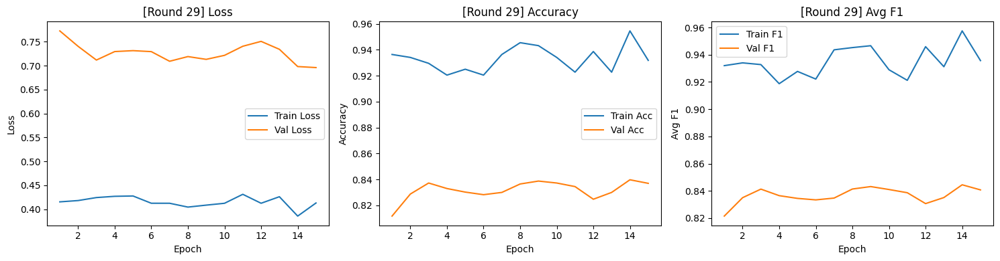


[AL Round 30/40] — Labeled samples: 445



Epoch 15/15
Train — Loss: 0.4072 | Acc: 0.9258 | Avg F1: 0.9264
Val   — Loss: 0.7040 | Acc: 0.8355 | Avg F1: 0.8385


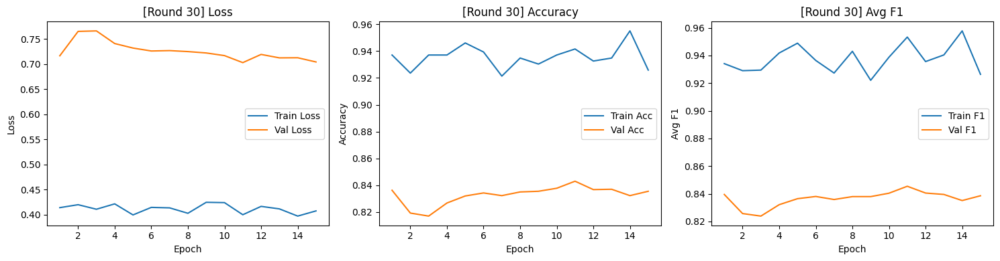


[AL Round 31/40] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.4676 | Acc: 0.8978 | Avg F1: 0.9093
Val   — Loss: 0.7602 | Acc: 0.8125 | Avg F1: 0.8125


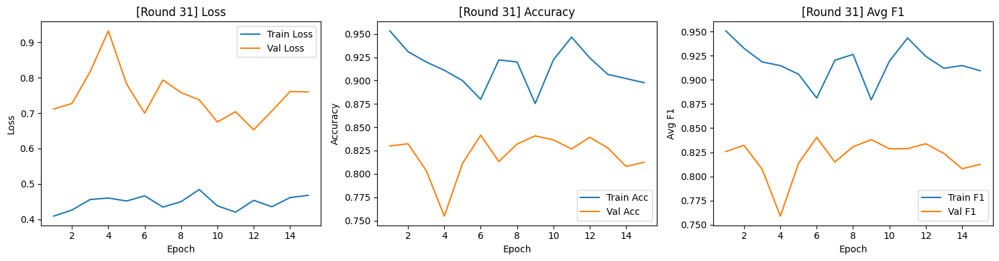


[AL Round 32/40] — Labeled samples: 455



Epoch 15/15
Train — Loss: 0.4305 | Acc: 0.9231 | Avg F1: 0.9267
Val   — Loss: 0.6836 | Acc: 0.8397 | Avg F1: 0.8364


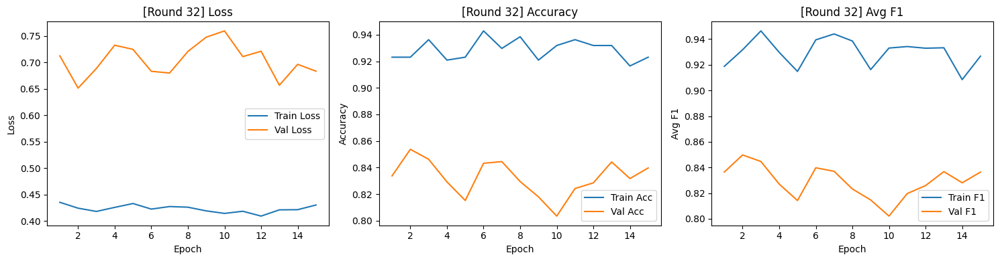


[AL Round 33/40] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.3992 | Acc: 0.9370 | Avg F1: 0.9367
Val   — Loss: 0.7449 | Acc: 0.8207 | Avg F1: 0.8228


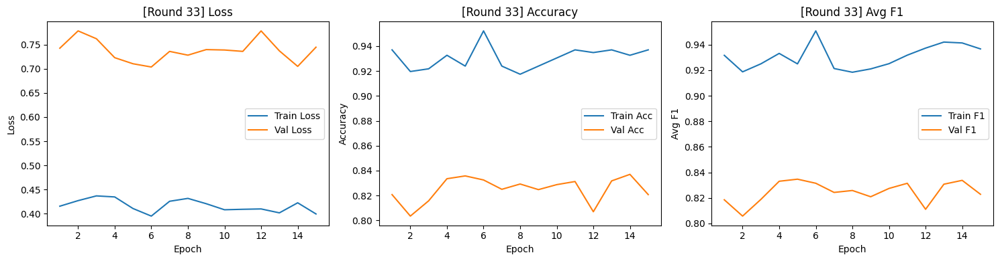


[AL Round 34/40] — Labeled samples: 465



Epoch 15/15
Train — Loss: 0.4219 | Acc: 0.9312 | Avg F1: 0.9186
Val   — Loss: 0.7145 | Acc: 0.8305 | Avg F1: 0.8261


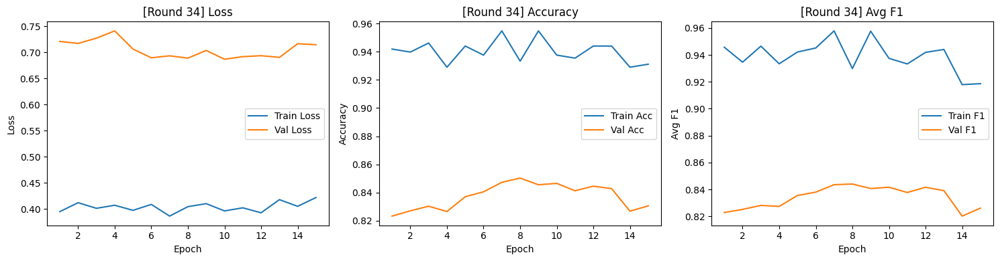


[AL Round 35/40] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.3878 | Acc: 0.9489 | Avg F1: 0.9460
Val   — Loss: 0.7218 | Acc: 0.8335 | Avg F1: 0.8320


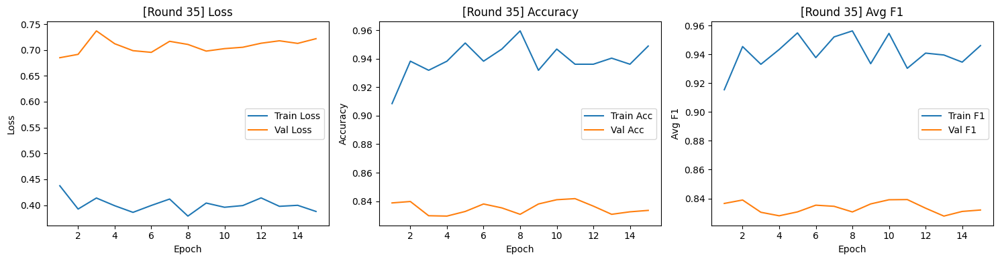


[AL Round 36/40] — Labeled samples: 475



Epoch 15/15
Train — Loss: 0.3982 | Acc: 0.9453 | Avg F1: 0.9456
Val   — Loss: 0.6880 | Acc: 0.8403 | Avg F1: 0.8361


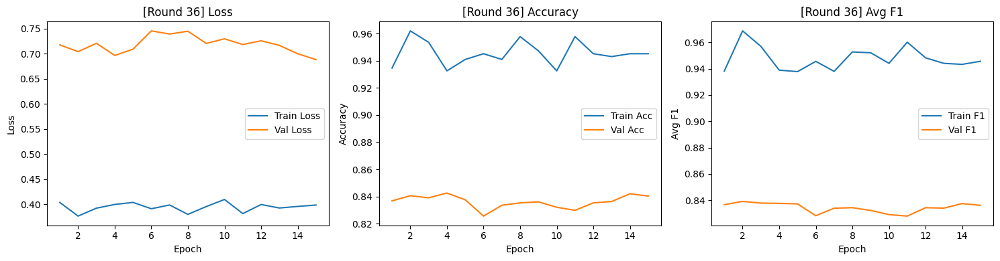


[AL Round 37/40] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.3843 | Acc: 0.9604 | Avg F1: 0.9598
Val   — Loss: 0.7172 | Acc: 0.8347 | Avg F1: 0.8343


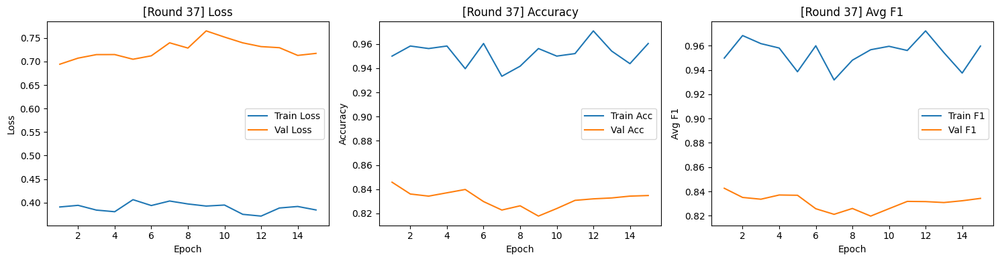


[AL Round 38/40] — Labeled samples: 485



Epoch 15/15
Train — Loss: 0.3764 | Acc: 0.9546 | Avg F1: 0.9580
Val   — Loss: 0.7086 | Acc: 0.8363 | Avg F1: 0.8348


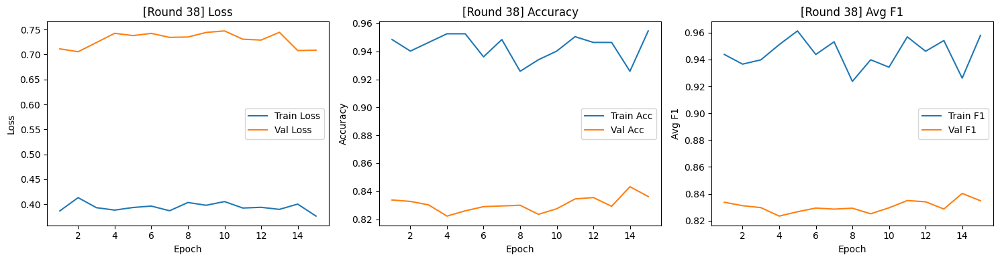


[AL Round 39/40] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.3797 | Acc: 0.9510 | Avg F1: 0.9555
Val   — Loss: 0.7055 | Acc: 0.8355 | Avg F1: 0.8339


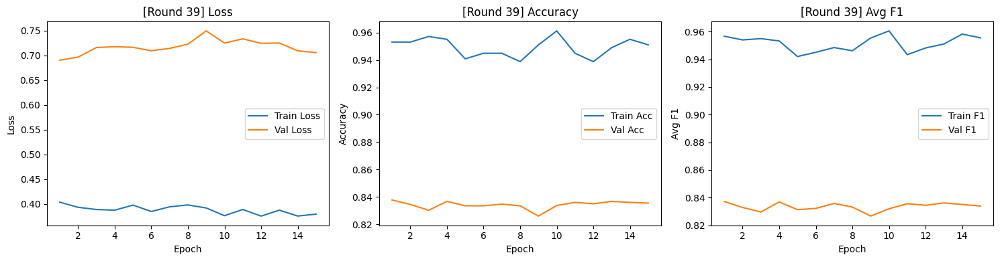


[AL Round 40/40] — Labeled samples: 495



Epoch 15/15
Train — Loss: 0.3815 | Acc: 0.9475 | Avg F1: 0.9470
Val   — Loss: 0.7157 | Acc: 0.8383 | Avg F1: 0.8380


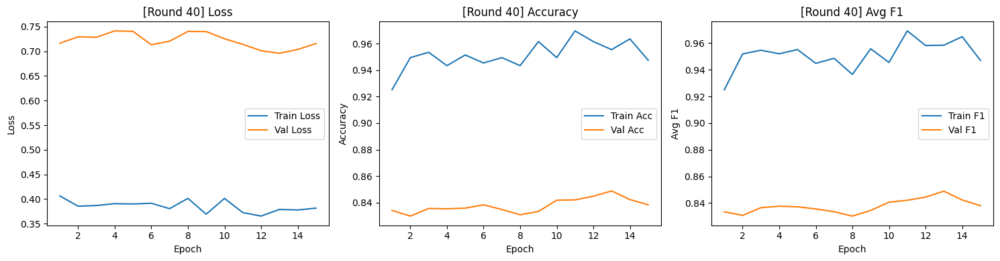

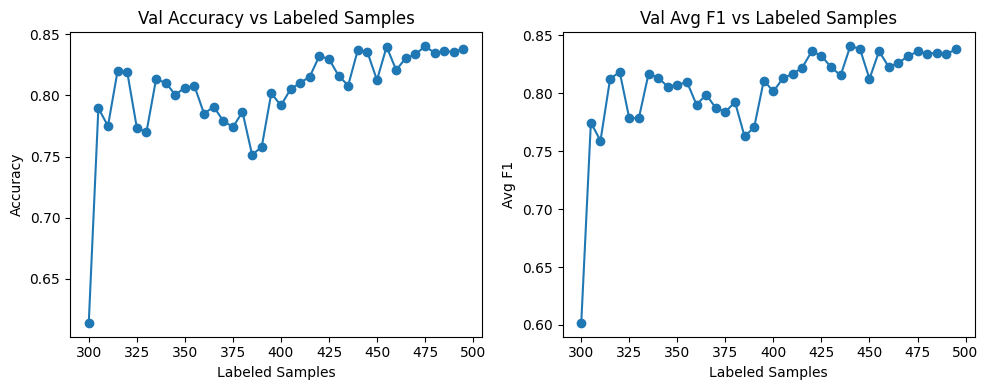


=== Running strategy: ENTROPY ===

[AL Round 1/40] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.8516 | Acc: 0.5567 | Avg F1: 0.5433
Val   — Loss: 1.7515 | Acc: 0.6873 | Avg F1: 0.6662


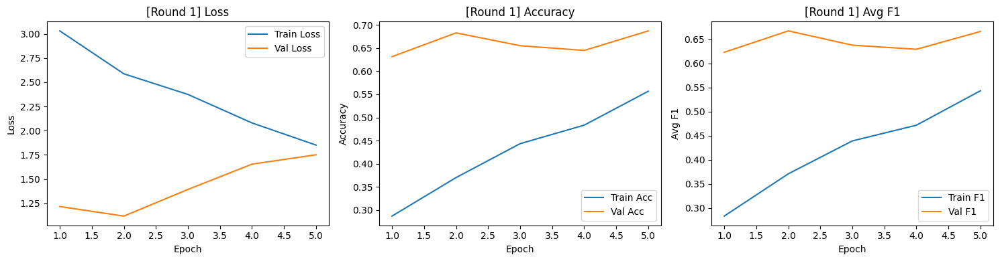


[AL Round 2/40] — Labeled samples: 305



Epoch 5/5
Train — Loss: 1.2963 | Acc: 0.6426 | Avg F1: 0.6255
Val   — Loss: 1.5221 | Acc: 0.7470 | Avg F1: 0.7244


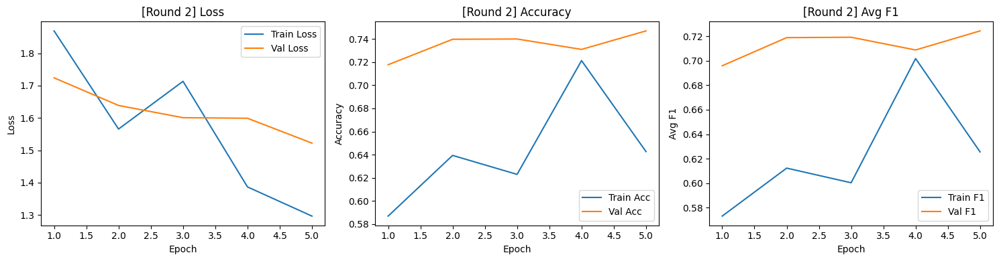


[AL Round 3/40] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.2352 | Acc: 0.6645 | Avg F1: 0.6496
Val   — Loss: 1.2936 | Acc: 0.8107 | Avg F1: 0.7975


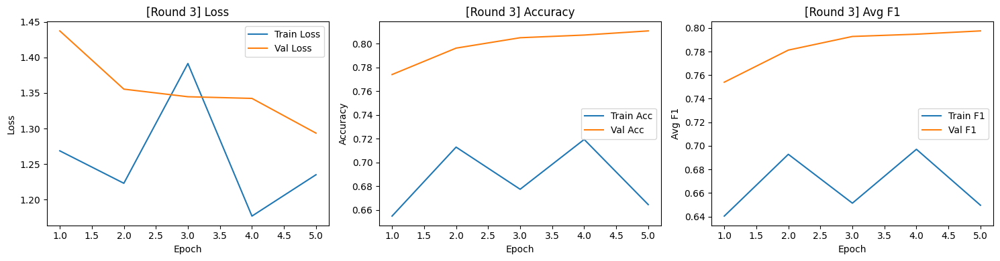


[AL Round 4/40] — Labeled samples: 315



Epoch 5/5
Train — Loss: 0.9818 | Acc: 0.7556 | Avg F1: 0.7384
Val   — Loss: 1.2217 | Acc: 0.7722 | Avg F1: 0.7550


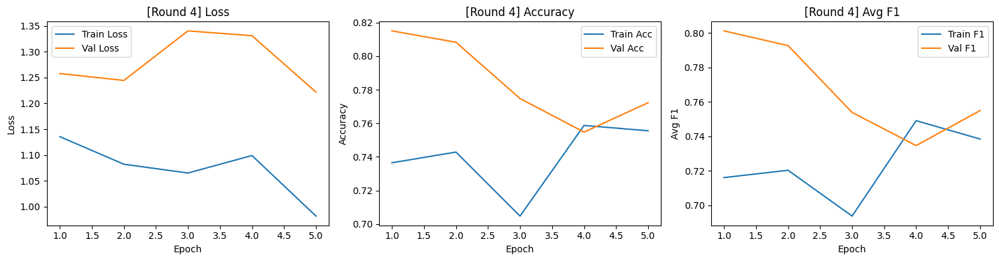


[AL Round 5/40] — Labeled samples: 320



Epoch 10/10
Train — Loss: 0.8178 | Acc: 0.7812 | Avg F1: 0.7846
Val   — Loss: 0.9609 | Acc: 0.8197 | Avg F1: 0.8126


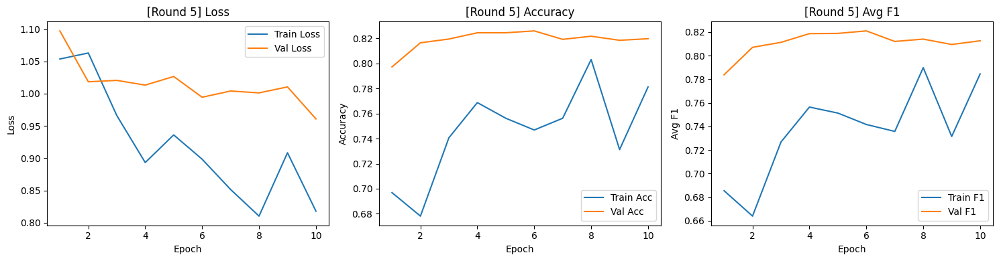


[AL Round 6/40] — Labeled samples: 325



Epoch 10/10
Train — Loss: 0.8524 | Acc: 0.7600 | Avg F1: 0.7693
Val   — Loss: 1.0889 | Acc: 0.7990 | Avg F1: 0.7825


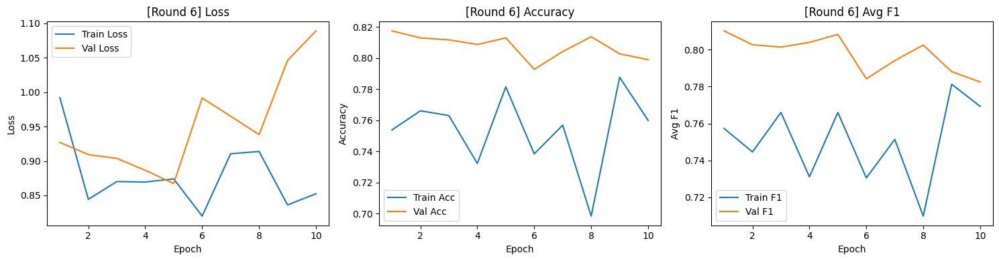


[AL Round 7/40] — Labeled samples: 330



Epoch 10/10
Train — Loss: 0.7760 | Acc: 0.7455 | Avg F1: 0.7466
Val   — Loss: 0.9029 | Acc: 0.7877 | Avg F1: 0.7721


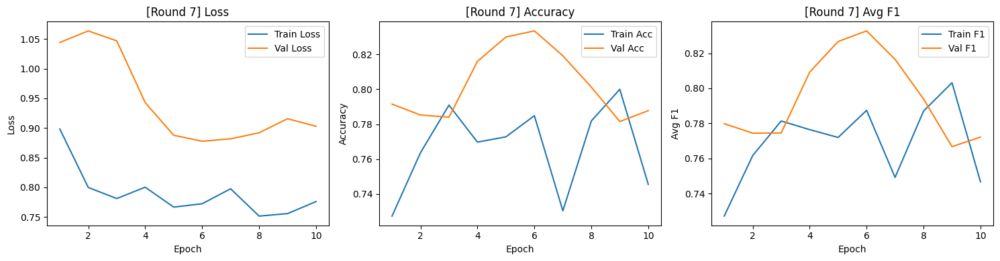


[AL Round 8/40] — Labeled samples: 335



Epoch 10/10
Train — Loss: 0.6736 | Acc: 0.8119 | Avg F1: 0.8095
Val   — Loss: 0.8382 | Acc: 0.8173 | Avg F1: 0.8185


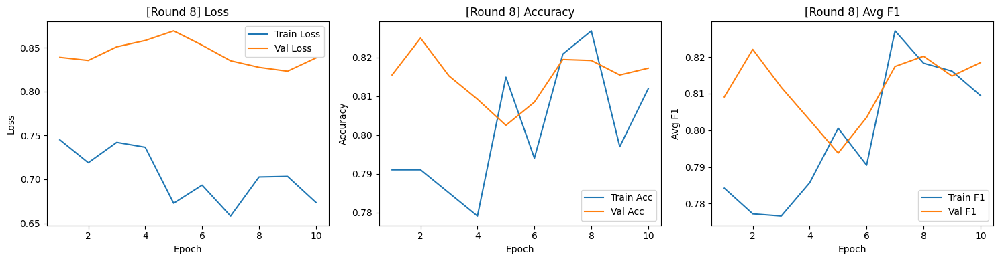


[AL Round 9/40] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.6922 | Acc: 0.8029 | Avg F1: 0.8082
Val   — Loss: 0.8316 | Acc: 0.8285 | Avg F1: 0.8354


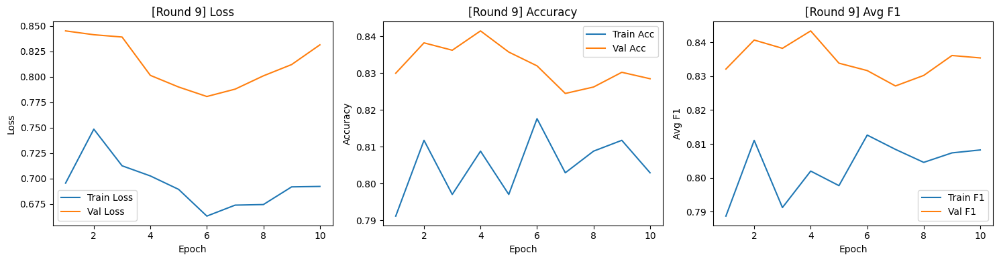


[AL Round 10/40] — Labeled samples: 345



Epoch 10/10
Train — Loss: 0.6754 | Acc: 0.8029 | Avg F1: 0.7972
Val   — Loss: 0.8123 | Acc: 0.8145 | Avg F1: 0.8230


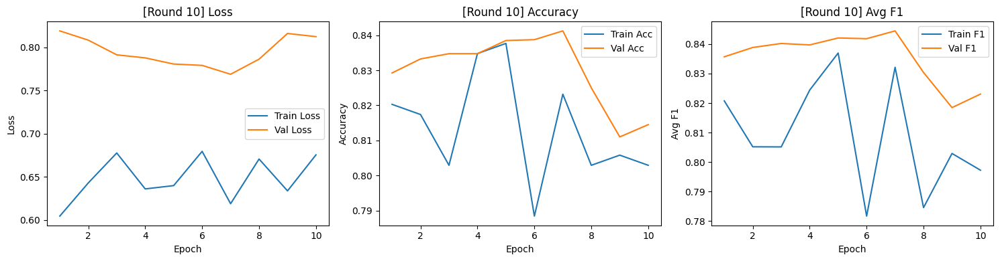


[AL Round 11/40] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.6446 | Acc: 0.8257 | Avg F1: 0.8163
Val   — Loss: 0.7686 | Acc: 0.8270 | Avg F1: 0.8323


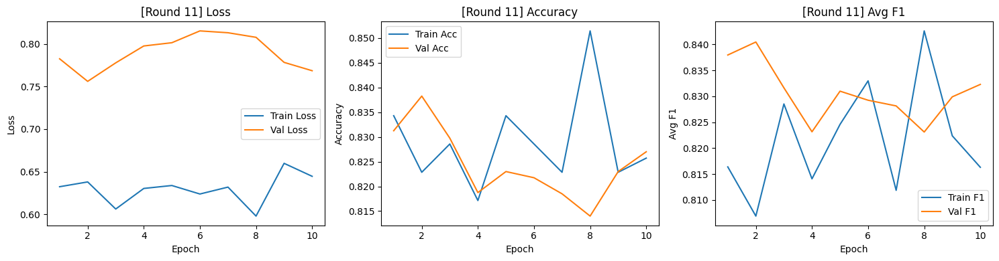


[AL Round 12/40] — Labeled samples: 355



Epoch 15/15
Train — Loss: 0.5967 | Acc: 0.8338 | Avg F1: 0.8307
Val   — Loss: 0.8004 | Acc: 0.8243 | Avg F1: 0.8312


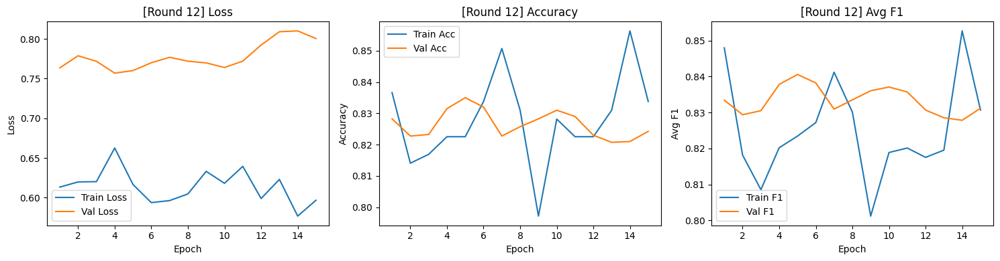


[AL Round 13/40] — Labeled samples: 360



Epoch 15/15
Train — Loss: 0.6197 | Acc: 0.8306 | Avg F1: 0.8197
Val   — Loss: 0.7862 | Acc: 0.8263 | Avg F1: 0.8330


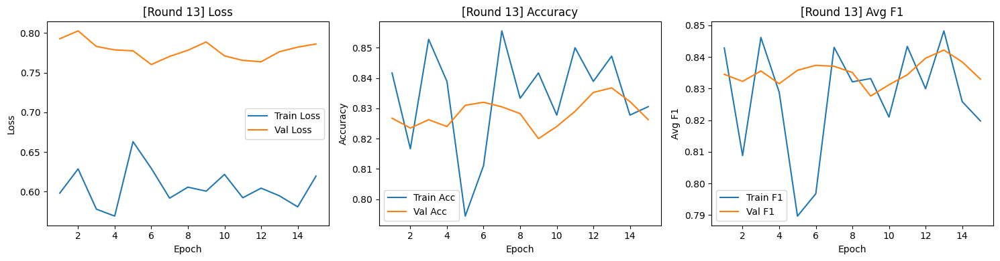


[AL Round 14/40] — Labeled samples: 365



Epoch 15/15
Train — Loss: 0.5858 | Acc: 0.8493 | Avg F1: 0.8547
Val   — Loss: 0.8133 | Acc: 0.8155 | Avg F1: 0.8255


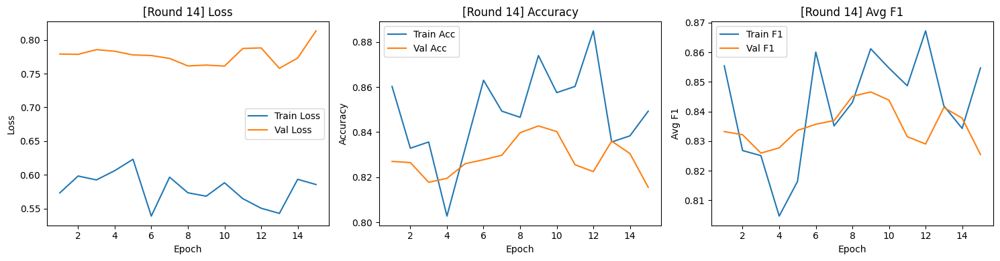


[AL Round 15/40] — Labeled samples: 370



Epoch 15/15
Train — Loss: 0.5646 | Acc: 0.8595 | Avg F1: 0.8535
Val   — Loss: 0.7758 | Acc: 0.8313 | Avg F1: 0.8395


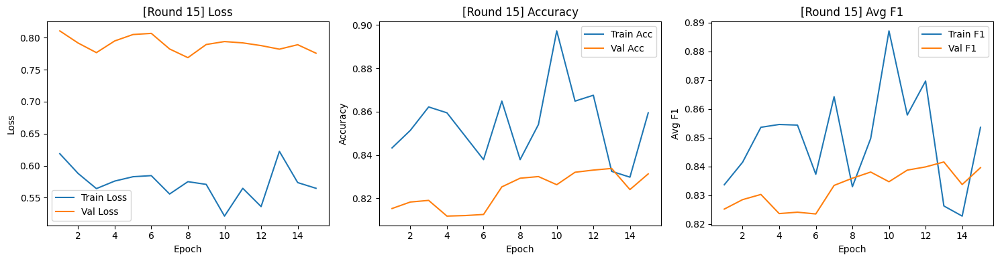


[AL Round 16/40] — Labeled samples: 375



Epoch 15/15
Train — Loss: 0.5685 | Acc: 0.8507 | Avg F1: 0.8429
Val   — Loss: 0.7545 | Acc: 0.8335 | Avg F1: 0.8406


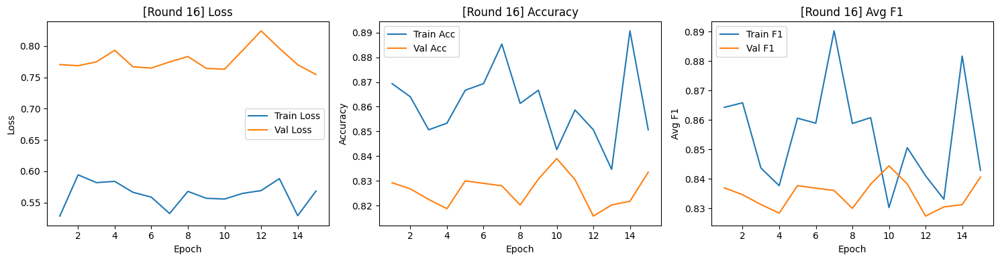


[AL Round 17/40] — Labeled samples: 380



Epoch 15/15
Train — Loss: 0.5571 | Acc: 0.8605 | Avg F1: 0.8594
Val   — Loss: 0.7998 | Acc: 0.8253 | Avg F1: 0.8333


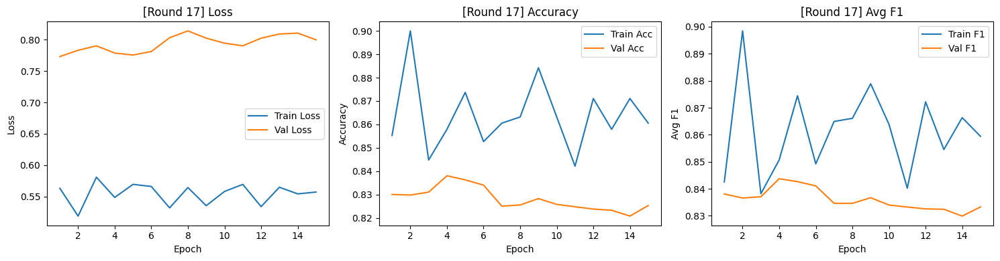


[AL Round 18/40] — Labeled samples: 385



Epoch 15/15
Train — Loss: 0.5542 | Acc: 0.8545 | Avg F1: 0.8493
Val   — Loss: 0.9094 | Acc: 0.7953 | Avg F1: 0.8072


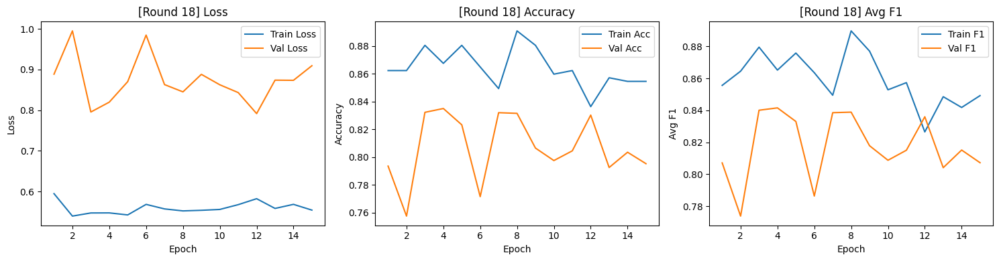


[AL Round 19/40] — Labeled samples: 390



Epoch 15/15
Train — Loss: 0.5762 | Acc: 0.8667 | Avg F1: 0.8575
Val   — Loss: 0.7343 | Acc: 0.8470 | Avg F1: 0.8513


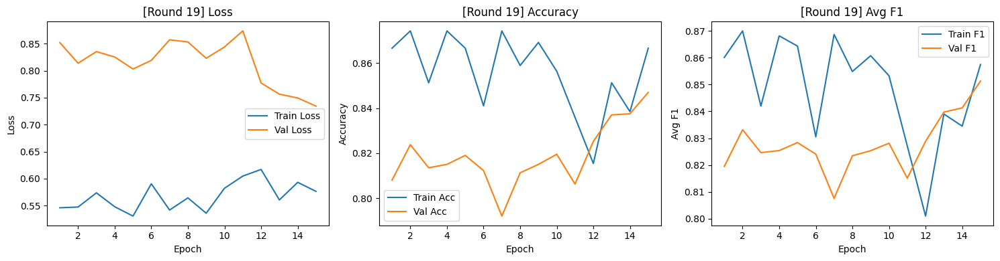


[AL Round 20/40] — Labeled samples: 395



Epoch 15/15
Train — Loss: 0.5533 | Acc: 0.8709 | Avg F1: 0.8634
Val   — Loss: 0.7490 | Acc: 0.8433 | Avg F1: 0.8472


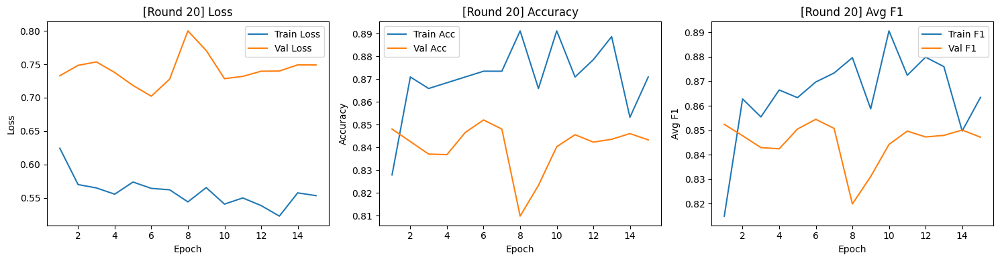


[AL Round 21/40] — Labeled samples: 400



Epoch 15/15
Train — Loss: 0.5544 | Acc: 0.8600 | Avg F1: 0.8610
Val   — Loss: 0.7233 | Acc: 0.8478 | Avg F1: 0.8499


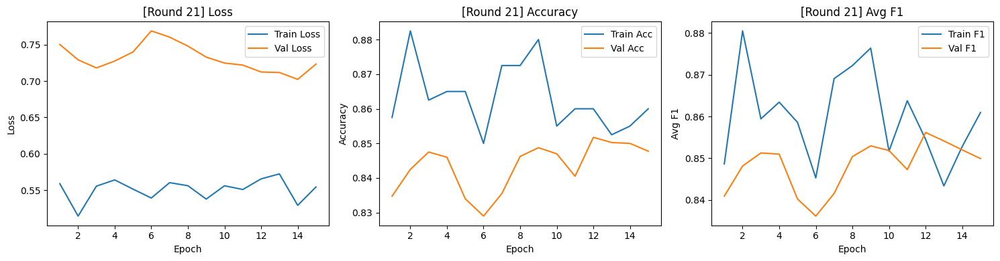


[AL Round 22/40] — Labeled samples: 405



Epoch 15/15
Train — Loss: 0.5342 | Acc: 0.8741 | Avg F1: 0.8743
Val   — Loss: 0.7490 | Acc: 0.8452 | Avg F1: 0.8472


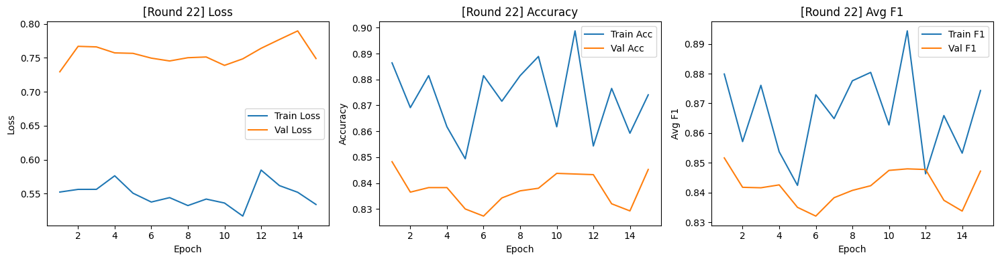


[AL Round 23/40] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.5523 | Acc: 0.8610 | Avg F1: 0.8556
Val   — Loss: 0.7407 | Acc: 0.8462 | Avg F1: 0.8496


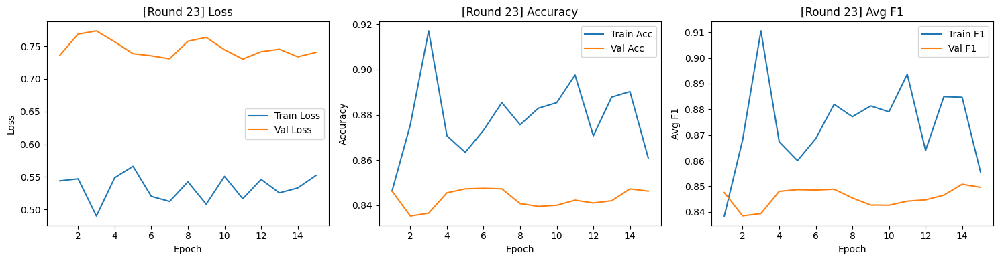


[AL Round 24/40] — Labeled samples: 415



Epoch 15/15
Train — Loss: 0.5166 | Acc: 0.9036 | Avg F1: 0.9009
Val   — Loss: 0.7553 | Acc: 0.8480 | Avg F1: 0.8498


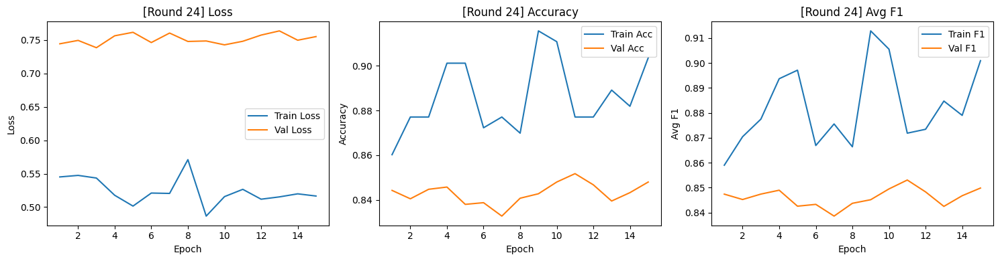


[AL Round 25/40] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5199 | Acc: 0.8881 | Avg F1: 0.8836
Val   — Loss: 0.7541 | Acc: 0.8353 | Avg F1: 0.8381


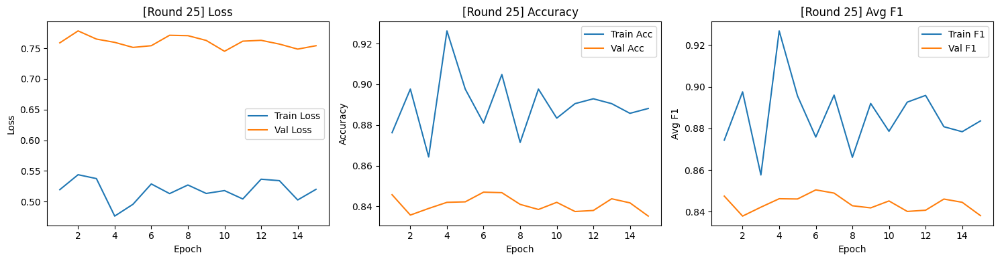


[AL Round 26/40] — Labeled samples: 425



Epoch 15/15
Train — Loss: 0.5075 | Acc: 0.9059 | Avg F1: 0.8984
Val   — Loss: 0.7736 | Acc: 0.8315 | Avg F1: 0.8348


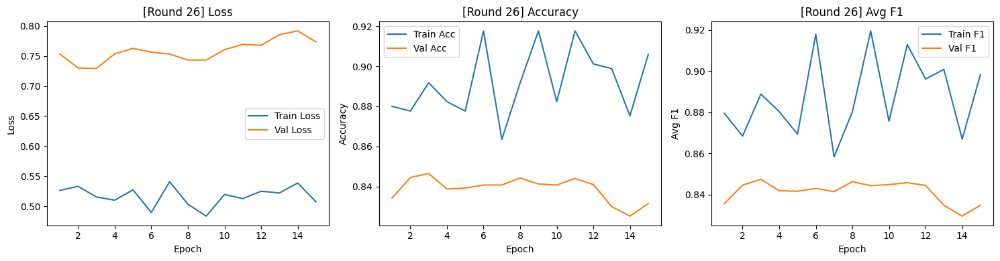


[AL Round 27/40] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.5064 | Acc: 0.8977 | Avg F1: 0.9008
Val   — Loss: 0.7648 | Acc: 0.8370 | Avg F1: 0.8422


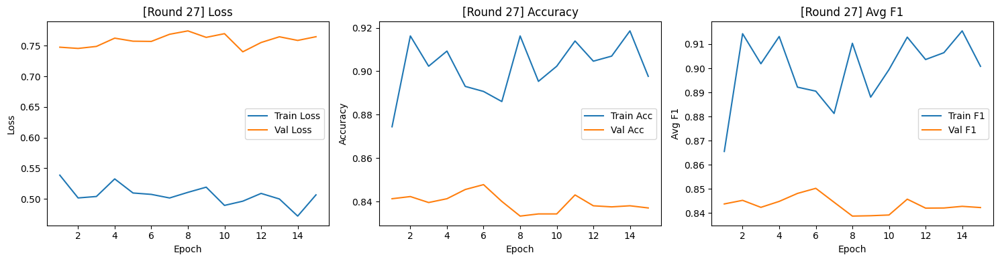


[AL Round 28/40] — Labeled samples: 435



Epoch 15/15
Train — Loss: 0.4948 | Acc: 0.9057 | Avg F1: 0.9031
Val   — Loss: 0.7519 | Acc: 0.8420 | Avg F1: 0.8431


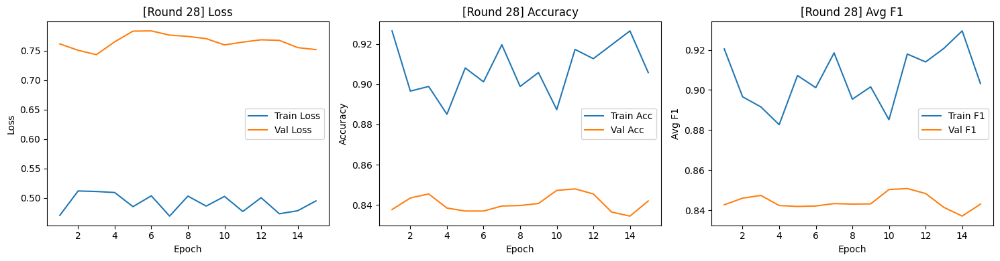


[AL Round 29/40] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.4889 | Acc: 0.8955 | Avg F1: 0.8929
Val   — Loss: 0.7557 | Acc: 0.8492 | Avg F1: 0.8507


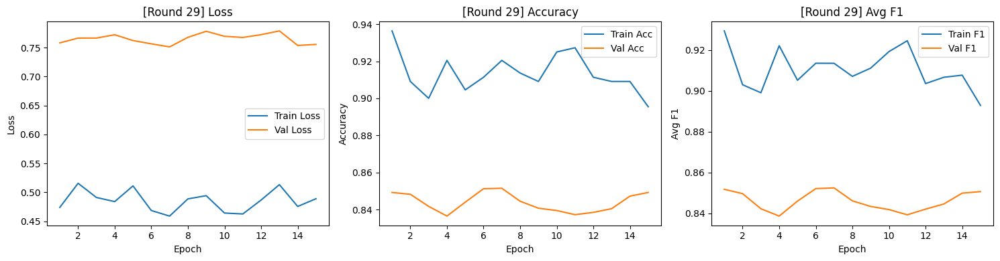


[AL Round 30/40] — Labeled samples: 445



Epoch 15/15
Train — Loss: 0.4572 | Acc: 0.9236 | Avg F1: 0.9170
Val   — Loss: 0.7878 | Acc: 0.8357 | Avg F1: 0.8402


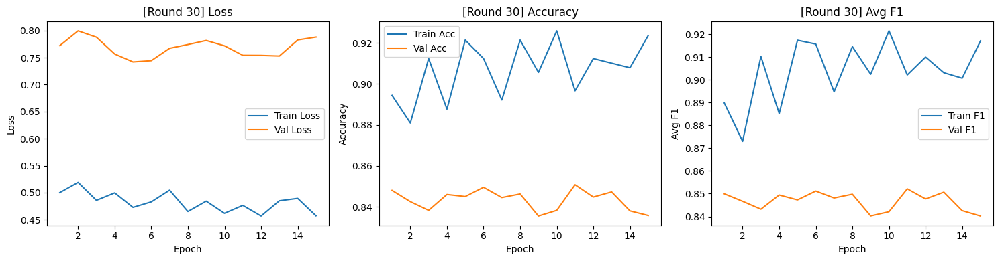


[AL Round 31/40] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.5452 | Acc: 0.8733 | Avg F1: 0.8737
Val   — Loss: 0.8835 | Acc: 0.8103 | Avg F1: 0.8209


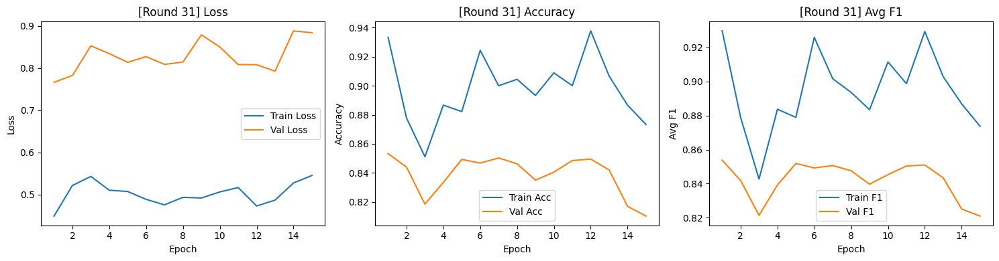


[AL Round 32/40] — Labeled samples: 455



Epoch 15/15
Train — Loss: 0.4690 | Acc: 0.9187 | Avg F1: 0.9116
Val   — Loss: 0.7673 | Acc: 0.8442 | Avg F1: 0.8470


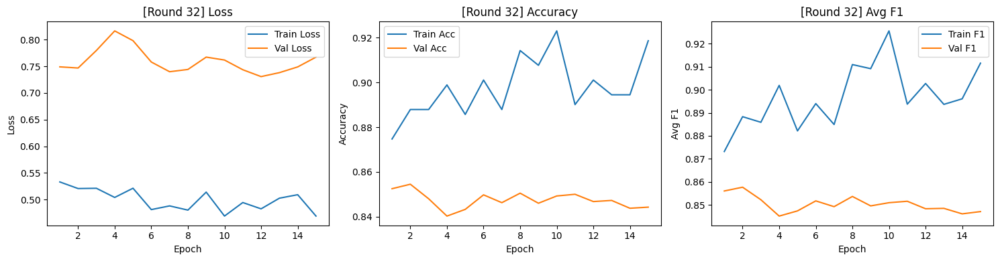


[AL Round 33/40] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.4905 | Acc: 0.9065 | Avg F1: 0.8989
Val   — Loss: 0.7696 | Acc: 0.8475 | Avg F1: 0.8493


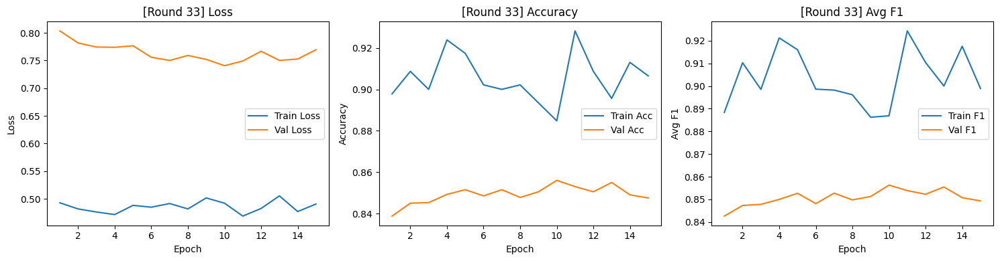


[AL Round 34/40] — Labeled samples: 465



Epoch 15/15
Train — Loss: 0.4560 | Acc: 0.9290 | Avg F1: 0.9293
Val   — Loss: 0.7798 | Acc: 0.8468 | Avg F1: 0.8481


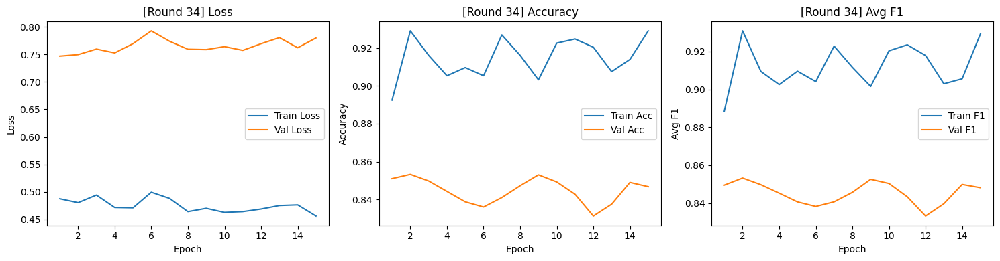


[AL Round 35/40] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.4615 | Acc: 0.9234 | Avg F1: 0.9217
Val   — Loss: 0.7947 | Acc: 0.8433 | Avg F1: 0.8452


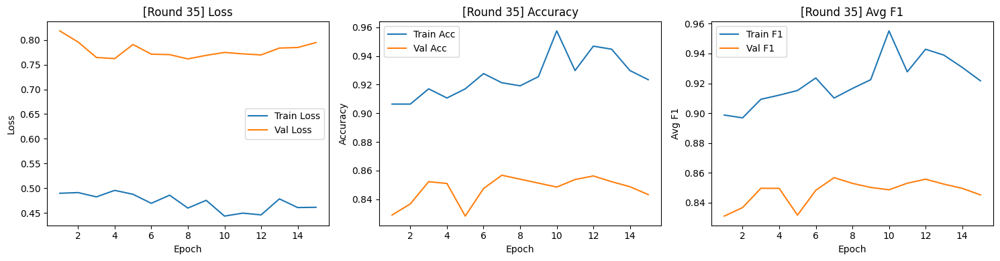


[AL Round 36/40] — Labeled samples: 475



Epoch 15/15
Train — Loss: 0.4483 | Acc: 0.9389 | Avg F1: 0.9366
Val   — Loss: 0.7498 | Acc: 0.8582 | Avg F1: 0.8594


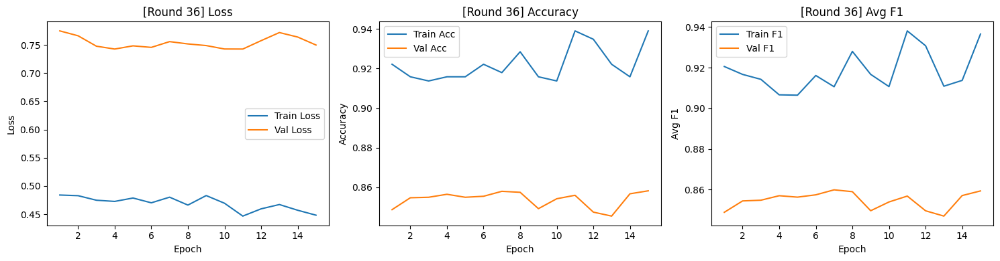


[AL Round 37/40] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.4661 | Acc: 0.9313 | Avg F1: 0.9265
Val   — Loss: 0.7703 | Acc: 0.8542 | Avg F1: 0.8552


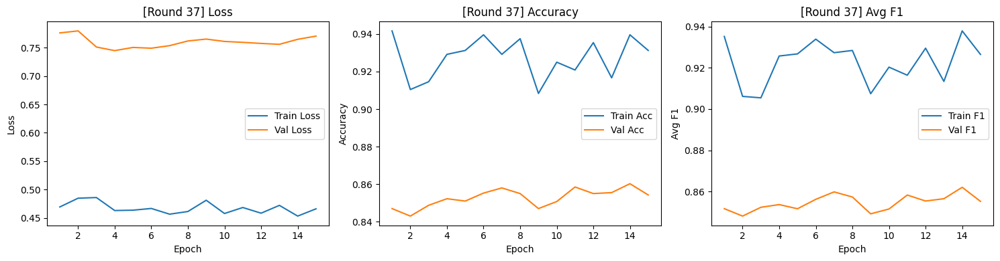


[AL Round 38/40] — Labeled samples: 485



Epoch 15/15
Train — Loss: 0.4447 | Acc: 0.9567 | Avg F1: 0.9541
Val   — Loss: 0.7722 | Acc: 0.8528 | Avg F1: 0.8554


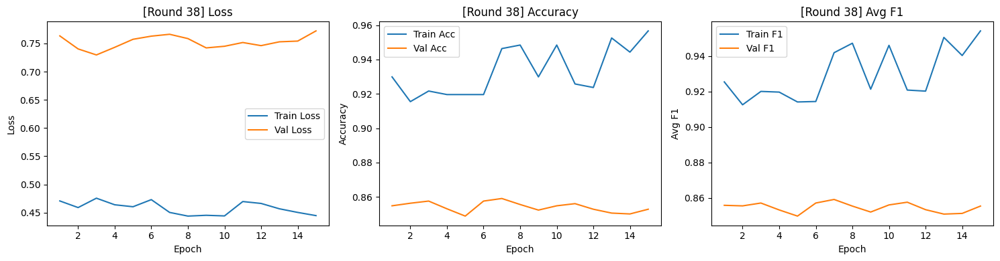


[AL Round 39/40] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.4286 | Acc: 0.9449 | Avg F1: 0.9458
Val   — Loss: 0.7593 | Acc: 0.8502 | Avg F1: 0.8517


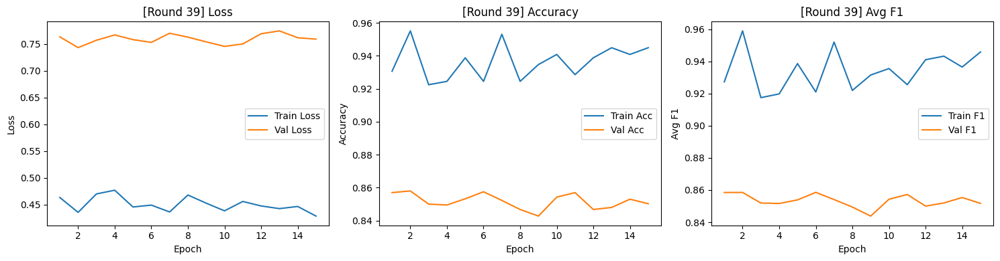


[AL Round 40/40] — Labeled samples: 495



Epoch 15/15
Train — Loss: 0.4366 | Acc: 0.9515 | Avg F1: 0.9477
Val   — Loss: 0.7514 | Acc: 0.8520 | Avg F1: 0.8537


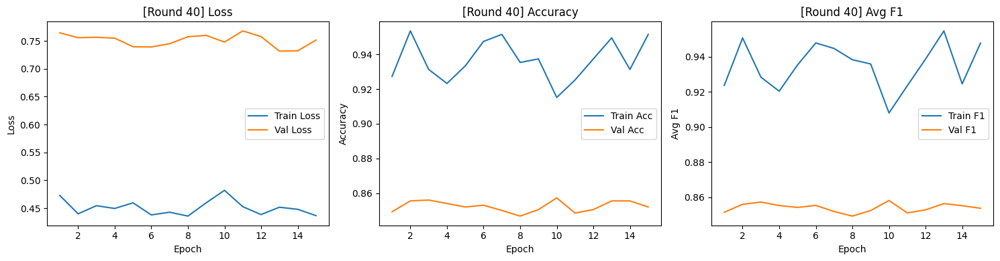

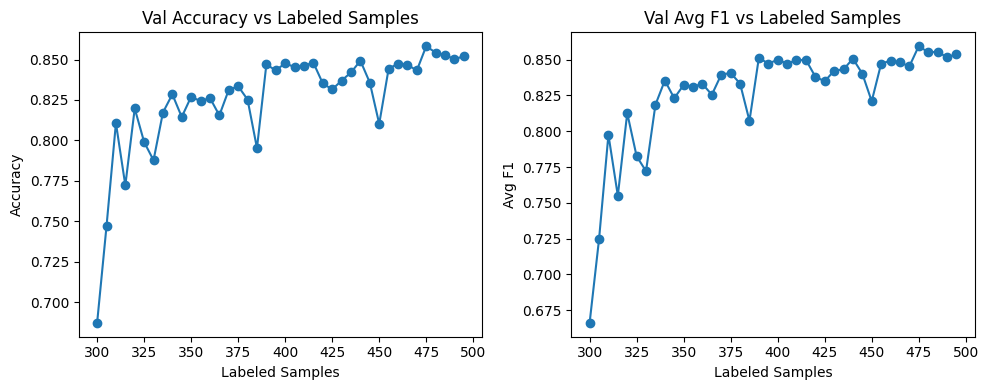


=== Running strategy: ENTROPY_DIVERSITY ===

[AL Round 1/40] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.9080 | Acc: 0.5200 | Avg F1: 0.5073
Val   — Loss: 2.1272 | Acc: 0.5510 | Avg F1: 0.5366


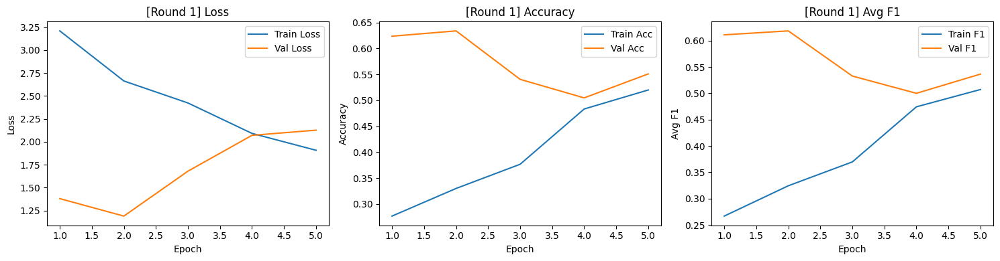


[AL Round 2/40] — Labeled samples: 305



Epoch 5/5
Train — Loss: 1.4832 | Acc: 0.6590 | Avg F1: 0.6374
Val   — Loss: 1.6552 | Acc: 0.7375 | Avg F1: 0.7150


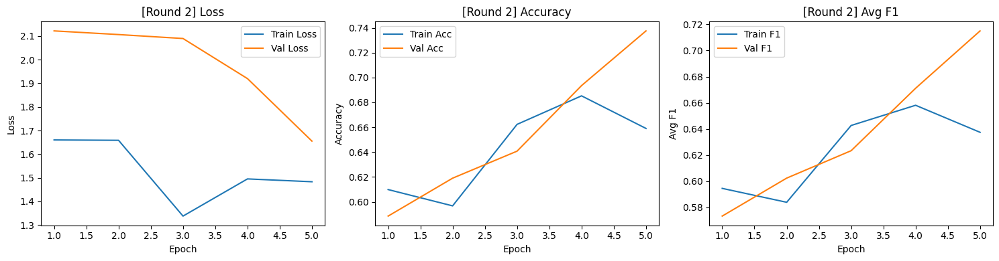


[AL Round 3/40] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.0674 | Acc: 0.7194 | Avg F1: 0.6981
Val   — Loss: 1.2727 | Acc: 0.7802 | Avg F1: 0.7700


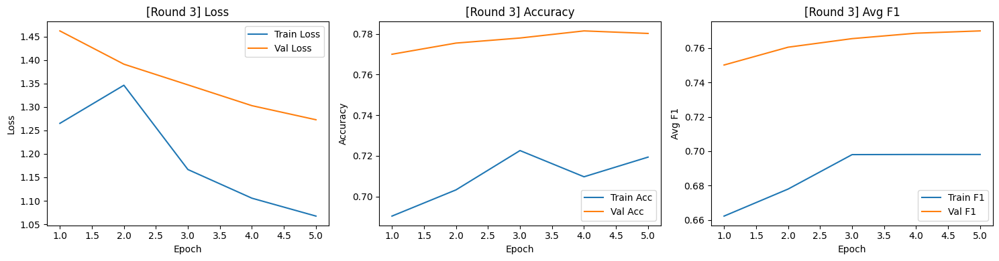


[AL Round 4/40] — Labeled samples: 315



Epoch 5/5
Train — Loss: 0.9839 | Acc: 0.7460 | Avg F1: 0.7259
Val   — Loss: 1.1612 | Acc: 0.7860 | Avg F1: 0.7804


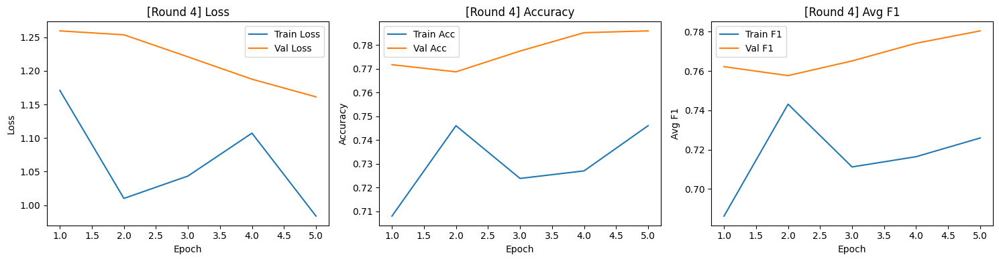


[AL Round 5/40] — Labeled samples: 320



Epoch 10/10
Train — Loss: 0.7901 | Acc: 0.8094 | Avg F1: 0.8004
Val   — Loss: 0.9154 | Acc: 0.8217 | Avg F1: 0.8246


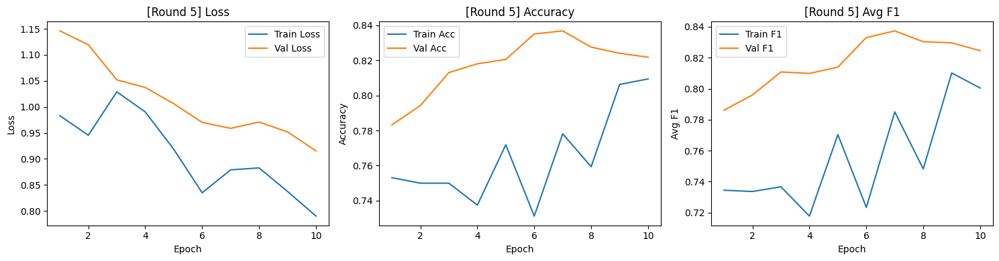


[AL Round 6/40] — Labeled samples: 325



Epoch 10/10
Train — Loss: 0.7763 | Acc: 0.7723 | Avg F1: 0.7804
Val   — Loss: 0.8503 | Acc: 0.8335 | Avg F1: 0.8296


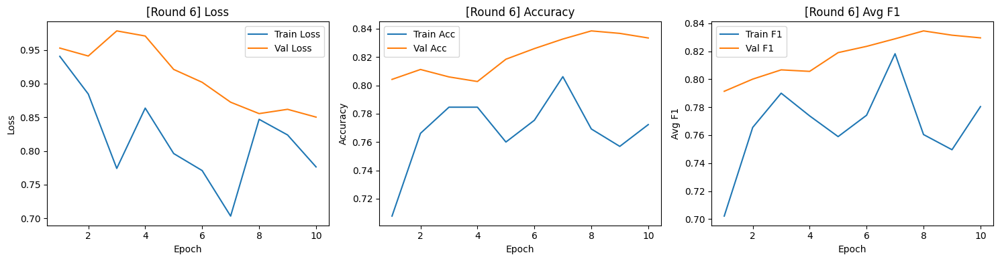


[AL Round 7/40] — Labeled samples: 330



Epoch 10/10
Train — Loss: 0.7870 | Acc: 0.8030 | Avg F1: 0.8142
Val   — Loss: 0.8020 | Acc: 0.8410 | Avg F1: 0.8437


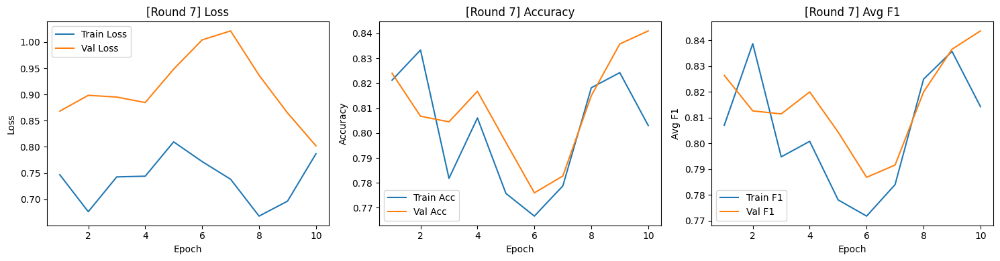


[AL Round 8/40] — Labeled samples: 335



Epoch 10/10
Train — Loss: 0.6740 | Acc: 0.8030 | Avg F1: 0.8094
Val   — Loss: 0.8350 | Acc: 0.8077 | Avg F1: 0.8194


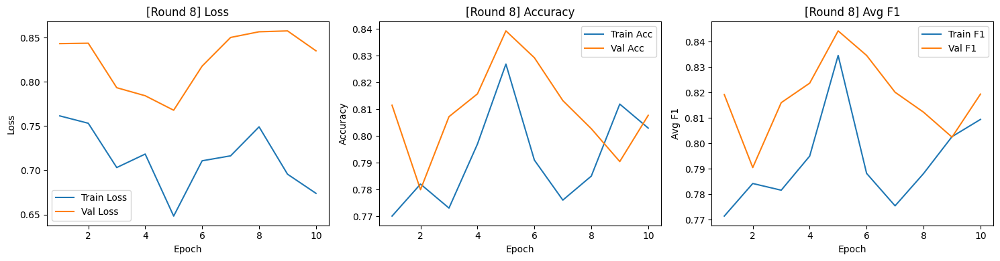


[AL Round 9/40] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.6291 | Acc: 0.8588 | Avg F1: 0.8545
Val   — Loss: 0.8304 | Acc: 0.8113 | Avg F1: 0.8215


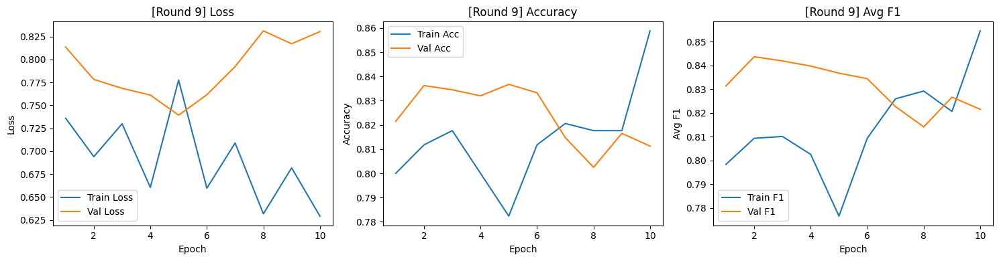


[AL Round 10/40] — Labeled samples: 345



Epoch 10/10
Train — Loss: 0.5755 | Acc: 0.8522 | Avg F1: 0.8516
Val   — Loss: 0.8694 | Acc: 0.7812 | Avg F1: 0.7957


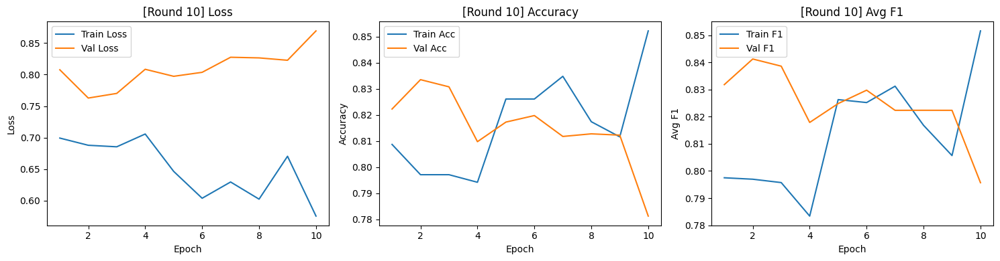


[AL Round 11/40] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.6061 | Acc: 0.8371 | Avg F1: 0.8418
Val   — Loss: 0.7978 | Acc: 0.8080 | Avg F1: 0.8167


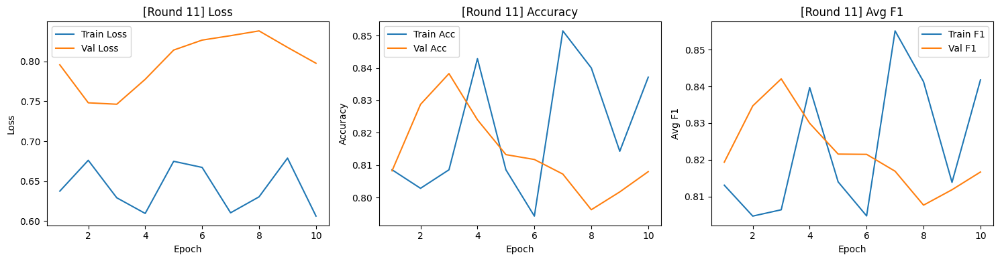


[AL Round 12/40] — Labeled samples: 355



Epoch 15/15
Train — Loss: 0.5999 | Acc: 0.8451 | Avg F1: 0.8465
Val   — Loss: 0.8731 | Acc: 0.7867 | Avg F1: 0.7993


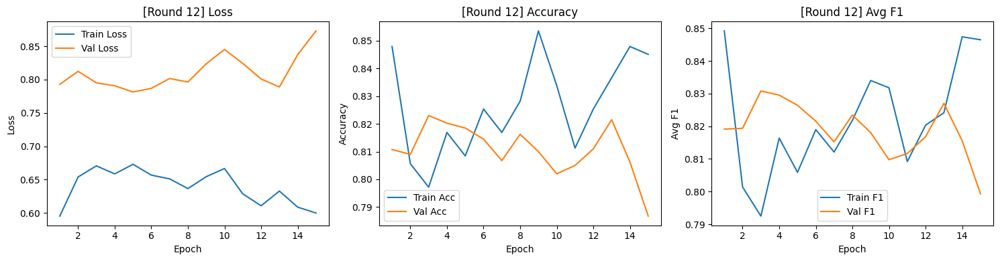


[AL Round 13/40] — Labeled samples: 360



Epoch 15/15
Train — Loss: 0.5628 | Acc: 0.8639 | Avg F1: 0.8573
Val   — Loss: 0.8147 | Acc: 0.8185 | Avg F1: 0.8243


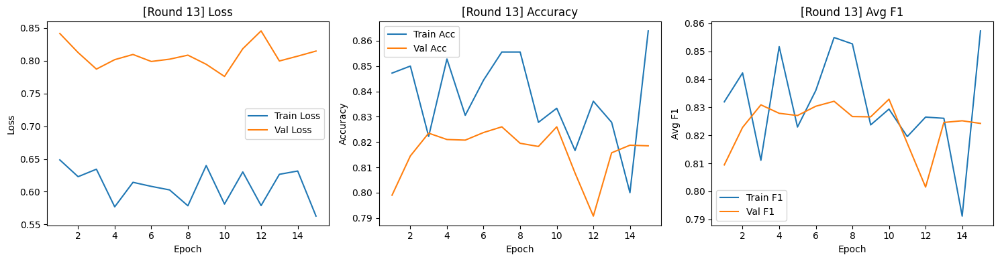


[AL Round 14/40] — Labeled samples: 365



Epoch 15/15
Train — Loss: 0.5586 | Acc: 0.8548 | Avg F1: 0.8424
Val   — Loss: 0.8118 | Acc: 0.8160 | Avg F1: 0.8247


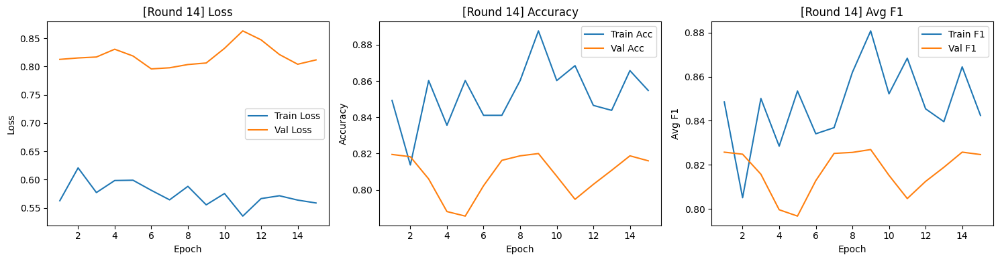


[AL Round 15/40] — Labeled samples: 370



Epoch 15/15
Train — Loss: 0.5771 | Acc: 0.8622 | Avg F1: 0.8537
Val   — Loss: 0.8197 | Acc: 0.8055 | Avg F1: 0.8151


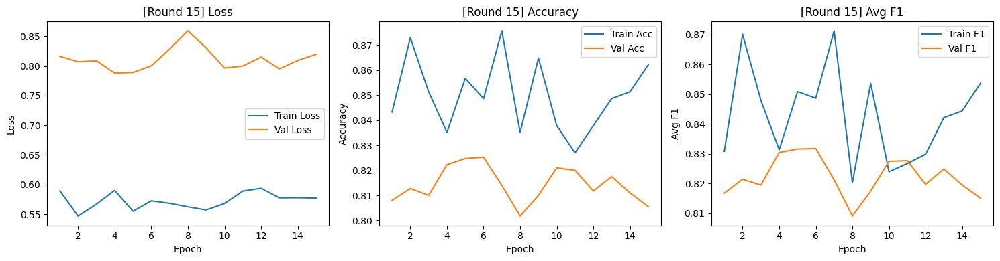


[AL Round 16/40] — Labeled samples: 375



Epoch 15/15
Train — Loss: 0.5358 | Acc: 0.8667 | Avg F1: 0.8634
Val   — Loss: 0.7866 | Acc: 0.8183 | Avg F1: 0.8239


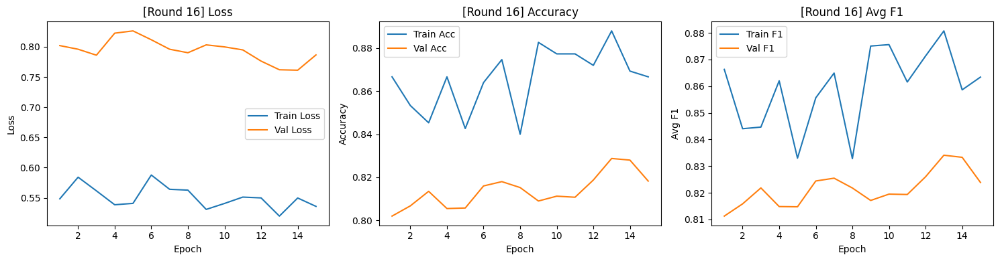


[AL Round 17/40] — Labeled samples: 380



Epoch 15/15
Train — Loss: 0.5251 | Acc: 0.8947 | Avg F1: 0.8887
Val   — Loss: 0.7929 | Acc: 0.8217 | Avg F1: 0.8274


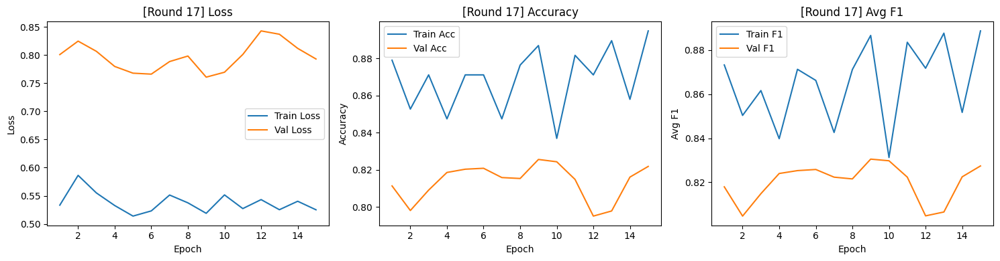


[AL Round 18/40] — Labeled samples: 385



Epoch 15/15
Train — Loss: 0.5727 | Acc: 0.8805 | Avg F1: 0.8758
Val   — Loss: 0.7610 | Acc: 0.8310 | Avg F1: 0.8350


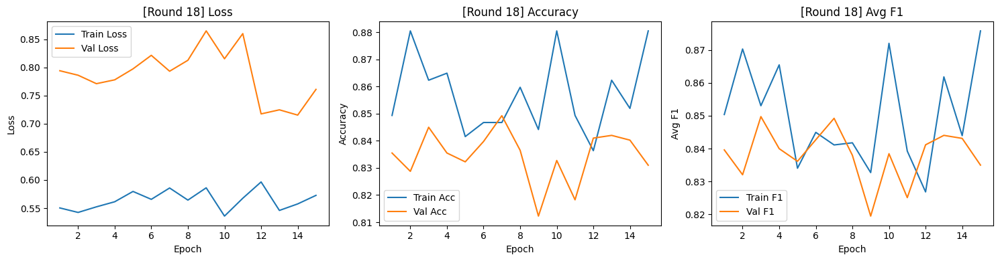


[AL Round 19/40] — Labeled samples: 390



Epoch 15/15
Train — Loss: 0.5337 | Acc: 0.8667 | Avg F1: 0.8534
Val   — Loss: 0.7172 | Acc: 0.8317 | Avg F1: 0.8337


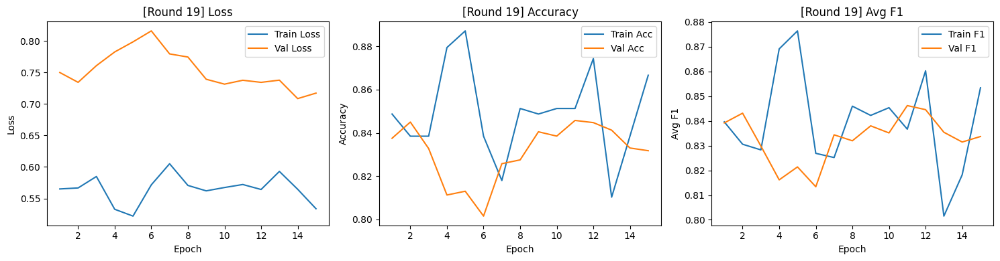


[AL Round 20/40] — Labeled samples: 395



Epoch 15/15
Train — Loss: 0.5377 | Acc: 0.8658 | Avg F1: 0.8636
Val   — Loss: 0.7273 | Acc: 0.8468 | Avg F1: 0.8500


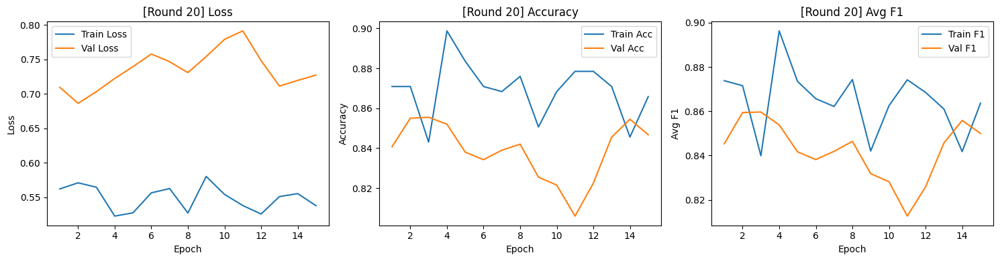


[AL Round 21/40] — Labeled samples: 400



Epoch 15/15
Train — Loss: 0.5475 | Acc: 0.8475 | Avg F1: 0.8510
Val   — Loss: 0.7053 | Acc: 0.8510 | Avg F1: 0.8505


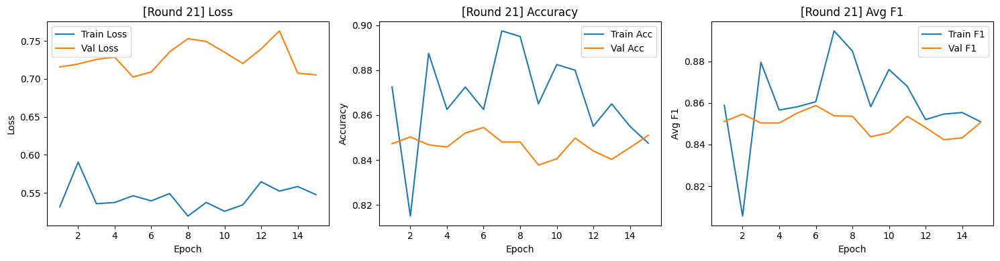


[AL Round 22/40] — Labeled samples: 405



Epoch 15/15
Train — Loss: 0.4890 | Acc: 0.8840 | Avg F1: 0.8707
Val   — Loss: 0.7046 | Acc: 0.8433 | Avg F1: 0.8481


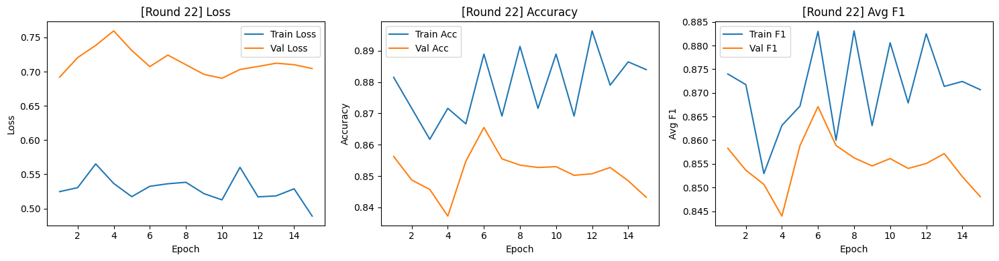


[AL Round 23/40] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.5403 | Acc: 0.8610 | Avg F1: 0.8551
Val   — Loss: 0.7547 | Acc: 0.8417 | Avg F1: 0.8485


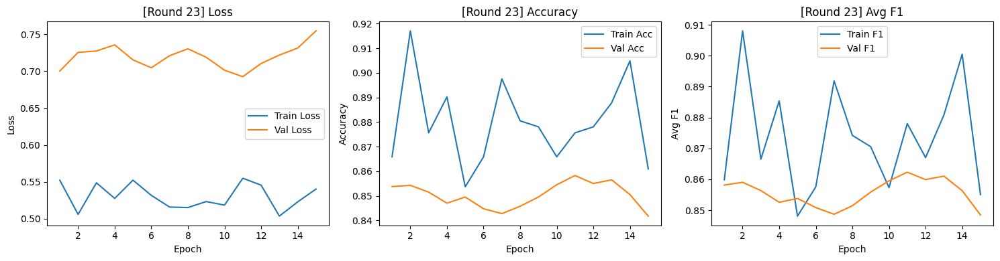


[AL Round 24/40] — Labeled samples: 415



Epoch 15/15
Train — Loss: 0.5162 | Acc: 0.8964 | Avg F1: 0.8881
Val   — Loss: 0.7530 | Acc: 0.8502 | Avg F1: 0.8568


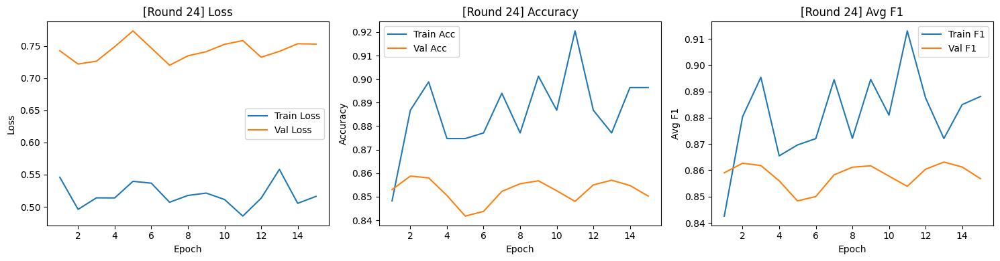


[AL Round 25/40] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5019 | Acc: 0.8976 | Avg F1: 0.8880
Val   — Loss: 0.7265 | Acc: 0.8560 | Avg F1: 0.8616


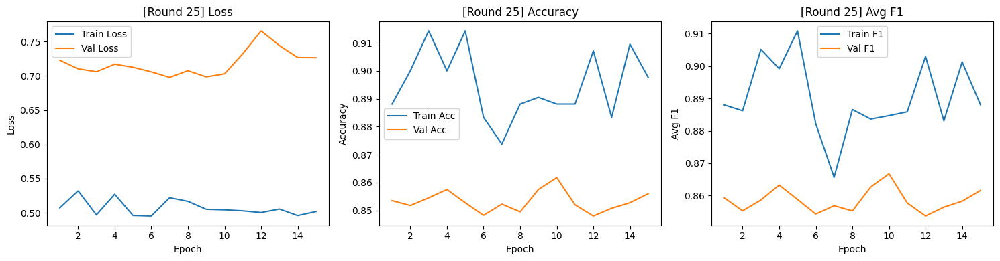


[AL Round 26/40] — Labeled samples: 425



Epoch 15/15
Train — Loss: 0.5004 | Acc: 0.9176 | Avg F1: 0.9081
Val   — Loss: 0.7279 | Acc: 0.8525 | Avg F1: 0.8580


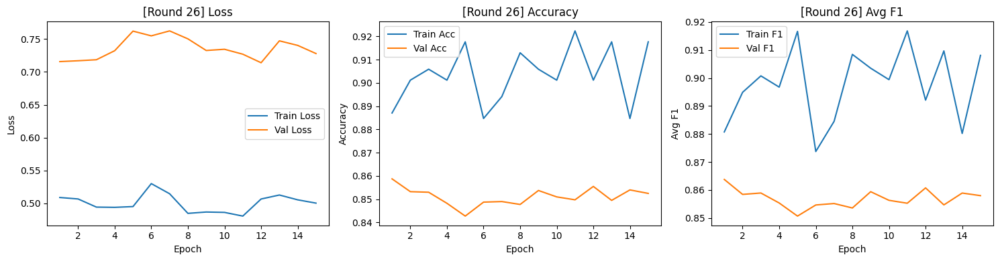


[AL Round 27/40] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.5249 | Acc: 0.8953 | Avg F1: 0.8890
Val   — Loss: 0.7416 | Acc: 0.8572 | Avg F1: 0.8616


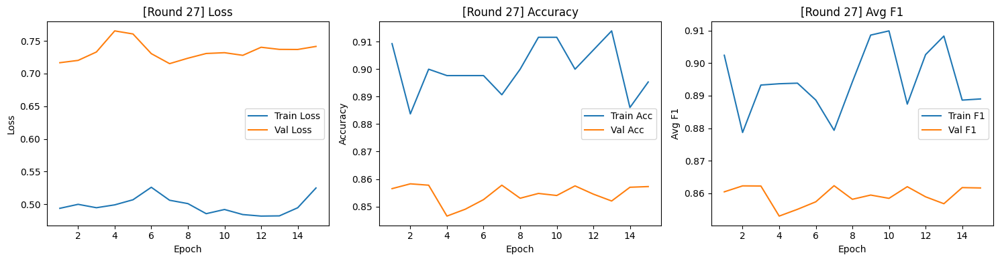


[AL Round 28/40] — Labeled samples: 435



Epoch 15/15
Train — Loss: 0.4748 | Acc: 0.9126 | Avg F1: 0.9085
Val   — Loss: 0.7704 | Acc: 0.8550 | Avg F1: 0.8602


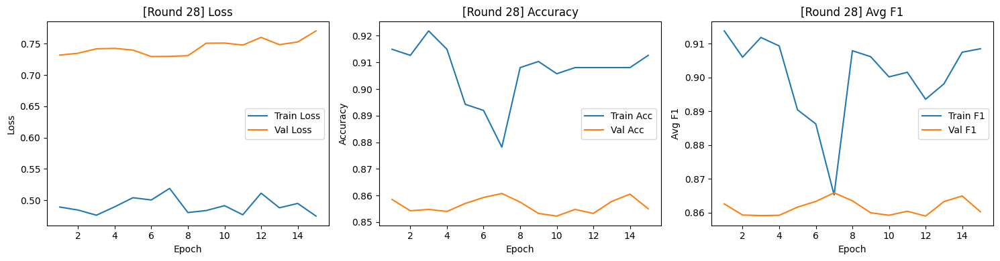


[AL Round 29/40] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.4811 | Acc: 0.8955 | Avg F1: 0.8870
Val   — Loss: 0.7798 | Acc: 0.8478 | Avg F1: 0.8548


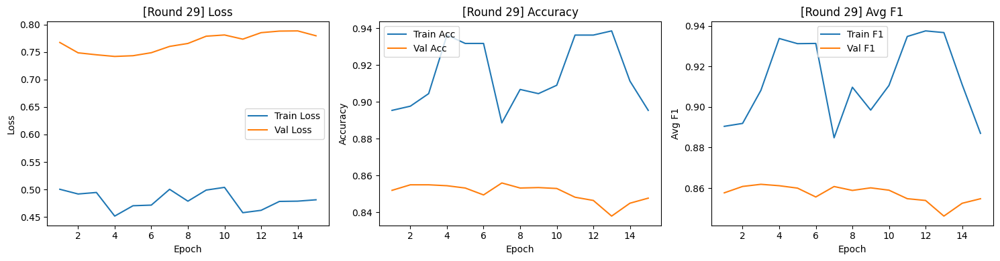


[AL Round 30/40] — Labeled samples: 445



Epoch 15/15
Train — Loss: 0.5047 | Acc: 0.9101 | Avg F1: 0.9106
Val   — Loss: 0.7976 | Acc: 0.8455 | Avg F1: 0.8524


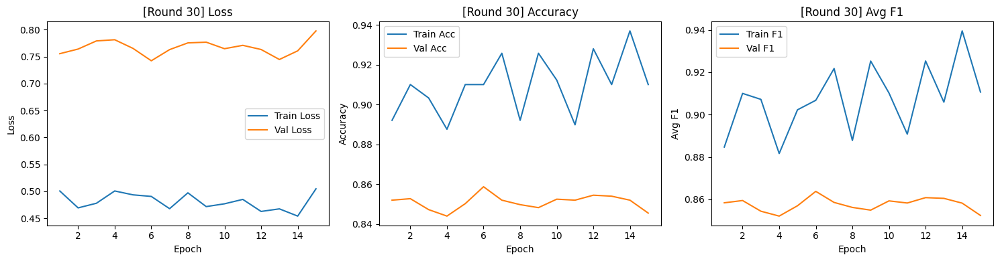


[AL Round 31/40] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.5594 | Acc: 0.8356 | Avg F1: 0.8329
Val   — Loss: 0.7397 | Acc: 0.8558 | Avg F1: 0.8522


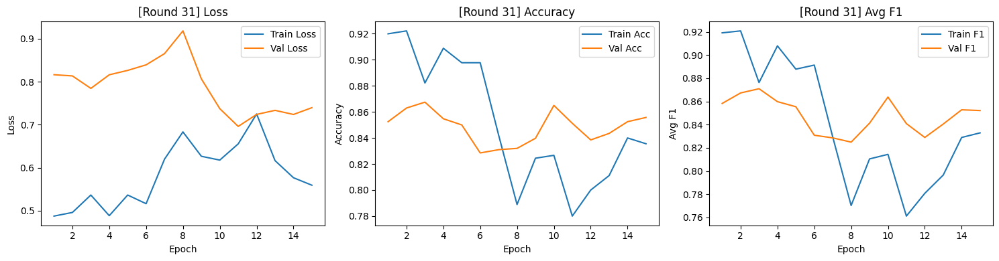


[AL Round 32/40] — Labeled samples: 455



Epoch 15/15
Train — Loss: 0.4997 | Acc: 0.8967 | Avg F1: 0.8922
Val   — Loss: 0.7874 | Acc: 0.8345 | Avg F1: 0.8416


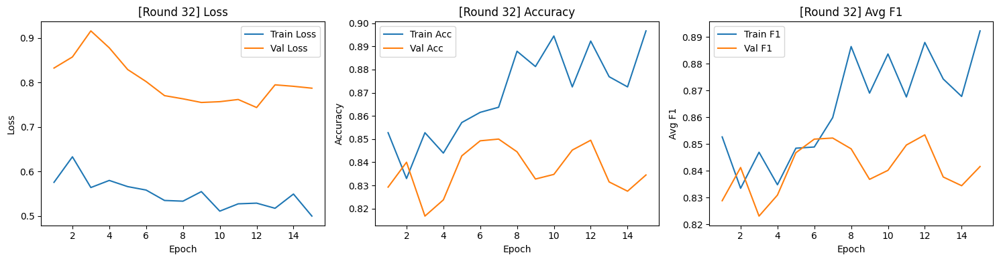


[AL Round 33/40] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.4895 | Acc: 0.8913 | Avg F1: 0.8865
Val   — Loss: 0.7468 | Acc: 0.8600 | Avg F1: 0.8633


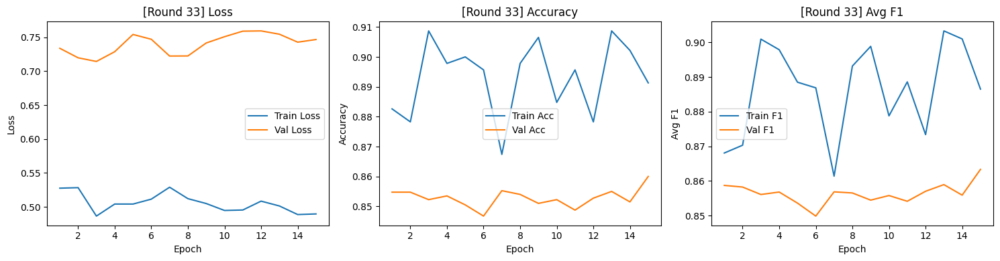


[AL Round 34/40] — Labeled samples: 465



Epoch 15/15
Train — Loss: 0.4796 | Acc: 0.9161 | Avg F1: 0.9077
Val   — Loss: 0.7694 | Acc: 0.8482 | Avg F1: 0.8536


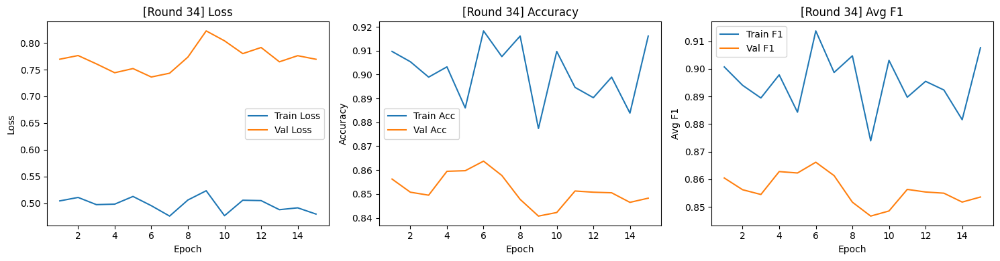


[AL Round 35/40] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.4852 | Acc: 0.9106 | Avg F1: 0.9104
Val   — Loss: 0.7801 | Acc: 0.8350 | Avg F1: 0.8433


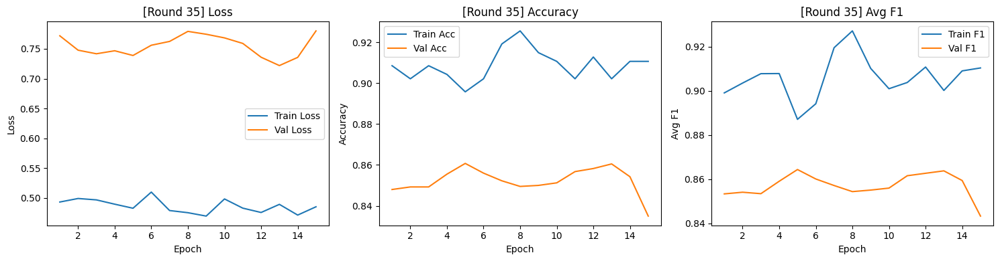


[AL Round 36/40] — Labeled samples: 475



Epoch 15/15
Train — Loss: 0.4689 | Acc: 0.9284 | Avg F1: 0.9250
Val   — Loss: 0.7549 | Acc: 0.8525 | Avg F1: 0.8574


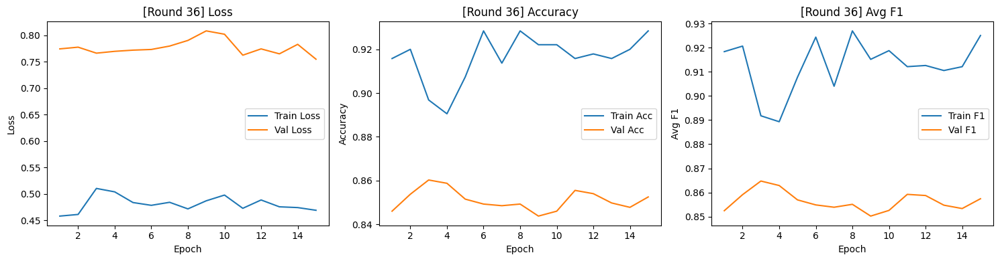


[AL Round 37/40] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.4662 | Acc: 0.9062 | Avg F1: 0.9031
Val   — Loss: 0.7817 | Acc: 0.8570 | Avg F1: 0.8621


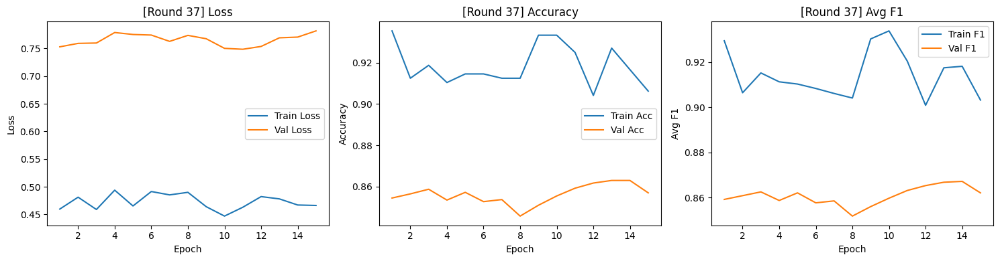


[AL Round 38/40] — Labeled samples: 485



Epoch 15/15
Train — Loss: 0.4440 | Acc: 0.9237 | Avg F1: 0.9166
Val   — Loss: 0.7957 | Acc: 0.8552 | Avg F1: 0.8591


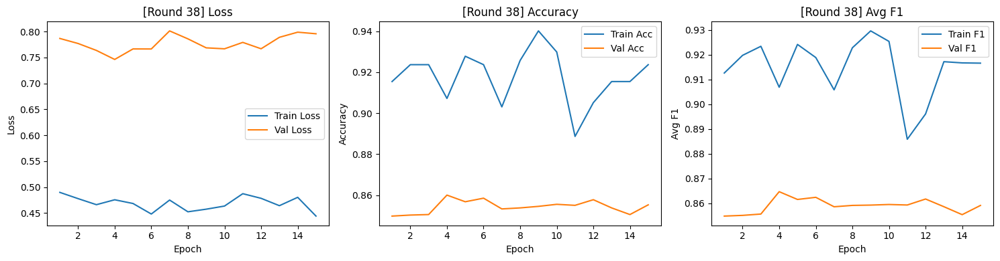


[AL Round 39/40] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.4649 | Acc: 0.9184 | Avg F1: 0.9192
Val   — Loss: 0.7825 | Acc: 0.8535 | Avg F1: 0.8590


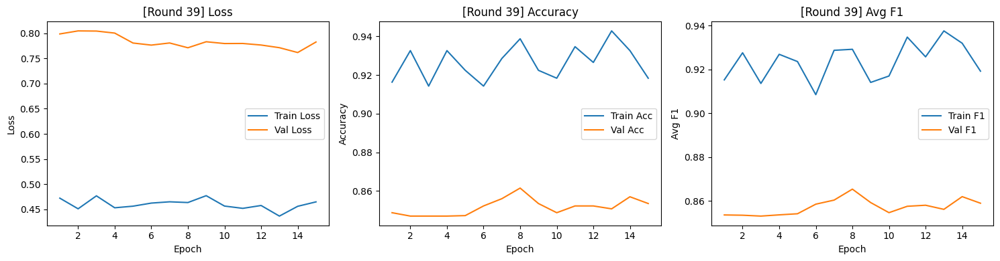


[AL Round 40/40] — Labeled samples: 495



Epoch 15/15
Train — Loss: 0.4566 | Acc: 0.9232 | Avg F1: 0.9139
Val   — Loss: 0.7624 | Acc: 0.8488 | Avg F1: 0.8548


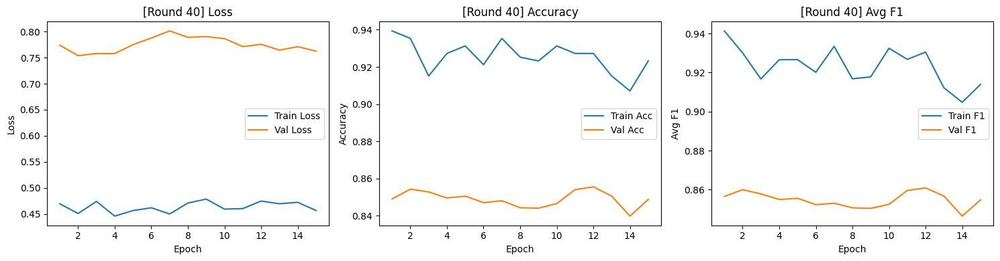

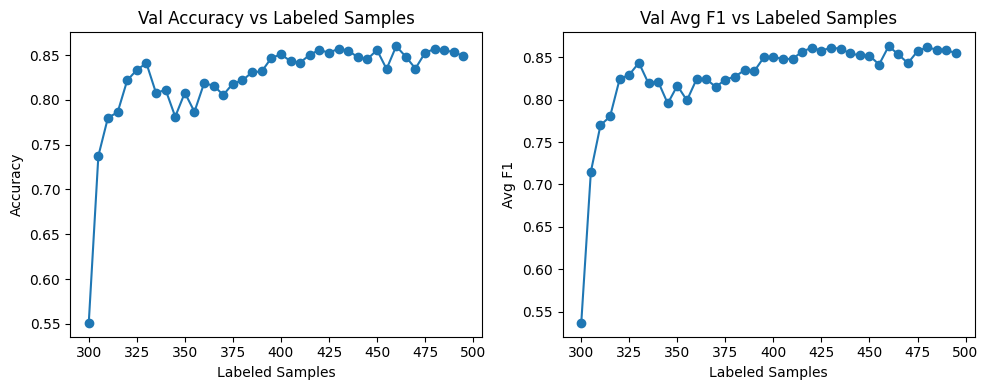

X_labeled shape: (500, 6, 28)
y_labeled shape: (500,)
X_unlabeled shape: (15500, 6, 28)
y_unlabeled shape: (15500,)

=== Running strategy: DIVERSITY ===

[AL Round 1/40] — Labeled samples: 500



Epoch 5/5
Train — Loss: 1.6421 | Acc: 0.6020 | Avg F1: 0.5861
Val   — Loss: 1.6368 | Acc: 0.7145 | Avg F1: 0.6923


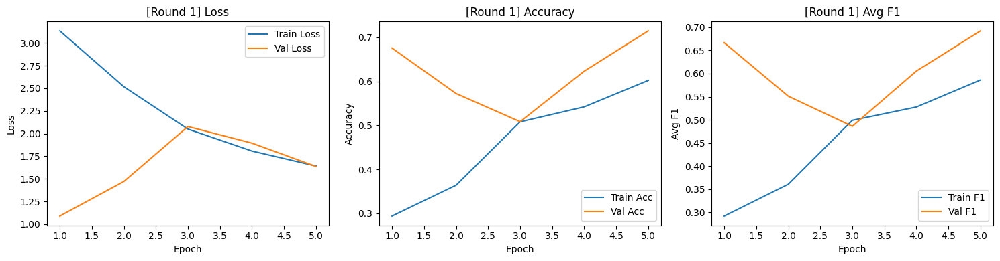


[AL Round 2/40] — Labeled samples: 505



Epoch 5/5
Train — Loss: 1.2377 | Acc: 0.6950 | Avg F1: 0.6743
Val   — Loss: 1.3804 | Acc: 0.7460 | Avg F1: 0.7222


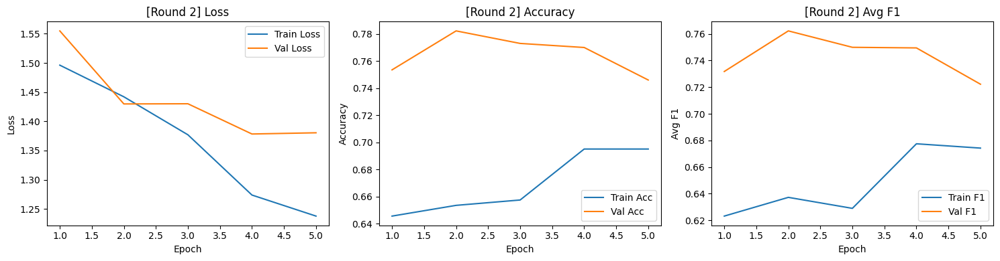


[AL Round 3/40] — Labeled samples: 510



Epoch 5/5
Train — Loss: 1.0046 | Acc: 0.7451 | Avg F1: 0.7276
Val   — Loss: 1.0417 | Acc: 0.8303 | Avg F1: 0.8309


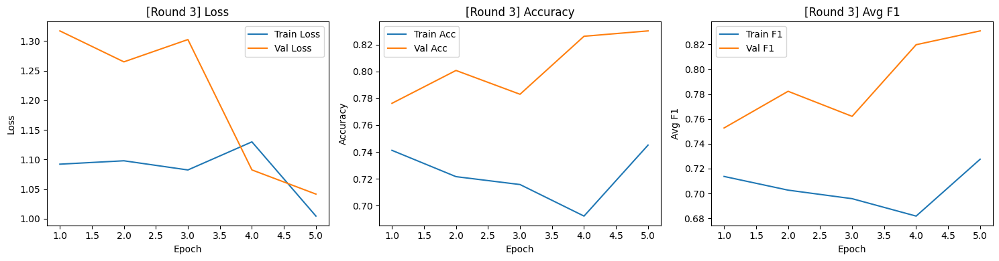


[AL Round 4/40] — Labeled samples: 515



Epoch 5/5
Train — Loss: 0.8461 | Acc: 0.7631 | Avg F1: 0.7583
Val   — Loss: 0.8933 | Acc: 0.8390 | Avg F1: 0.8334


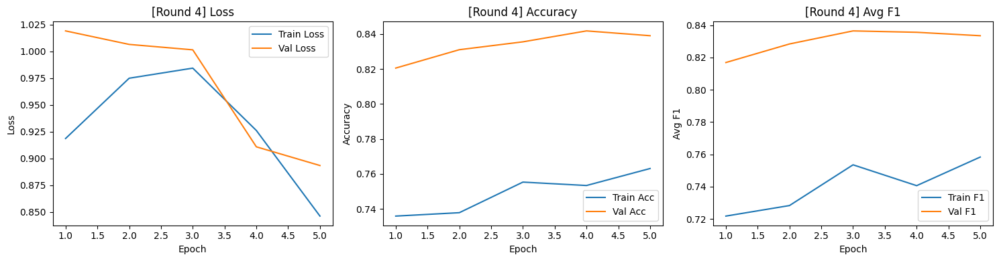


[AL Round 5/40] — Labeled samples: 520



Epoch 10/10
Train — Loss: 0.7266 | Acc: 0.7904 | Avg F1: 0.7869
Val   — Loss: 0.9330 | Acc: 0.7782 | Avg F1: 0.7913


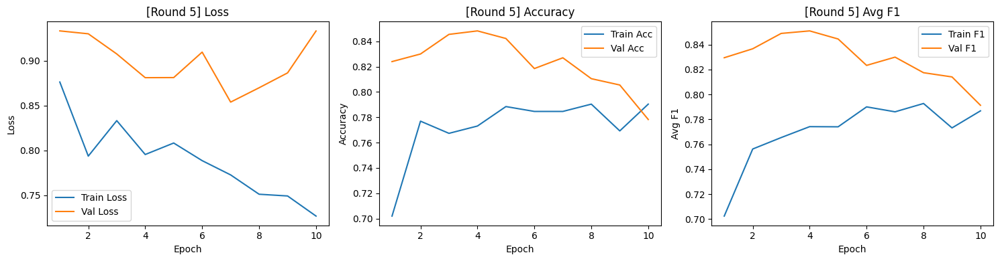


[AL Round 6/40] — Labeled samples: 525



Epoch 10/10
Train — Loss: 0.6669 | Acc: 0.7962 | Avg F1: 0.7962
Val   — Loss: 0.8141 | Acc: 0.7983 | Avg F1: 0.8102


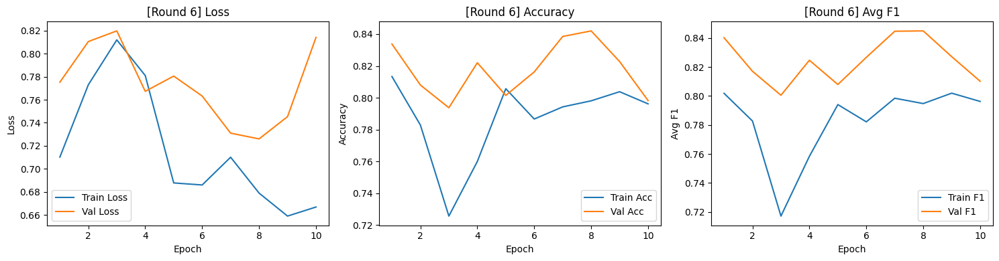


[AL Round 7/40] — Labeled samples: 530



Epoch 10/10
Train — Loss: 0.6340 | Acc: 0.8170 | Avg F1: 0.8174
Val   — Loss: 0.6955 | Acc: 0.8325 | Avg F1: 0.8361


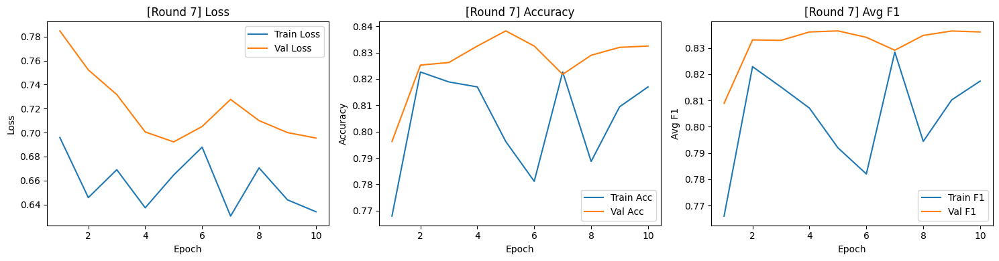


[AL Round 8/40] — Labeled samples: 535



Epoch 10/10
Train — Loss: 0.5833 | Acc: 0.8505 | Avg F1: 0.8562
Val   — Loss: 0.7025 | Acc: 0.8330 | Avg F1: 0.8409


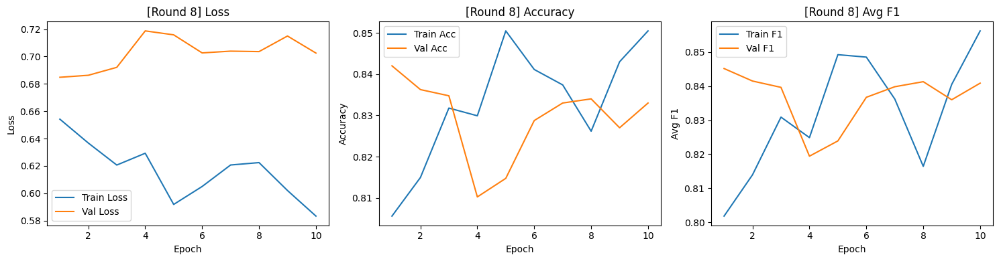


[AL Round 9/40] — Labeled samples: 540



Epoch 10/10
Train — Loss: 0.5687 | Acc: 0.8648 | Avg F1: 0.8586
Val   — Loss: 0.6768 | Acc: 0.8355 | Avg F1: 0.8421


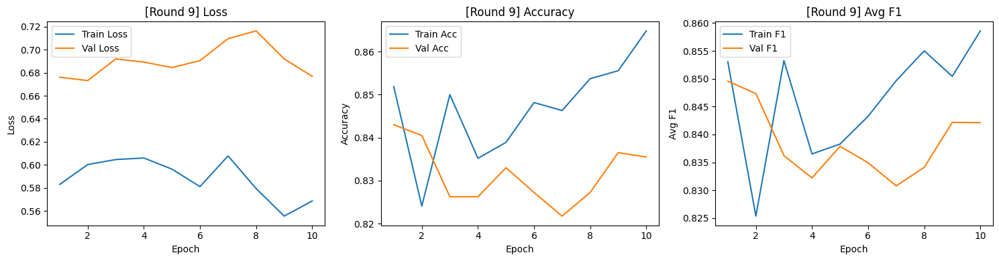


[AL Round 10/40] — Labeled samples: 545



Epoch 10/10
Train — Loss: 0.5982 | Acc: 0.8257 | Avg F1: 0.8180
Val   — Loss: 0.6668 | Acc: 0.8273 | Avg F1: 0.8290


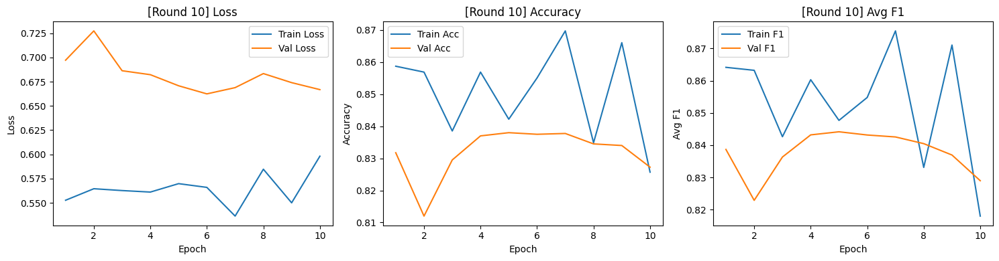


[AL Round 11/40] — Labeled samples: 550



Epoch 10/10
Train — Loss: 0.5192 | Acc: 0.8818 | Avg F1: 0.8841
Val   — Loss: 0.6725 | Acc: 0.8303 | Avg F1: 0.8367


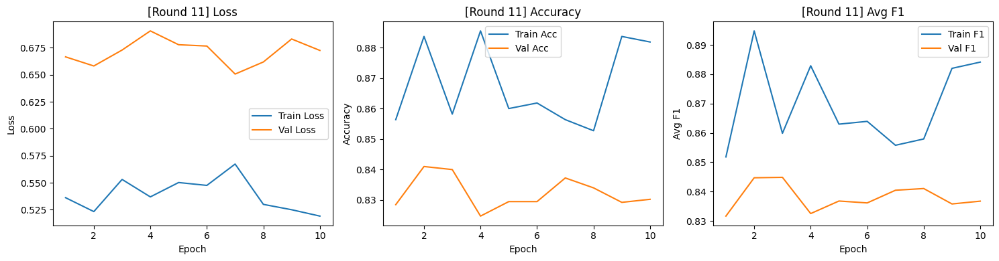


[AL Round 12/40] — Labeled samples: 555



Epoch 15/15
Train — Loss: 0.5089 | Acc: 0.8739 | Avg F1: 0.8801
Val   — Loss: 0.6865 | Acc: 0.8185 | Avg F1: 0.8215


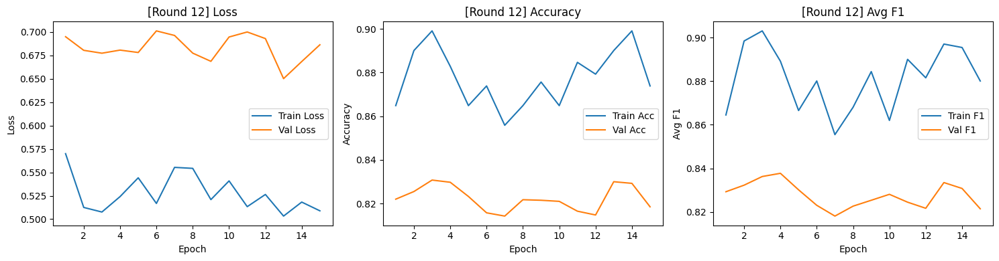


[AL Round 13/40] — Labeled samples: 560



Epoch 15/15
Train — Loss: 0.4975 | Acc: 0.8929 | Avg F1: 0.8976
Val   — Loss: 0.6691 | Acc: 0.8307 | Avg F1: 0.8358


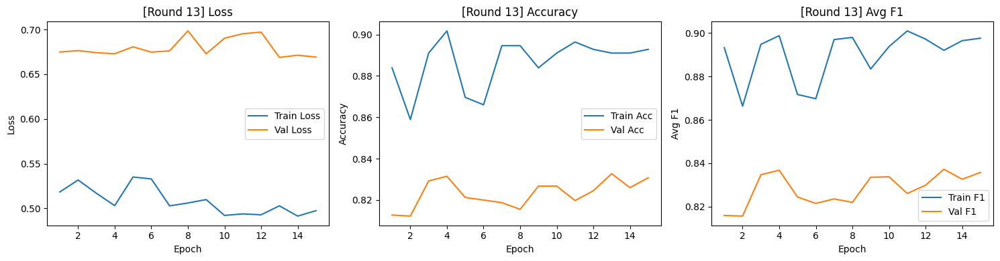


[AL Round 14/40] — Labeled samples: 565



Epoch 15/15
Train — Loss: 0.4776 | Acc: 0.9027 | Avg F1: 0.9083
Val   — Loss: 0.6744 | Acc: 0.8277 | Avg F1: 0.8302


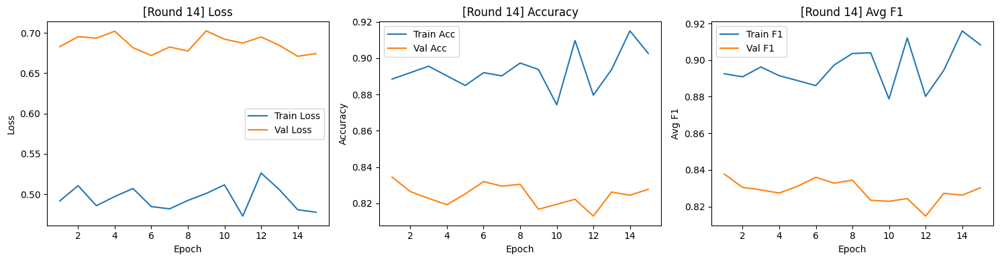


[AL Round 15/40] — Labeled samples: 570



Epoch 15/15
Train — Loss: 0.4760 | Acc: 0.8947 | Avg F1: 0.8991
Val   — Loss: 0.6836 | Acc: 0.8347 | Avg F1: 0.8352


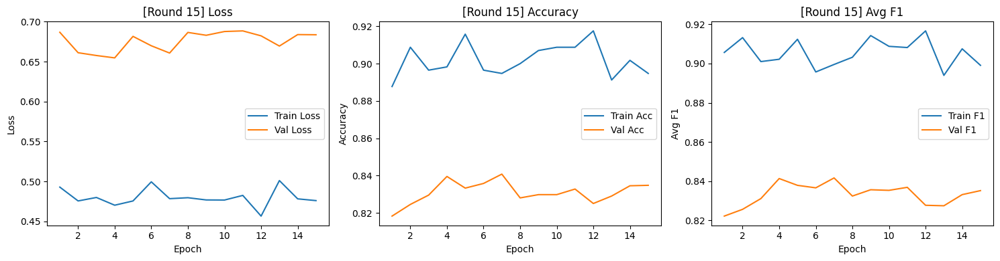


[AL Round 16/40] — Labeled samples: 575



Epoch 15/15
Train — Loss: 0.4763 | Acc: 0.9026 | Avg F1: 0.9096
Val   — Loss: 0.6682 | Acc: 0.8180 | Avg F1: 0.8198


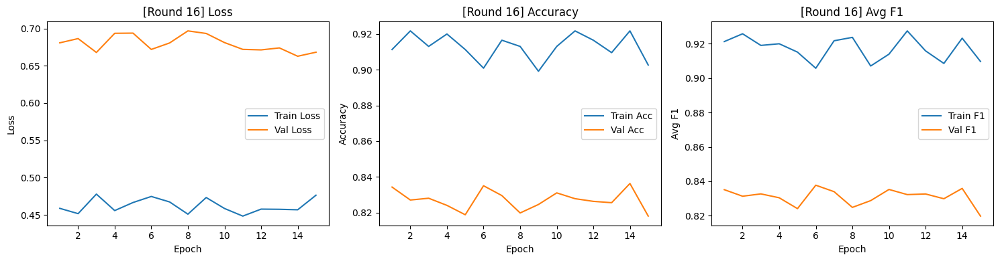


[AL Round 17/40] — Labeled samples: 580



Epoch 15/15
Train — Loss: 0.4799 | Acc: 0.8879 | Avg F1: 0.8876
Val   — Loss: 0.7030 | Acc: 0.7963 | Avg F1: 0.7974


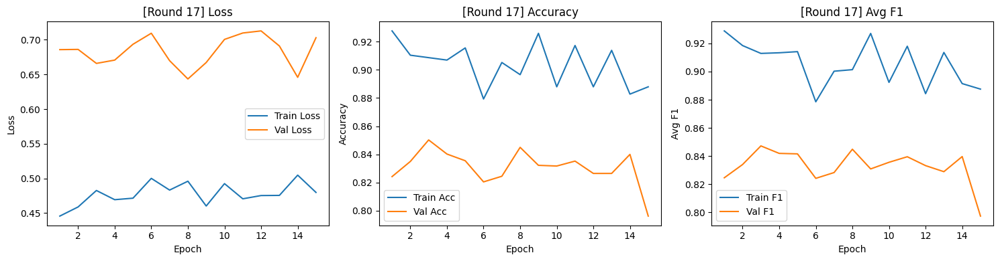


[AL Round 18/40] — Labeled samples: 585



Epoch 15/15
Train — Loss: 0.4558 | Acc: 0.9128 | Avg F1: 0.9136
Val   — Loss: 0.6805 | Acc: 0.8345 | Avg F1: 0.8386


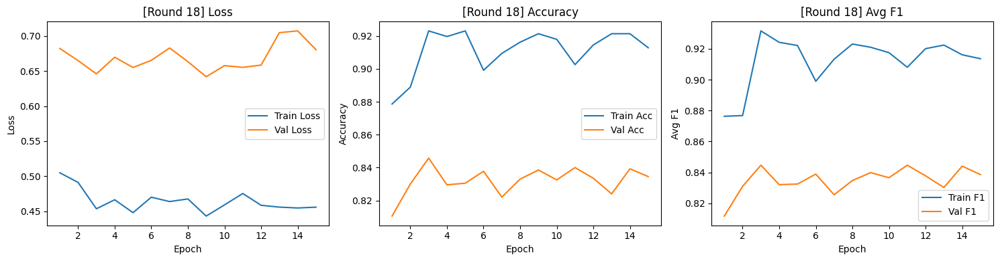


[AL Round 19/40] — Labeled samples: 590



Epoch 15/15
Train — Loss: 0.4259 | Acc: 0.9390 | Avg F1: 0.9377
Val   — Loss: 0.6836 | Acc: 0.8253 | Avg F1: 0.8298


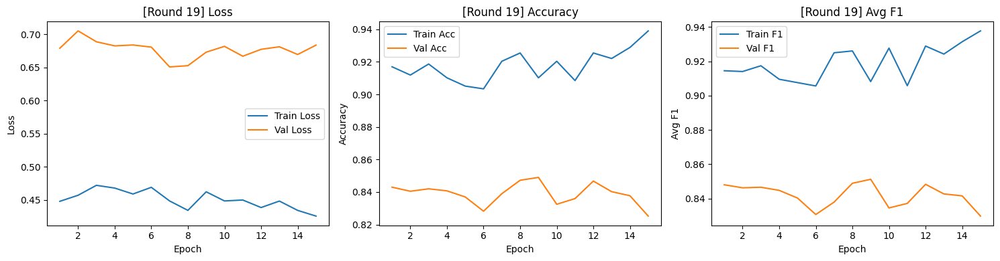


[AL Round 20/40] — Labeled samples: 595



Epoch 15/15
Train — Loss: 0.4414 | Acc: 0.9294 | Avg F1: 0.9302
Val   — Loss: 0.7068 | Acc: 0.8423 | Avg F1: 0.8441


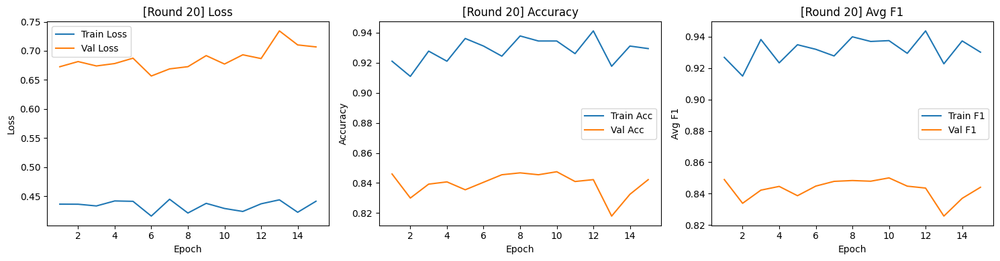


[AL Round 21/40] — Labeled samples: 600


Epoch: 100%|██████████| 15/15 [00:05<00:00,  2.91it/s]

In [ ]:

strategies = [ 'diversity', "entropy", "entropy_diversity"]
all_histories = {}

data = [(100,40,5),(300,40,5),(500,40,5)]

for initial_labeled, iters,query_size in data:
    initial_labeled= 1-initial_labeled/len(X_pool)
    X_labeled, X_unlabeled, y_labeled, y_unlabeled = train_test_split(X_pool, y_pool, test_size=initial_labeled, stratify=y_pool, random_state=42)
    print(f"X_labeled shape: {X_labeled.shape}")
    print(f"y_labeled shape: {y_labeled.shape}")
    print(f"X_unlabeled shape: {X_unlabeled.shape}")
    print(f"y_unlabeled shape: {y_unlabeled.shape}")
    
    
    labeled_dataset = Dataset(X_labeled, y_labeled)
    unlabeled_dataset = Dataset(X_unlabeled, y_unlabeled)
    val_dataset = Dataset(X_val, y_val)
    
    for strat in strategies:
        print(f"\n=== Running strategy: {strat.upper()} ===")
        
        # Reset datasets to initial versions (deepcopy to avoid mutations)
        labeled = copy.deepcopy(labeled_dataset)
        unlabeled = copy.deepcopy(unlabeled_dataset)
    
        model.load_state_dict(copy.deepcopy(initial_state_dict))
        
        hist = active_learning_loop(
            model,
            labeled_dataset=labeled,
            unlabeled_dataset=unlabeled,
            val_dataset=val_dataset,
            strategy=strat,
            device=device,
            iters=iters,
            query_size=query_size,
            final_epochs=15
        )
        
        all_histories[(strat, initial_labeled, iters, query_size)] = hist


with open("/kaggle/working/history_entropy.pkl", "wb") as f:
    pickle.dump(all_histories, f)

# Plotting final result

In [ ]:
example = [ (100,20,10), (100,10,20),(100,40,5),(300,20,10),(300,10,20),(300,40,5), (500,20,10),(500,40,5), (500,10,20) ]

for init,iterations,query in example:
    print(f'Init: {init}, Iters: {iterations}, Query: {query}, Total: {total_labeled_samples(init, iterations, query)}, Effective: {eff_total_labeled_samples(init, iterations, query)}')

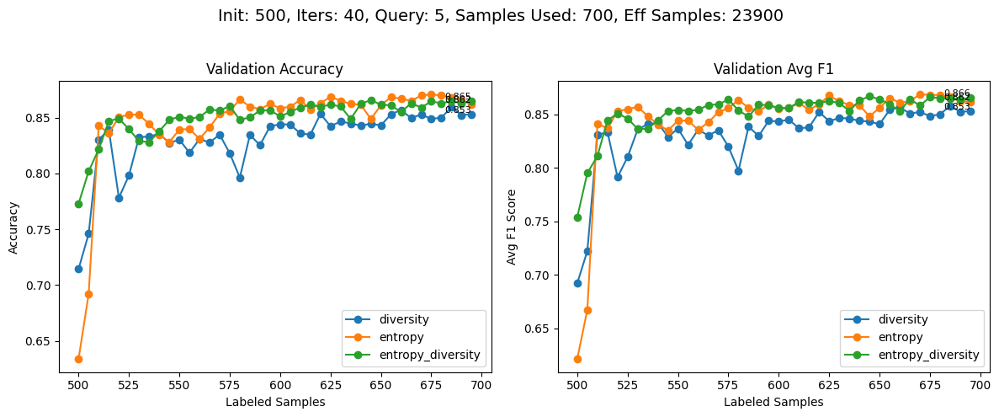

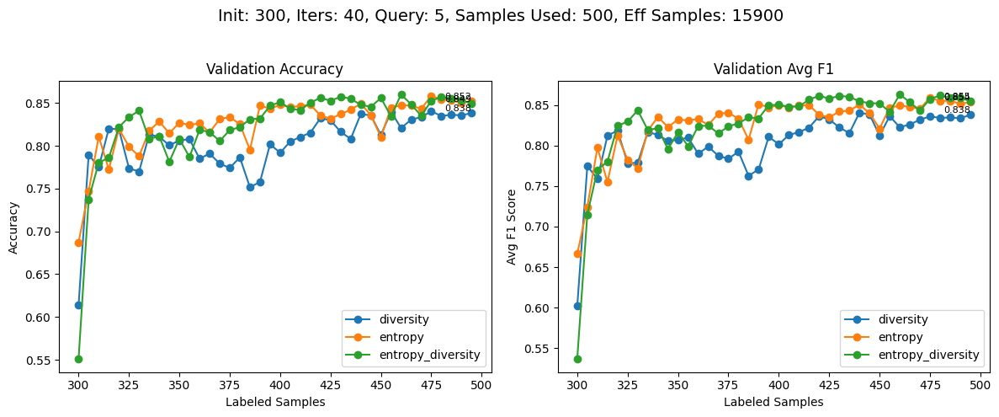

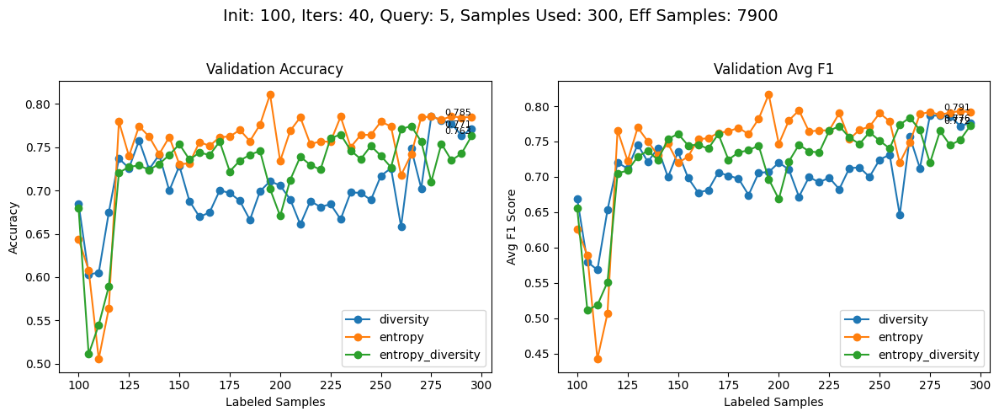

In [15]:
def eff_total_labeled_samples(init, iterations, query):
    return round(iterations * init + query * (iterations * (iterations - 1)) // 2)

def total_labeled_samples(init, iterations, query):
    return init+query*iterations

unique_configs = sorted(set((init_size, iters, query) for (_, init_size, iters, query) in all_histories.keys()))

for init_size, iters, query in unique_configs:
    plt.figure(figsize=(12, 5))
    plt.suptitle(f"Init: {round(len(X_pool)*(1-init_size))}, Iters: {iters}, Query: {query}, Samples Used: {total_labeled_samples(round(len(X_pool)*(1-init_size)), iters, query)}, Eff Samples: {eff_total_labeled_samples(round(len(X_pool)*(1-init_size)), iters, query)}", fontsize=14)
    # Accuracy
    plt.subplot(1, 2, 1)
    for (strat, size, iters_, query_), hist in all_histories.items():
        if (size, iters_, query_) == (init_size, iters, query):
            plt.plot(hist["samples"], hist["round_val_acc"], label=strat, marker='o')
            # Show final accuracy value
            x_final = hist["samples"][-1]
            y_final = hist["round_val_acc"][-1]
            plt.text(x_final, y_final, f"{y_final:.3f}", fontsize=8, ha='right', va='bottom')
    plt.title("Validation Accuracy")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Accuracy")
    plt.legend()

    # F1 Score
    plt.subplot(1, 2, 2)
    for (strat, size, iters_, query_), hist in all_histories.items():
        if (size, iters_, query_) == (init_size, iters, query):
            plt.plot(hist["samples"], hist["round_val_avg_f1"], label=strat, marker='o')
            # Show final F1 value
            x_final = hist["samples"][-1]
            y_final = hist["round_val_avg_f1"][-1]
            plt.text(x_final, y_final, f"{y_final:.3f}", fontsize=8, ha='right', va='bottom')
    plt.title("Validation Avg F1")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Avg F1 Score")
    plt.legend()

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
